In [1]:
from joblib import Parallel, delayed
from joblib.externals.loky import get_reusable_executor

import contextlib
import joblib
from tqdm import tqdm

n_cores = 35

@contextlib.contextmanager
def tqdm_joblib(tqdm_object):
    """Context manager to patch joblib to report into tqdm progress bar given as argument"""
    class TqdmBatchCompletionCallback(joblib.parallel.BatchCompletionCallBack):
        def __call__(self, *args, **kwargs):
            tqdm_object.update(n=self.batch_size)
            return super().__call__(*args, **kwargs)

    old_batch_callback = joblib.parallel.BatchCompletionCallBack
    joblib.parallel.BatchCompletionCallBack = TqdmBatchCompletionCallback
    try:
        yield tqdm_object
    finally:
        joblib.parallel.BatchCompletionCallBack = old_batch_callback
        tqdm_object.close()

In [2]:
%%time

#import napari
#from magicgui import magicgui, widgets
import time

from IPython import get_ipython
from IPython.display import clear_output
import os
import matplotlib.pyplot as plt
import numpy as np
from scipy.sparse import csc_matrix
from scipy import signal as sg
from scipy.ndimage import center_of_mass
import scipy
import pickle

from tifffile.tifffile import imwrite,imread
from tqdm.auto import tqdm,trange

from copy import deepcopy
import h5py

import caiman as cm
from caiman.source_extraction.cnmf import cnmf,params
from caiman.paths import caiman_datadir
from caiman.utils.visualization import get_contours

try:
    if __IPYTHON__:
        get_ipython().run_line_magic('load_ext', 'autoreload')
        get_ipython().run_line_magic('autoreload', '2')
except NameError:
    pass

def load_pickle(file_path):
    """
    Load a dictionary from a pickle file.

    Args:
    - file_path (str): Path to the pickle file.

    Returns:
    - dict: Loaded dictionary.
    """
    with open(file_path, 'rb') as f:
        data = pickle.load(f)
    return data

CPU times: total: 9.55 s
Wall time: 46.4 s


In [226]:
# supp video 2
fname = r'\\nasquatch\data\2p\peter\grin_videos\more_123124\CS2_nooverlay.tif'
mov = imread(fname)
mov.shape

(570, 449, 1575)

In [12]:
mov.reshape(mov.shape[0],-1).shape

(570, 707175)

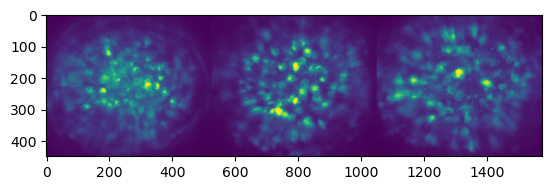

In [11]:
plt.imshow(mov[0,...])

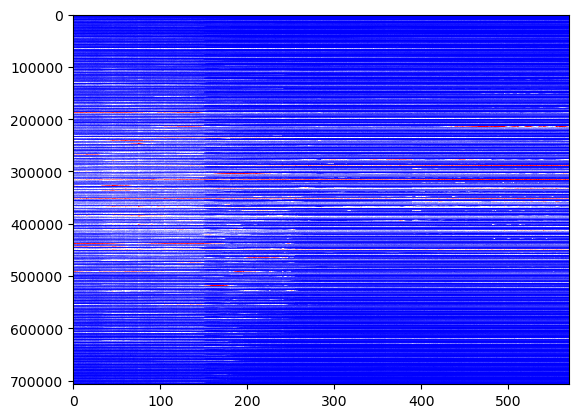

In [134]:
plt.imshow((mov.reshape(mov.shape[0],-1)).T, interpolation='nearest', aspect='auto',cmap='bwr')

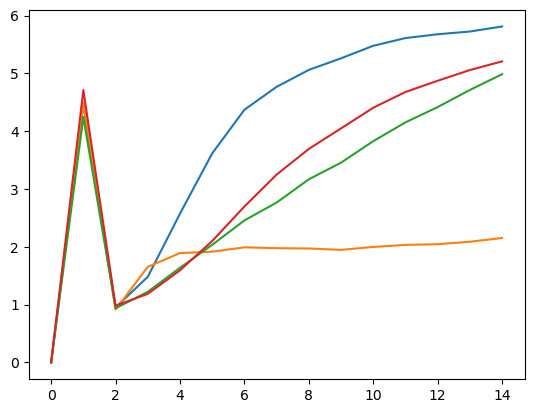

In [70]:
jump = 15
#for k in range(jump-2,jump*2,jump):
fit_range = np.array([0,1,2,3])
dcut = 20
for k in list(jump-2+fit_range*jump):
    plt.plot(np.mean(((mov.reshape(mov.shape[0],-1))[k:k+jump]-(mov.reshape(mov.shape[0],-1))[k])[:,np.where(((mov.reshape(mov.shape[0],-1))[k+2]-np.mean((mov.reshape(mov.shape[0],-1))[k-2:k],0))>dcut)[0]]/((mov.reshape(mov.shape[0],-1))[k+2]-np.mean((mov.reshape(mov.shape[0],-1))[k-2:k],0))[np.where(((mov.reshape(mov.shape[0],-1))[k+2]-np.mean((mov.reshape(mov.shape[0],-1))[k-2:k],0))>dcut)[0]],1))

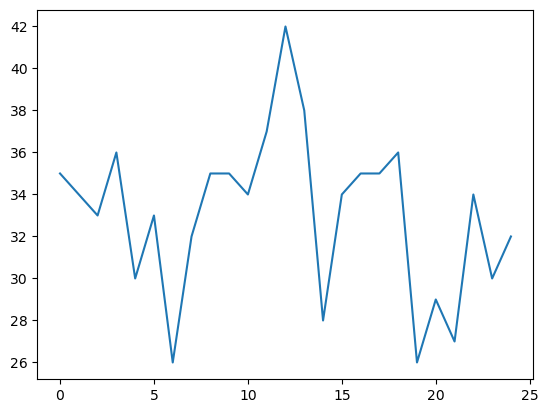

In [105]:
k=13
plt.plot((mov.reshape(mov.shape[0],-1))[k-10:k+jump,12260])

In [32]:
((mov.reshape(mov.shape[0],-1))[k:k+jump]-(mov.reshape(mov.shape[0],-1))[k]).shape

(15, 707175)

In [71]:
np.where(((mov.reshape(mov.shape[0],-1))[k+2]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))>dcut)[0]

array([  1245,  12260,  12261, ..., 706395, 706410, 706411], dtype=int64)

In [236]:
k

555

(array([2.39000e+02, 1.29900e+03, 4.21200e+03, 1.23640e+04, 3.47810e+04,
        4.04054e+05, 1.50401e+05, 4.80420e+04, 2.02050e+04, 9.65700e+03,
        5.72400e+03, 3.01900e+03, 1.92600e+03, 3.52400e+03, 1.29900e+03,
        7.14000e+02, 5.22000e+02, 3.47000e+02, 2.03000e+02, 1.96000e+02,
        4.02600e+03, 8.70000e+01, 5.00000e+01, 6.50000e+01, 5.30000e+01,
        2.80000e+01, 2.70000e+01, 9.00000e+00, 1.00000e+01, 9.00000e+00,
        9.00000e+00, 7.00000e+00, 4.00000e+00, 1.90000e+01, 1.00000e+00,
        4.00000e+01, 0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00,
        0.00000e+00, 0.00000e+00, 0.00000e+00, 2.00000e+00, 0.00000e+00,
        0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00, 1.00000e+00]),
 array([-0.95744681, -0.78829787, -0.61914894, -0.45      , -0.28085106,
        -0.11170213,  0.05744681,  0.22659574,  0.39574468,  0.56489362,
         0.73404255,  0.90319149,  1.07234043,  1.24148936,  1.4106383 ,
         1.57978723,  1.74893617,  1.91808511,  2

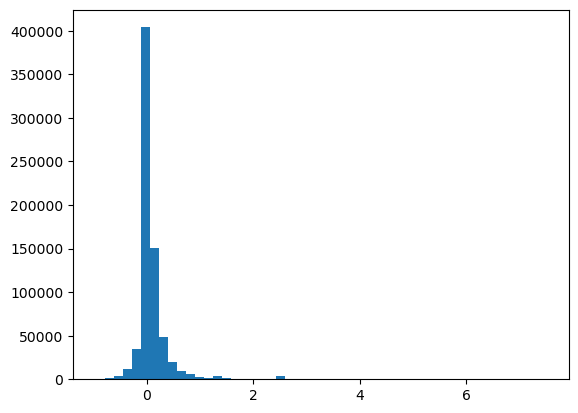

In [237]:
#k=13
plt.hist(((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))/(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)+0.4),bins=50)

In [138]:
# Create histogram
hist, bin_edges = np.histogram(((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))/(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)+0.4), bins=50)

# Find the index of the bin with the highest frequency
mode_index = np.argmax(hist)

# Calculate the mode value
mode_value = (bin_edges[mode_index] + bin_edges[mode_index + 1]) / 2

print("Mode:", mode_value)

Mode: -0.11096491228070177


In [81]:
np.where(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)>0)[0].shape

(707043,)

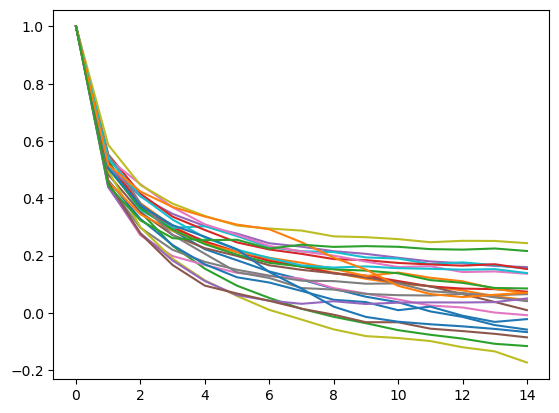

In [180]:
jump = 15
#for k in range(jump-2,jump*2,jump):
fit_range = np.array([2,3,4,6,7,8,11,12,15,16,17,19,20,21,24,26,27,28,29,30,32,34,36])
for k in list(jump+fit_range*jump):
    # Create histogram
    hist, bin_edges = np.histogram(((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))/(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)+0.4), bins=50)
    
    # Find the index of the bin with the highest frequency
    mode_index = np.argmax(hist)
    
    # Calculate the mode value
    mode_value = np.max([(bin_edges[mode_index] + bin_edges[mode_index + 1]) / 2,0.1])

    #mode_value = 1.5*mode_value
    
    plt.plot(np.mean(((mov.reshape(mov.shape[0],-1))[k:k+jump]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))[:,np.where((((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))/(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)+0.4))>mode_value)[0]]/((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))[np.where((((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))/(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)+0.4))>mode_value)[0]],1))

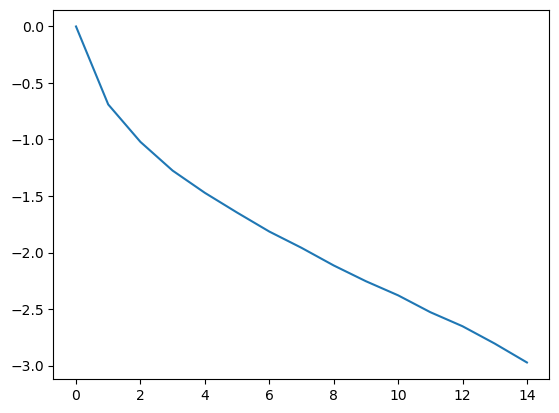

In [186]:
a = []
#jump = 3*mean_factor_slice_d[l]
#fit_range = fit_ranges_slice_d[l]
for k in list(jump+fit_range*jump):
    # Create histogram
    hist, bin_edges = np.histogram(((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))/(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)+0.4), bins=50)
    
    # Find the index of the bin with the highest frequency
    mode_index = np.argmax(hist)
    
    # Calculate the mode value
    mode_value = np.max([(bin_edges[mode_index] + bin_edges[mode_index + 1]) / 2,0.1])

    #mode_value = 1.5*mode_value
    
    a.append(np.mean(((mov.reshape(mov.shape[0],-1))[k:k+jump]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))[:,np.where((((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))/(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)+0.4))>mode_value)[0]]/((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))[np.where((((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))/(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)+0.4))>mode_value)[0]],1))
plt.plot(np.log(np.mean(np.array(a),0)))

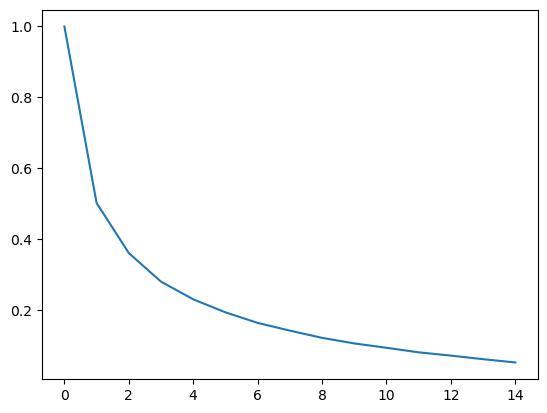

In [187]:
plt.plot(np.mean(np.array(a),0))

[-0.15469477 -0.83126405]


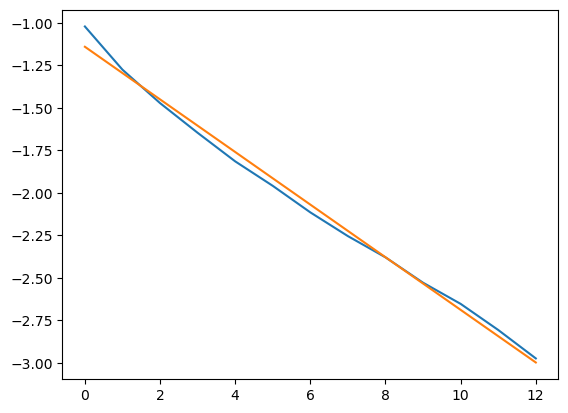

In [200]:
#a = []
#jump = 3*mean_factor_slice_d[l]
#fit_range = fit_ranges_slice_d[l]
#for k in list(jump-2+fit_range*jump):
#    a.append(np.mean(((cnmf_dicts_slice_d[l]['CY_m_raw'][np.argsort(cnmf_dicts_slice_d[l]['rises']),...].T)[k:k+jump]-(cnmf_dicts_slice_d[l]['CY_m_raw'][np.argsort(cnmf_dicts_slice_d[l]['rises']),...].T)[k])/((cnmf_dicts_slice_d[l]['CY_m_raw'][np.argsort(cnmf_dicts_slice_d[l]['rises']),...].T)[k+2]-np.mean((cnmf_dicts_slice_d[l]['CY_m_raw'][np.argsort(cnmf_dicts_slice_d[l]['rises']),...].T)[k-5:k],0)),1))
xa = np.arange(2,15)
ya = np.mean(np.array(a)[:,2:],0)
af = np.polyfit(xa, np.log(ya), 1)
print(af)
plt.plot(np.log(np.mean(np.array(a)[:,2:],0)))
plt.plot(af[0]*xa+af[1])

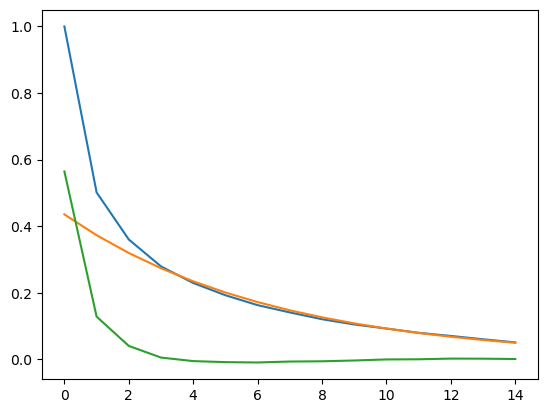

In [202]:
plt.plot(np.mean(np.array(a),0))
plt.plot(np.exp(af[0]*np.arange(15)+af[1]))
plt.plot(np.mean(np.array(a),0)-np.exp(af[0]*np.arange(15)+af[1]))

C:\Users\pkalugin\AppData\Local\Temp\7\ipykernel_24584\774111818.py:1: RuntimeWarning: invalid value encountered in log
  plt.plot(np.log(np.mean(np.array(a),0)-np.exp(af[0]*np.arange(15)+af[1])))


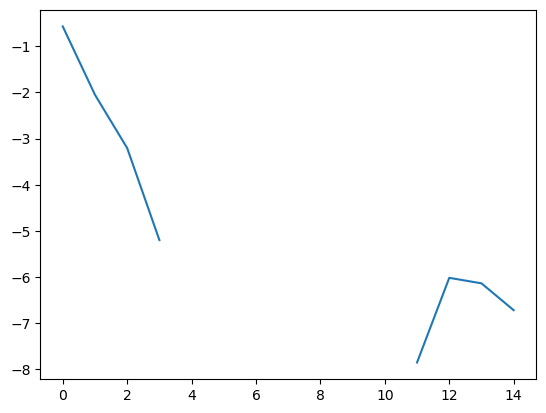

In [203]:
plt.plot(np.log(np.mean(np.array(a),0)-np.exp(af[0]*np.arange(15)+af[1])))

[-1.50381924 -0.50168767]


C:\Users\pkalugin\AppData\Local\Temp\7\ipykernel_24584\2269736690.py:10: RuntimeWarning: invalid value encountered in log
  plt.plot(np.log(np.mean(np.array(a),0)-np.exp(af[0]*np.arange(15)+af[1]))[:4])


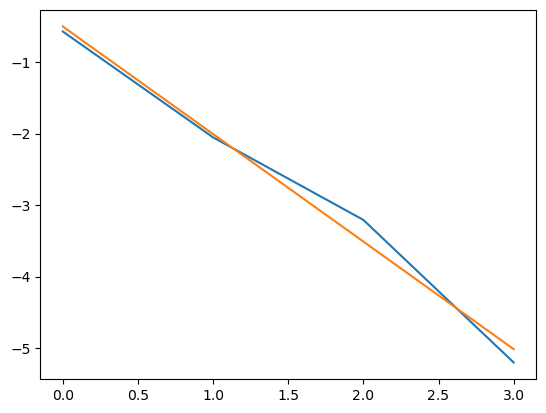

In [213]:
#a = []
#jump = 3*mean_factor_slice_d[l]
#fit_range = fit_ranges_slice_d[l]
#for k in list(jump-2+fit_range*jump):
#    a.append(np.mean(((cnmf_dicts_slice_d[l]['CY_m_raw'][np.argsort(cnmf_dicts_slice_d[l]['rises']),...].T)[k:k+jump]-(cnmf_dicts_slice_d[l]['CY_m_raw'][np.argsort(cnmf_dicts_slice_d[l]['rises']),...].T)[k])/((cnmf_dicts_slice_d[l]['CY_m_raw'][np.argsort(cnmf_dicts_slice_d[l]['rises']),...].T)[k+2]-np.mean((cnmf_dicts_slice_d[l]['CY_m_raw'][np.argsort(cnmf_dicts_slice_d[l]['rises']),...].T)[k-5:k],0)),1))
xa2 = np.arange(4)
ya2 = (np.mean(np.array(a),0)-np.exp(af[0]*np.arange(15)+af[1]))[:4]
af2 = np.polyfit(xa2, np.log(ya2), 1)
print(af2)
plt.plot(np.log(np.mean(np.array(a),0)-np.exp(af[0]*np.arange(15)+af[1]))[:4])
plt.plot(af2[0]*xa2+af2[1])

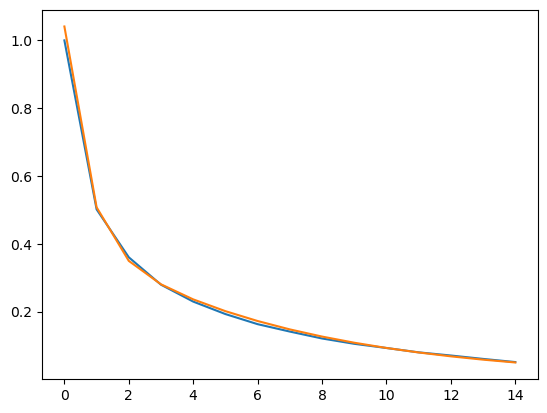

In [214]:
plt.plot(np.mean(np.array(a),0))
plt.plot(np.exp(af[0]*np.arange(15)+af[1])+np.exp(af2[0]*np.arange(15)+af2[1]))

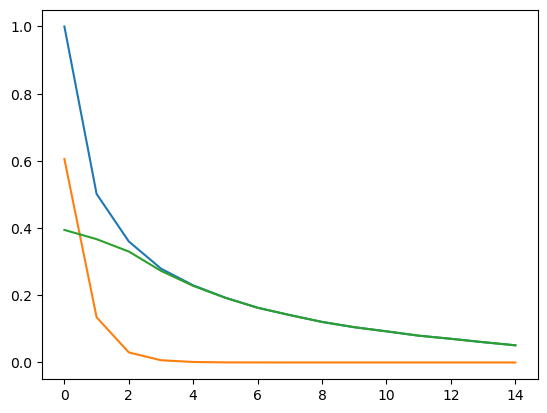

In [255]:
plt.plot(np.mean(np.array(a),0))
plt.plot(np.exp(af2[0]*np.arange(15)+af2[1]))
plt.plot(np.mean(np.array(a),0)-np.exp(af2[0]*np.arange(15)+af2[1]))

In [266]:
dfs = []
#jump = 3*mean_factor_slice_d[l]

for k in trange(jump,mov.reshape(mov.shape[0],-1).shape[0]-1,jump):
    # Create histogram
    #hist, bin_edges = np.histogram(((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))/(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)+0.4), bins=50)
    
    # Find the index of the bin with the highest frequency
    #mode_index = np.argmax(hist)
    
    # Calculate the mode value
    #mode_value = np.max([(bin_edges[mode_index] + bin_edges[mode_index + 1]) / 2,0.1])
        
    df = np.zeros(mov.reshape(mov.shape[0],-1).shape[1])
    df[np.where((mov.reshape(mov.shape[0],-1).T[:,k]-np.mean(mov.reshape(mov.shape[0],-1).T[:,k-5:k],1))>0)[0]] = (mov.reshape(mov.shape[0],-1).T[:,k]-np.mean(mov.reshape(mov.shape[0],-1).T[:,k-5:k],1))[np.where((mov.reshape(mov.shape[0],-1).T[:,k]-np.mean(mov.reshape(mov.shape[0],-1).T[:,k-5:k],1))>0)[0]]
    
    dfs.append(df)

mcb = np.zeros(mov.reshape(mov.shape[0],-1).T.shape)
for d in trange(np.array(dfs).shape[0]):
    #mcb[:,jump*(d+1):np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1,jump*(d+2)-1)] = mcb[:,jump*(d+1):np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1,jump*(d+2)-1)]+np.broadcast_to(np.exp(af[0]*np.arange(0,np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1-jump*(d+1),jump-1)))+np.exp(af2[0]*np.arange(0,np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1-jump*(d+1),jump-1))),(np.array(dfs).shape[1],) + (np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1-jump*(d+1),jump-1),))*np.array(dfs)[d,:][...,np.newaxis]
    mcb[:,jump*(d+1):np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1,jump*(d+2)-1)] = mcb[:,jump*(d+1):np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1,jump*(d+2)-1)]+np.broadcast_to(np.exp(af[0]*np.arange(0,np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1-jump*(d+1),jump-1))),(np.array(dfs).shape[1],) + (np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1-jump*(d+1),jump-1),))*np.array(dfs)[d,:][...,np.newaxis]

#cnmf_dicts_slice_d[l]['CY_m_raw_corr'] = cnmf_dicts_slice_d[l]['CY_m_raw']-cnmf_dicts_slice_d[l]['corrbase']

#cnmf_dicts_slice_d[l]['CY_m_raw_corr_sort'] = np.sort(cnmf_dicts_slice_d[l]['CY_m_raw_corr'],axis=1)
#cnmf_dicts_slice_d[l]['CY_m_raw_corr_b10'] = np.mean(cnmf_dicts_slice_d[l]['CY_m_raw_corr_sort'][:,:int(np.ceil(cnmf_dicts_slice_d[l]['CY_m_raw_corr_sort'].shape[1]/10))],axis=1) # bottom 10% mean
#cnmf_dicts_slice_d[l]['CY_m_raw_corr_t10'] = np.mean(cnmf_dicts_slice_d[l]['CY_m_raw_corr_sort'][:,-int(np.ceil(cnmf_dicts_slice_d[l]['CY_m_raw_corr_sort'].shape[1]/10)):],axis=1) # top 10% mean

#cnmf_dicts_slice_d[l]['CY_m_raw_corr_dff'] = ((cnmf_dicts_slice_d[l]['CY_m_raw_corr'].T-cnmf_dicts_slice_d[l]['CY_m_raw_corr_b10'])/(cnmf_dicts_slice_d[l]['CY_m_raw_corr_b10'])).T
#cnmf_dicts_slice_d[l]['CY_m_raw_corr_norm1'] = ((cnmf_dicts_slice_d[l]['CY_m_raw_corr'].T-cnmf_dicts_slice_d[l]['CY_m_raw_corr_b10'])/(cnmf_dicts_slice_d[l]['CY_m_raw_corr_t10']-cnmf_dicts_slice_d[l]['CY_m_raw_corr_b10'])).T

  0%|          | 0/37 [00:00<?, ?it/s]

  0%|          | 0/37 [00:00<?, ?it/s]

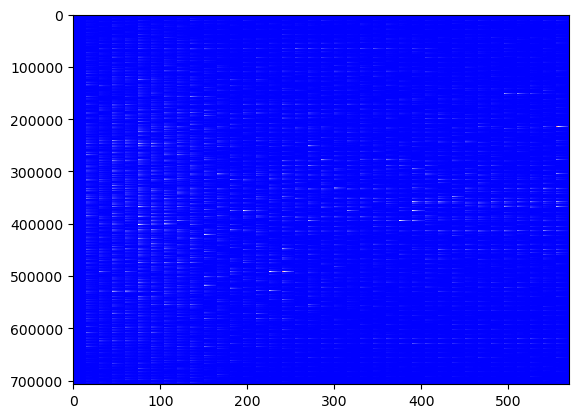

In [267]:
plt.imshow(mcb, interpolation='nearest', aspect='auto',cmap='bwr')

In [268]:
movc = mov-mcb.T.reshape(mov.shape)
movc.shape

(570, 449, 1575)

In [269]:
print(fname)
print(fname[:-4]+r'_corr.tif')

\\nasquatch\data\2p\peter\grin_videos\more_123124\CS2_nooverlay.tif
\\nasquatch\data\2p\peter\grin_videos\more_123124\CS2_nooverlay_corr.tif


In [270]:
imwrite(fname[:-4]+r'_corr3.tif',movc)

In [624]:
# supp video 3
fname = r'\\nasquatch\data\2p\peter\grin_videos\PL28_230922_001_full_wch1_aniso4_scale4AFS2PL4_toref35_wxy_nobg\movie_z06_tds3.tif'
mov = imread(fname)
mov.shape

(527, 433, 494)

In [625]:
mov.reshape(mov.shape[0],-1).shape

(527, 213902)

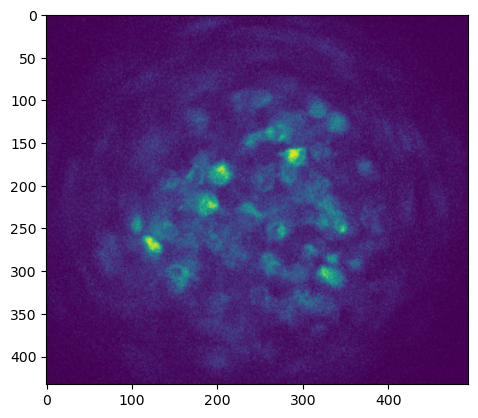

In [626]:
plt.imshow(mov[0,...])

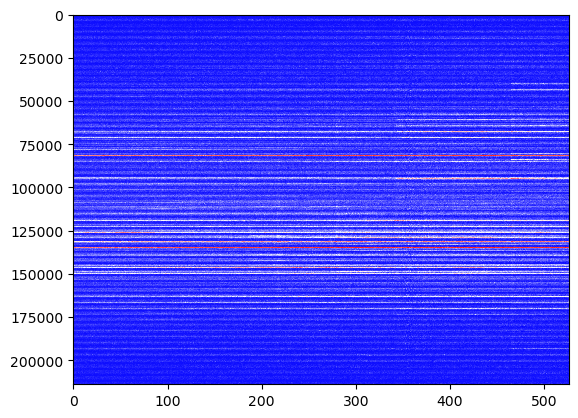

In [627]:
plt.imshow((mov.reshape(mov.shape[0],-1)).T, interpolation='nearest', aspect='auto',cmap='bwr')

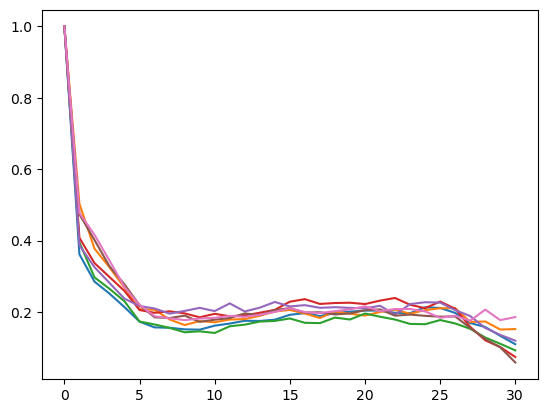

In [628]:
jump = 31
#for k in range(jump-2,jump*2,jump):
fit_range = np.array([0,2,3,4,7,11,15])
for k in list(jump+fit_range*jump):
    # Create histogram
    hist, bin_edges = np.histogram(((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))/(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)+0.4), bins=50)
    
    # Find the index of the bin with the highest frequency
    mode_index = np.argmax(hist)
    
    # Calculate the mode value
    mode_value = np.max([(bin_edges[mode_index] + bin_edges[mode_index + 1]) / 2,0.1])

    #mode_value = 1.5*mode_value
    
    plt.plot(np.mean(((mov.reshape(mov.shape[0],-1))[k:k+jump]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))[:,np.where((((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))/(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)+0.4))>mode_value)[0]]/((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))[np.where((((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))/(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)+0.4))>mode_value)[0]],1))

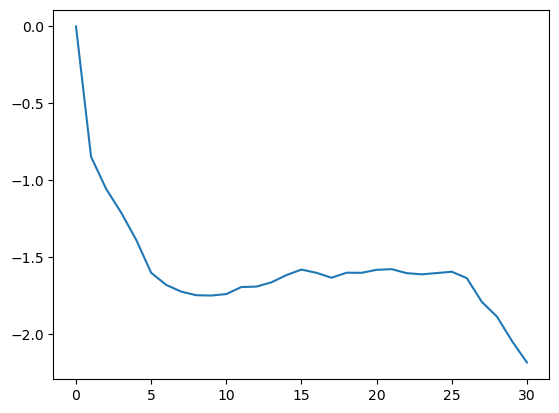

In [629]:
a = []
#jump = 3*mean_factor_slice_d[l]
#fit_range = fit_ranges_slice_d[l]
for k in list(jump+fit_range*jump):
    # Create histogram
    hist, bin_edges = np.histogram(((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))/(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)+0.4), bins=50)
    
    # Find the index of the bin with the highest frequency
    mode_index = np.argmax(hist)
    
    # Calculate the mode value
    mode_value = np.max([(bin_edges[mode_index] + bin_edges[mode_index + 1]) / 2,0.1])

    #mode_value = 1.5*mode_value
    
    a.append(np.mean(((mov.reshape(mov.shape[0],-1))[k:k+jump]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))[:,np.where((((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))/(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)+0.4))>mode_value)[0]]/((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))[np.where((((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))/(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)+0.4))>mode_value)[0]],1))
plt.plot(np.log(np.mean(np.array(a),0)))

[-0.84571099  0.        ]


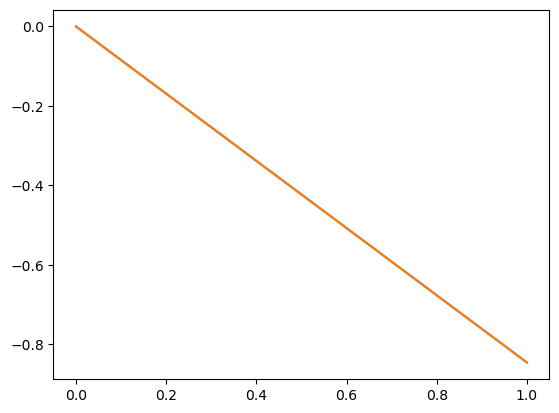

In [630]:
#a = []
#jump = 3*mean_factor_slice_d[l]
#fit_range = fit_ranges_slice_d[l]
#for k in list(jump-2+fit_range*jump):
#    a.append(np.mean(((cnmf_dicts_slice_d[l]['CY_m_raw'][np.argsort(cnmf_dicts_slice_d[l]['rises']),...].T)[k:k+jump]-(cnmf_dicts_slice_d[l]['CY_m_raw'][np.argsort(cnmf_dicts_slice_d[l]['rises']),...].T)[k])/((cnmf_dicts_slice_d[l]['CY_m_raw'][np.argsort(cnmf_dicts_slice_d[l]['rises']),...].T)[k+2]-np.mean((cnmf_dicts_slice_d[l]['CY_m_raw'][np.argsort(cnmf_dicts_slice_d[l]['rises']),...].T)[k-5:k],0)),1))
xa = np.arange(2)
ya = np.mean(np.array(a)[:,:2],0)
af = np.polyfit(xa, np.log(ya), 1)
print(af)
plt.plot(np.log(np.mean(np.array(a)[:,:2],0)))
plt.plot(af[0]*xa+af[1])

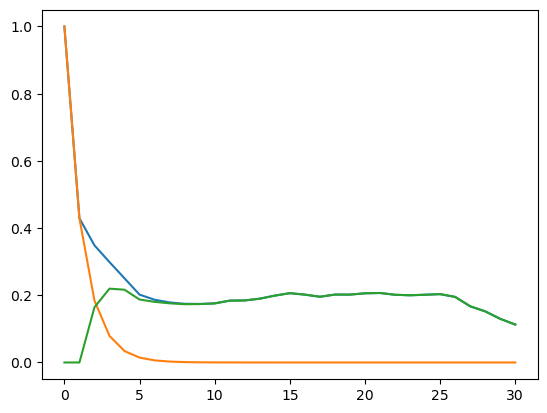

In [631]:
plt.plot(np.mean(np.array(a),0))
plt.plot(np.exp(af[0]*np.arange(31)+af[1]))
plt.plot(np.mean(np.array(a),0)-np.exp(af[0]*np.arange(31)+af[1]))

In [632]:
dfs = []
#jump = 3*mean_factor_slice_d[l]

for k in trange(jump,mov.reshape(mov.shape[0],-1).shape[0]-1,jump):
    # Create histogram
    #hist, bin_edges = np.histogram(((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))/(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)+0.4), bins=50)
    
    # Find the index of the bin with the highest frequency
    #mode_index = np.argmax(hist)
    
    # Calculate the mode value
    #mode_value = np.max([(bin_edges[mode_index] + bin_edges[mode_index + 1]) / 2,0.1])
        
    df = np.zeros(mov.reshape(mov.shape[0],-1).shape[1])
    df[np.where((mov.reshape(mov.shape[0],-1).T[:,k]-np.mean(mov.reshape(mov.shape[0],-1).T[:,k-5:k],1))>0)[0]] = (mov.reshape(mov.shape[0],-1).T[:,k]-np.mean(mov.reshape(mov.shape[0],-1).T[:,k-5:k],1))[np.where((mov.reshape(mov.shape[0],-1).T[:,k]-np.mean(mov.reshape(mov.shape[0],-1).T[:,k-5:k],1))>0)[0]]
    
    dfs.append(df)

mcb = np.zeros(mov.reshape(mov.shape[0],-1).T.shape)
for d in trange(np.array(dfs).shape[0]):
    #mcb[:,jump*(d+1):np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1,jump*(d+2)-1)] = mcb[:,jump*(d+1):np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1,jump*(d+2)-1)]+np.broadcast_to(np.exp(af[0]*np.arange(0,np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1-jump*(d+1),jump-1)))+np.exp(af2[0]*np.arange(0,np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1-jump*(d+1),jump-1))),(np.array(dfs).shape[1],) + (np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1-jump*(d+1),jump-1),))*np.array(dfs)[d,:][...,np.newaxis]
    mcb[:,jump*(d+1):np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1,jump*(d+2)-1)] = mcb[:,jump*(d+1):np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1,jump*(d+2)-1)]+np.broadcast_to(np.exp(af[0]*np.arange(0,np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1-jump*(d+1),jump-1))),(np.array(dfs).shape[1],) + (np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1-jump*(d+1),jump-1),))*np.array(dfs)[d,:][...,np.newaxis]
    
#cnmf_dicts_slice_d[l]['CY_m_raw_corr'] = cnmf_dicts_slice_d[l]['CY_m_raw']-cnmf_dicts_slice_d[l]['corrbase']

#cnmf_dicts_slice_d[l]['CY_m_raw_corr_sort'] = np.sort(cnmf_dicts_slice_d[l]['CY_m_raw_corr'],axis=1)
#cnmf_dicts_slice_d[l]['CY_m_raw_corr_b10'] = np.mean(cnmf_dicts_slice_d[l]['CY_m_raw_corr_sort'][:,:int(np.ceil(cnmf_dicts_slice_d[l]['CY_m_raw_corr_sort'].shape[1]/10))],axis=1) # bottom 10% mean
#cnmf_dicts_slice_d[l]['CY_m_raw_corr_t10'] = np.mean(cnmf_dicts_slice_d[l]['CY_m_raw_corr_sort'][:,-int(np.ceil(cnmf_dicts_slice_d[l]['CY_m_raw_corr_sort'].shape[1]/10)):],axis=1) # top 10% mean

#cnmf_dicts_slice_d[l]['CY_m_raw_corr_dff'] = ((cnmf_dicts_slice_d[l]['CY_m_raw_corr'].T-cnmf_dicts_slice_d[l]['CY_m_raw_corr_b10'])/(cnmf_dicts_slice_d[l]['CY_m_raw_corr_b10'])).T
#cnmf_dicts_slice_d[l]['CY_m_raw_corr_norm1'] = ((cnmf_dicts_slice_d[l]['CY_m_raw_corr'].T-cnmf_dicts_slice_d[l]['CY_m_raw_corr_b10'])/(cnmf_dicts_slice_d[l]['CY_m_raw_corr_t10']-cnmf_dicts_slice_d[l]['CY_m_raw_corr_b10'])).T

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

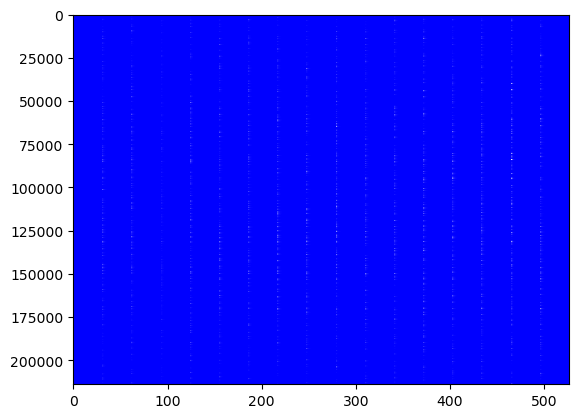

In [633]:
plt.imshow(mcb, interpolation='nearest', aspect='auto',cmap='bwr')

In [634]:
movc = mov-mcb.T.reshape(mov.shape)
movc.shape

(527, 433, 494)

In [635]:
for d in trange(np.array(dfs).shape[0]):
    movc[jump*(d+1),...] = np.mean([movc[jump*(d+1)-1,...],movc[jump*(d+1)+1,...]],axis=0)

  0%|          | 0/16 [00:00<?, ?it/s]

In [636]:
print(fname)
print(fname[:-4]+r'_corr.tif')

\\nasquatch\data\2p\peter\grin_videos\PL28_230922_001_full_wch1_aniso4_scale4AFS2PL4_toref35_wxy_nobg\movie_z06_tds3.tif
\\nasquatch\data\2p\peter\grin_videos\PL28_230922_001_full_wch1_aniso4_scale4AFS2PL4_toref35_wxy_nobg\movie_z06_tds3_corr.tif


In [637]:
imwrite(fname[:-4]+r'_corr.tif',movc)

In [726]:
# supp video 4
fname = r'\\nasquatch\data\2p\peter\grin_videos\PL28_230922_201_full_wch1_aniso4_scale4AFS2PL4_toref19_wxy_nobg\movie_z06_tds3.tif'
mov = imread(fname)
mov.shape

(403, 438, 500)

In [727]:
mov.reshape(mov.shape[0],-1).shape

(403, 219000)

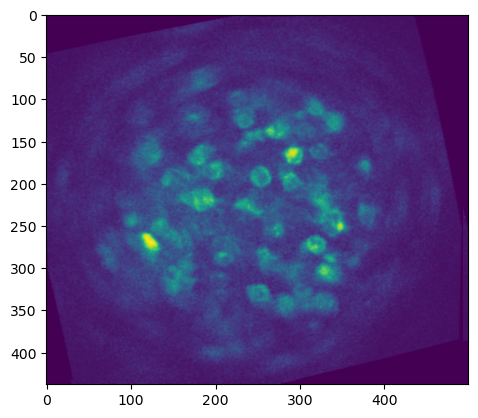

In [728]:
plt.imshow(mov[0,...])

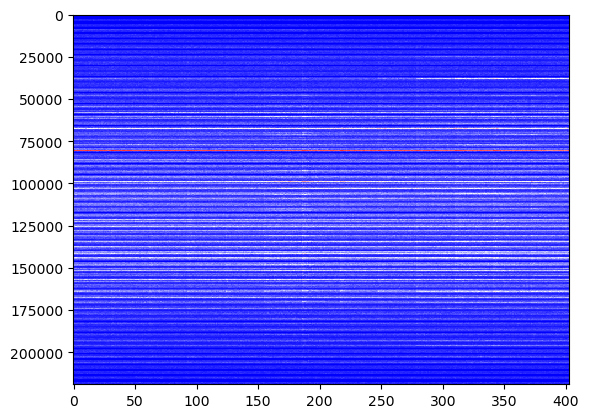

In [729]:
plt.imshow((mov.reshape(mov.shape[0],-1)).T, interpolation='nearest', aspect='auto',cmap='bwr')

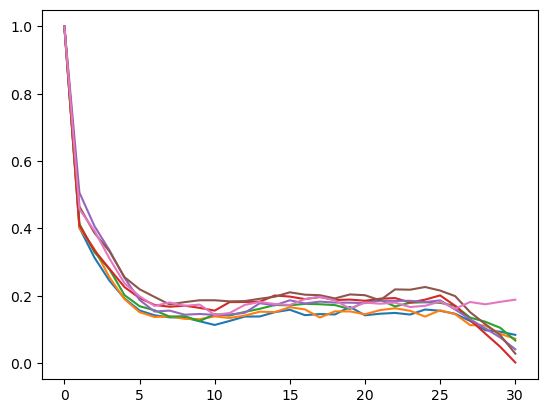

In [730]:
jump = 31
#for k in range(jump-2,jump*2,jump):
fit_range = np.array([0,1,2,3,6,7,11])
for k in list(jump+fit_range*jump):
    # Create histogram
    hist, bin_edges = np.histogram(((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))/(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)+0.4), bins=50)
    
    # Find the index of the bin with the highest frequency
    mode_index = np.argmax(hist)
    
    # Calculate the mode value
    mode_value = np.max([(bin_edges[mode_index] + bin_edges[mode_index + 1]) / 2,0.1])

    #mode_value = 1.5*mode_value
    
    plt.plot(np.mean(((mov.reshape(mov.shape[0],-1))[k:k+jump]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))[:,np.where((((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))/(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)+0.4))>mode_value)[0]]/((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))[np.where((((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))/(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)+0.4))>mode_value)[0]],1))

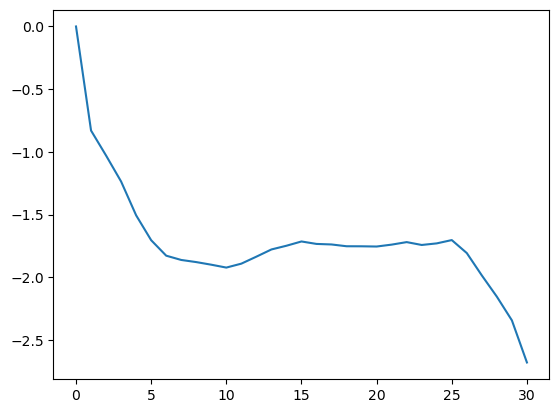

In [731]:
a = []
#jump = 3*mean_factor_slice_d[l]
#fit_range = fit_ranges_slice_d[l]
for k in list(jump+fit_range*jump):
    # Create histogram
    hist, bin_edges = np.histogram(((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))/(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)+0.4), bins=50)
    
    # Find the index of the bin with the highest frequency
    mode_index = np.argmax(hist)
    
    # Calculate the mode value
    mode_value = np.max([(bin_edges[mode_index] + bin_edges[mode_index + 1]) / 2,0.1])

    #mode_value = 1.5*mode_value
    
    a.append(np.mean(((mov.reshape(mov.shape[0],-1))[k:k+jump]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))[:,np.where((((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))/(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)+0.4))>mode_value)[0]]/((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))[np.where((((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))/(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)+0.4))>mode_value)[0]],1))
plt.plot(np.log(np.mean(np.array(a),0)))

[-0.82952581  0.        ]


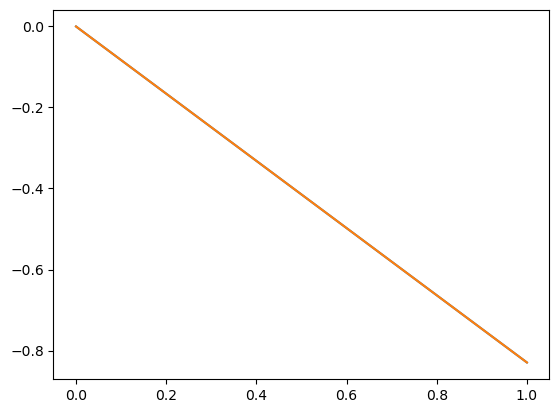

In [732]:
#a = []
#jump = 3*mean_factor_slice_d[l]
#fit_range = fit_ranges_slice_d[l]
#for k in list(jump-2+fit_range*jump):
#    a.append(np.mean(((cnmf_dicts_slice_d[l]['CY_m_raw'][np.argsort(cnmf_dicts_slice_d[l]['rises']),...].T)[k:k+jump]-(cnmf_dicts_slice_d[l]['CY_m_raw'][np.argsort(cnmf_dicts_slice_d[l]['rises']),...].T)[k])/((cnmf_dicts_slice_d[l]['CY_m_raw'][np.argsort(cnmf_dicts_slice_d[l]['rises']),...].T)[k+2]-np.mean((cnmf_dicts_slice_d[l]['CY_m_raw'][np.argsort(cnmf_dicts_slice_d[l]['rises']),...].T)[k-5:k],0)),1))
xa = np.arange(2)
ya = np.mean(np.array(a)[:,:2],0)
af = np.polyfit(xa, np.log(ya), 1)
print(af)
plt.plot(np.log(np.mean(np.array(a)[:,:2],0)))
plt.plot(af[0]*xa+af[1])

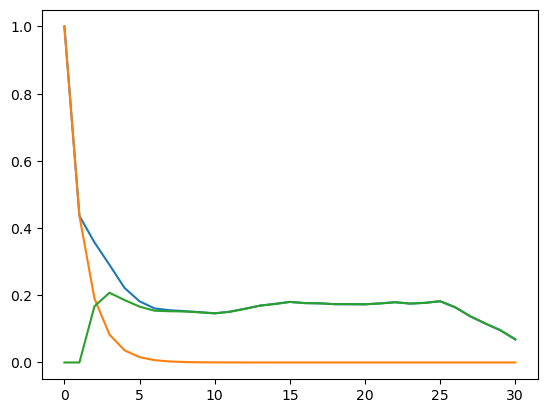

In [733]:
plt.plot(np.mean(np.array(a),0))
plt.plot(np.exp(af[0]*np.arange(31)+af[1]))
plt.plot(np.mean(np.array(a),0)-np.exp(af[0]*np.arange(31)+af[1]))

In [734]:
dfs = []
#jump = 3*mean_factor_slice_d[l]

for k in trange(jump,mov.reshape(mov.shape[0],-1).shape[0]-1,jump):
    # Create histogram
    #hist, bin_edges = np.histogram(((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))/(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)+0.4), bins=50)
    
    # Find the index of the bin with the highest frequency
    #mode_index = np.argmax(hist)
    
    # Calculate the mode value
    #mode_value = np.max([(bin_edges[mode_index] + bin_edges[mode_index + 1]) / 2,0.1])
        
    df = np.zeros(mov.reshape(mov.shape[0],-1).shape[1])
    df[np.where((mov.reshape(mov.shape[0],-1).T[:,k]-np.mean(mov.reshape(mov.shape[0],-1).T[:,k-5:k],1))>0)[0]] = (mov.reshape(mov.shape[0],-1).T[:,k]-np.mean(mov.reshape(mov.shape[0],-1).T[:,k-5:k],1))[np.where((mov.reshape(mov.shape[0],-1).T[:,k]-np.mean(mov.reshape(mov.shape[0],-1).T[:,k-5:k],1))>0)[0]]
    
    dfs.append(df)

mcb = np.zeros(mov.reshape(mov.shape[0],-1).T.shape)
for d in trange(np.array(dfs).shape[0]):
    #mcb[:,jump*(d+1):np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1,jump*(d+2)-1)] = mcb[:,jump*(d+1):np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1,jump*(d+2)-1)]+np.broadcast_to(np.exp(af[0]*np.arange(0,np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1-jump*(d+1),jump-1)))+np.exp(af2[0]*np.arange(0,np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1-jump*(d+1),jump-1))),(np.array(dfs).shape[1],) + (np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1-jump*(d+1),jump-1),))*np.array(dfs)[d,:][...,np.newaxis]
    mcb[:,jump*(d+1):np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1,jump*(d+2)-1)] = mcb[:,jump*(d+1):np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1,jump*(d+2)-1)]+np.broadcast_to(np.exp(af[0]*np.arange(0,np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1-jump*(d+1),jump-1))),(np.array(dfs).shape[1],) + (np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1-jump*(d+1),jump-1),))*np.array(dfs)[d,:][...,np.newaxis]

#cnmf_dicts_slice_d[l]['CY_m_raw_corr'] = cnmf_dicts_slice_d[l]['CY_m_raw']-cnmf_dicts_slice_d[l]['corrbase']

#cnmf_dicts_slice_d[l]['CY_m_raw_corr_sort'] = np.sort(cnmf_dicts_slice_d[l]['CY_m_raw_corr'],axis=1)
#cnmf_dicts_slice_d[l]['CY_m_raw_corr_b10'] = np.mean(cnmf_dicts_slice_d[l]['CY_m_raw_corr_sort'][:,:int(np.ceil(cnmf_dicts_slice_d[l]['CY_m_raw_corr_sort'].shape[1]/10))],axis=1) # bottom 10% mean
#cnmf_dicts_slice_d[l]['CY_m_raw_corr_t10'] = np.mean(cnmf_dicts_slice_d[l]['CY_m_raw_corr_sort'][:,-int(np.ceil(cnmf_dicts_slice_d[l]['CY_m_raw_corr_sort'].shape[1]/10)):],axis=1) # top 10% mean

#cnmf_dicts_slice_d[l]['CY_m_raw_corr_dff'] = ((cnmf_dicts_slice_d[l]['CY_m_raw_corr'].T-cnmf_dicts_slice_d[l]['CY_m_raw_corr_b10'])/(cnmf_dicts_slice_d[l]['CY_m_raw_corr_b10'])).T
#cnmf_dicts_slice_d[l]['CY_m_raw_corr_norm1'] = ((cnmf_dicts_slice_d[l]['CY_m_raw_corr'].T-cnmf_dicts_slice_d[l]['CY_m_raw_corr_b10'])/(cnmf_dicts_slice_d[l]['CY_m_raw_corr_t10']-cnmf_dicts_slice_d[l]['CY_m_raw_corr_b10'])).T

  0%|          | 0/12 [00:00<?, ?it/s]

  0%|          | 0/12 [00:00<?, ?it/s]

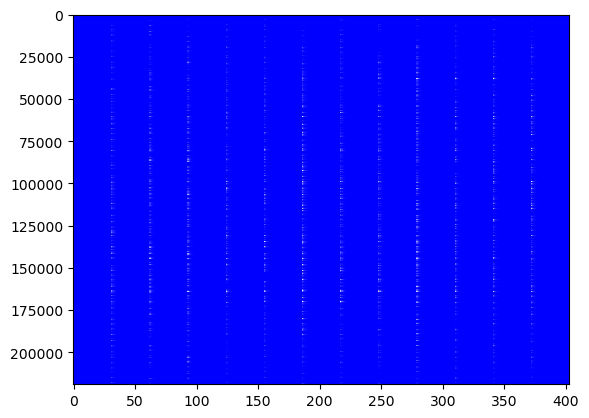

In [735]:
plt.imshow(mcb, interpolation='nearest', aspect='auto',cmap='bwr')

In [736]:
movc = mov-mcb.T.reshape(mov.shape)
movc.shape

(403, 438, 500)

In [737]:
for d in trange(np.array(dfs).shape[0]):
    movc[jump*(d+1),...] = np.mean([movc[jump*(d+1)-1,...],movc[jump*(d+1)+1,...]],axis=0)

  0%|          | 0/12 [00:00<?, ?it/s]

In [738]:
print(fname)
print(fname[:-4]+r'_corr.tif')

\\nasquatch\data\2p\peter\grin_videos\PL28_230922_201_full_wch1_aniso4_scale4AFS2PL4_toref19_wxy_nobg\movie_z06_tds3.tif
\\nasquatch\data\2p\peter\grin_videos\PL28_230922_201_full_wch1_aniso4_scale4AFS2PL4_toref19_wxy_nobg\movie_z06_tds3_corr.tif


In [739]:
imwrite(fname[:-4]+r'_corr.tif',movc)

In [812]:
# supp video 6
fname = r'\\nasquatch\data\2p\peter\grin_videos\PL56_230829_001_full_wch1_aniso4_scale4AFS2PL4_toref52_wxy_nobg\movie_z09_tds3.tif'
mov = imread(fname)
mov.shape

(1820, 423, 482)

In [813]:
mov.reshape(mov.shape[0],-1).shape

(1820, 203886)

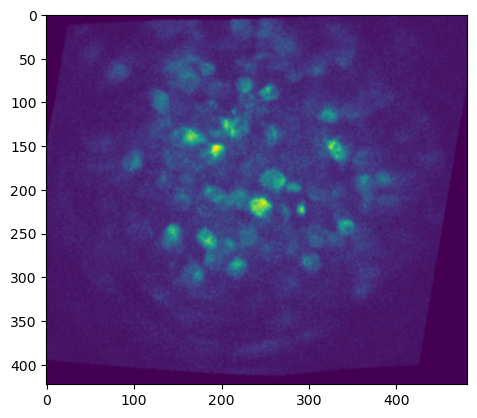

In [814]:
plt.imshow(mov[0,...])

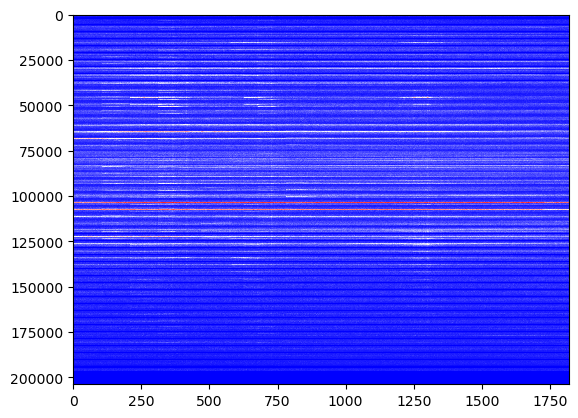

In [815]:
plt.imshow((mov.reshape(mov.shape[0],-1)).T, interpolation='nearest', aspect='auto',cmap='bwr')

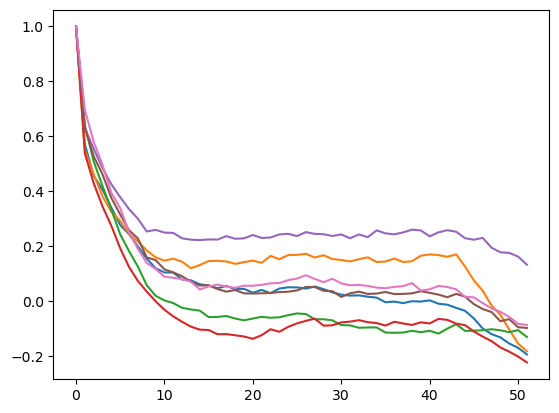

In [816]:
jump = 52
#for k in range(jump-2,jump*2,jump):
fit_range = np.array([2,4,6,7,8,13,14])
for k in list(jump+fit_range*jump):
    # Create histogram
    hist, bin_edges = np.histogram(((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))/(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)+0.4), bins=50)
    
    # Find the index of the bin with the highest frequency
    mode_index = np.argmax(hist)
    
    # Calculate the mode value
    mode_value = np.max([(bin_edges[mode_index] + bin_edges[mode_index + 1]) / 2,0.1])

    #mode_value = 1.5*mode_value
    
    plt.plot(np.mean(((mov.reshape(mov.shape[0],-1))[k:k+jump]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))[:,np.where((((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))/(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)+0.4))>mode_value)[0]]/((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))[np.where((((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))/(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)+0.4))>mode_value)[0]],1))

C:\Users\pkalugin\AppData\Local\Temp\7\ipykernel_24584\2291016377.py:17: RuntimeWarning: invalid value encountered in log
  plt.plot(np.log(np.mean(np.array(a),0)))


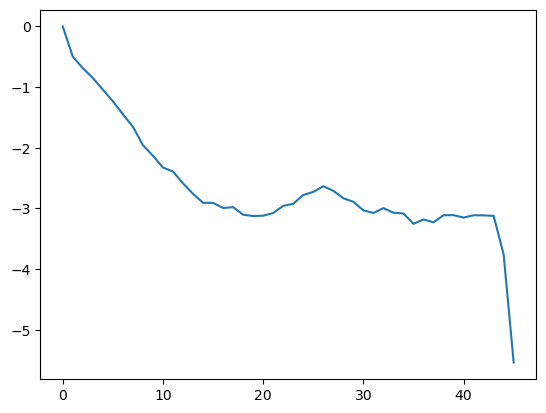

In [817]:
a = []
#jump = 3*mean_factor_slice_d[l]
#fit_range = fit_ranges_slice_d[l]
for k in list(jump+fit_range*jump):
    # Create histogram
    hist, bin_edges = np.histogram(((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))/(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)+0.4), bins=50)
    
    # Find the index of the bin with the highest frequency
    mode_index = np.argmax(hist)
    
    # Calculate the mode value
    mode_value = np.max([(bin_edges[mode_index] + bin_edges[mode_index + 1]) / 2,0.1])

    #mode_value = 1.5*mode_value
    
    a.append(np.mean(((mov.reshape(mov.shape[0],-1))[k:k+jump]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))[:,np.where((((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))/(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)+0.4))>mode_value)[0]]/((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))[np.where((((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))/(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)+0.4))>mode_value)[0]],1))
plt.plot(np.log(np.mean(np.array(a),0)))

[-0.19908286 -0.23733063]


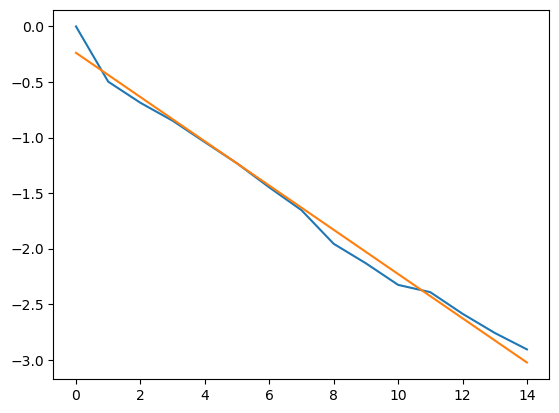

In [818]:
#a = []
#jump = 3*mean_factor_slice_d[l]
#fit_range = fit_ranges_slice_d[l]
#for k in list(jump-2+fit_range*jump):
#    a.append(np.mean(((cnmf_dicts_slice_d[l]['CY_m_raw'][np.argsort(cnmf_dicts_slice_d[l]['rises']),...].T)[k:k+jump]-(cnmf_dicts_slice_d[l]['CY_m_raw'][np.argsort(cnmf_dicts_slice_d[l]['rises']),...].T)[k])/((cnmf_dicts_slice_d[l]['CY_m_raw'][np.argsort(cnmf_dicts_slice_d[l]['rises']),...].T)[k+2]-np.mean((cnmf_dicts_slice_d[l]['CY_m_raw'][np.argsort(cnmf_dicts_slice_d[l]['rises']),...].T)[k-5:k],0)),1))
xa = np.arange(15)
ya = np.mean(np.array(a)[:,:15],0)
af = np.polyfit(xa, np.log(ya), 1)
print(af)
plt.plot(np.log(np.mean(np.array(a)[:,:15],0)))
plt.plot(af[0]*xa+af[1])

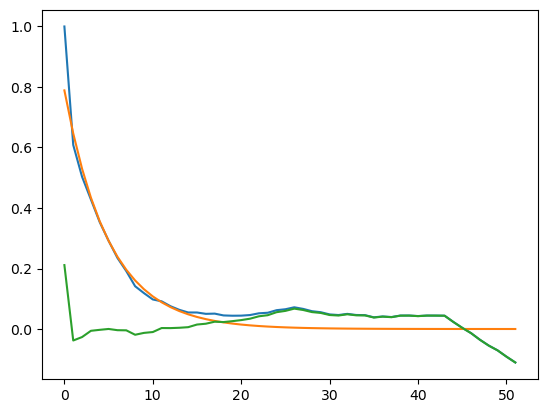

In [819]:
plt.plot(np.mean(np.array(a),0))
plt.plot(np.exp(af[0]*np.arange(52)+af[1]))
plt.plot(np.mean(np.array(a),0)-np.exp(af[0]*np.arange(52)+af[1]))

In [820]:
dfs = []
#jump = 3*mean_factor_slice_d[l]

for k in trange(jump,mov.reshape(mov.shape[0],-1).shape[0]-1,jump):
    # Create histogram
    #hist, bin_edges = np.histogram(((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))/(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)+0.4), bins=50)
    
    # Find the index of the bin with the highest frequency
    #mode_index = np.argmax(hist)
    
    # Calculate the mode value
    #mode_value = np.max([(bin_edges[mode_index] + bin_edges[mode_index + 1]) / 2,0.1])
        
    df = np.zeros(mov.reshape(mov.shape[0],-1).shape[1])
    df[np.where((mov.reshape(mov.shape[0],-1).T[:,k]-np.mean(mov.reshape(mov.shape[0],-1).T[:,k-5:k],1))>0)[0]] = (mov.reshape(mov.shape[0],-1).T[:,k]-np.mean(mov.reshape(mov.shape[0],-1).T[:,k-5:k],1))[np.where((mov.reshape(mov.shape[0],-1).T[:,k]-np.mean(mov.reshape(mov.shape[0],-1).T[:,k-5:k],1))>0)[0]]
    
    dfs.append(df)

mcb = np.zeros(mov.reshape(mov.shape[0],-1).T.shape)
for d in trange(np.array(dfs).shape[0]):
    #mcb[:,jump*(d+1):np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1,jump*(d+2)-1)] = mcb[:,jump*(d+1):np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1,jump*(d+2)-1)]+np.broadcast_to(np.exp(af[0]*np.arange(0,np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1-jump*(d+1),jump-1)))+np.exp(af2[0]*np.arange(0,np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1-jump*(d+1),jump-1))),(np.array(dfs).shape[1],) + (np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1-jump*(d+1),jump-1),))*np.array(dfs)[d,:][...,np.newaxis]
    mcb[:,jump*(d+1):np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1,jump*(d+2)-1)] = mcb[:,jump*(d+1):np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1,jump*(d+2)-1)]+np.broadcast_to(np.exp(af[0]*np.arange(0,np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1-jump*(d+1),jump-1))),(np.array(dfs).shape[1],) + (np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1-jump*(d+1),jump-1),))*np.array(dfs)[d,:][...,np.newaxis]

#cnmf_dicts_slice_d[l]['CY_m_raw_corr'] = cnmf_dicts_slice_d[l]['CY_m_raw']-cnmf_dicts_slice_d[l]['corrbase']

#cnmf_dicts_slice_d[l]['CY_m_raw_corr_sort'] = np.sort(cnmf_dicts_slice_d[l]['CY_m_raw_corr'],axis=1)
#cnmf_dicts_slice_d[l]['CY_m_raw_corr_b10'] = np.mean(cnmf_dicts_slice_d[l]['CY_m_raw_corr_sort'][:,:int(np.ceil(cnmf_dicts_slice_d[l]['CY_m_raw_corr_sort'].shape[1]/10))],axis=1) # bottom 10% mean
#cnmf_dicts_slice_d[l]['CY_m_raw_corr_t10'] = np.mean(cnmf_dicts_slice_d[l]['CY_m_raw_corr_sort'][:,-int(np.ceil(cnmf_dicts_slice_d[l]['CY_m_raw_corr_sort'].shape[1]/10)):],axis=1) # top 10% mean

#cnmf_dicts_slice_d[l]['CY_m_raw_corr_dff'] = ((cnmf_dicts_slice_d[l]['CY_m_raw_corr'].T-cnmf_dicts_slice_d[l]['CY_m_raw_corr_b10'])/(cnmf_dicts_slice_d[l]['CY_m_raw_corr_b10'])).T
#cnmf_dicts_slice_d[l]['CY_m_raw_corr_norm1'] = ((cnmf_dicts_slice_d[l]['CY_m_raw_corr'].T-cnmf_dicts_slice_d[l]['CY_m_raw_corr_b10'])/(cnmf_dicts_slice_d[l]['CY_m_raw_corr_t10']-cnmf_dicts_slice_d[l]['CY_m_raw_corr_b10'])).T

  0%|          | 0/34 [00:00<?, ?it/s]

  0%|          | 0/34 [00:00<?, ?it/s]

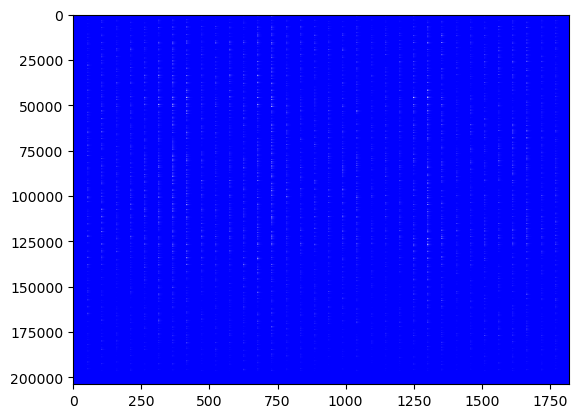

In [821]:
plt.imshow(mcb, interpolation='nearest', aspect='auto',cmap='bwr')

In [822]:
movc = mov-mcb.T.reshape(mov.shape)
movc.shape

(1820, 423, 482)

In [823]:
for d in trange(np.array(dfs).shape[0]):
    movc[jump*(d+1),...] = np.mean([movc[jump*(d+1)-1,...],movc[jump*(d+1)+1,...]],axis=0)

  0%|          | 0/34 [00:00<?, ?it/s]

In [824]:
print(fname)
print(fname[:-4]+r'_corr.tif')

\\nasquatch\data\2p\peter\grin_videos\PL56_230829_001_full_wch1_aniso4_scale4AFS2PL4_toref52_wxy_nobg\movie_z09_tds3.tif
\\nasquatch\data\2p\peter\grin_videos\PL56_230829_001_full_wch1_aniso4_scale4AFS2PL4_toref52_wxy_nobg\movie_z09_tds3_corr.tif


In [825]:
imwrite(fname[:-4]+r'_corr.tif',movc)

In [826]:
# supp video 8
fname = r'\\nasquatch\data\2p\peter\grin_videos\PK49PL18_220701_101_full_wch0_aniso4_scale4AFS2PL4_toref100_wxy_nobg\movie_z10_tds3.tif'
mov = imread(fname)
mov.shape

(2756, 414, 475)

In [827]:
mov.reshape(mov.shape[0],-1).shape

(2756, 196650)

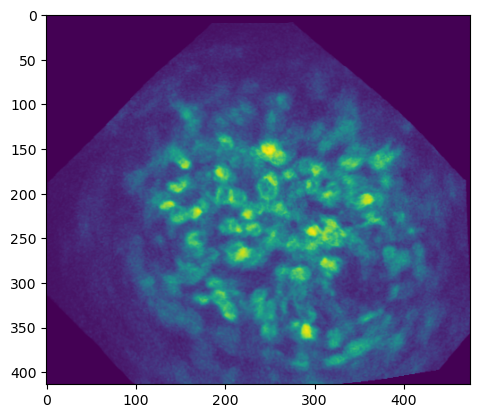

In [828]:
plt.imshow(mov[0,...])

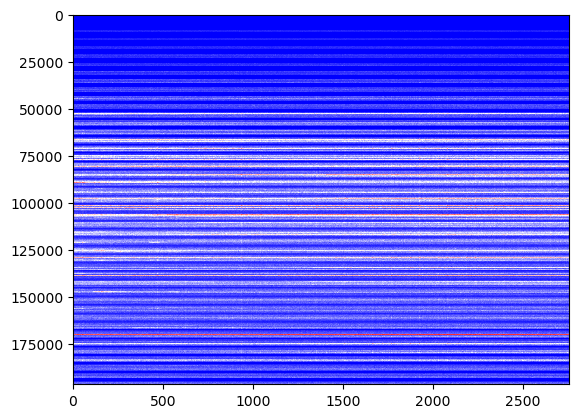

In [829]:
plt.imshow((mov.reshape(mov.shape[0],-1)).T, interpolation='nearest', aspect='auto',cmap='bwr')

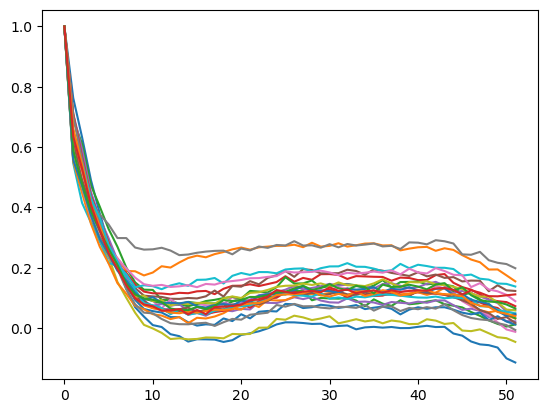

In [830]:
jump = 52
#for k in range(jump-2,jump*2,jump):
fit_range = np.array([0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23])
for k in list(jump+fit_range*jump):
    # Create histogram
    hist, bin_edges = np.histogram(((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))/(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)+0.4), bins=50)
    
    # Find the index of the bin with the highest frequency
    mode_index = np.argmax(hist)
    
    # Calculate the mode value
    mode_value = np.max([(bin_edges[mode_index] + bin_edges[mode_index + 1]) / 2,0.1])

    #mode_value = 1.5*mode_value
    
    plt.plot(np.mean(((mov.reshape(mov.shape[0],-1))[k:k+jump]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))[:,np.where((((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))/(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)+0.4))>mode_value)[0]]/((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))[np.where((((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))/(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)+0.4))>mode_value)[0]],1))

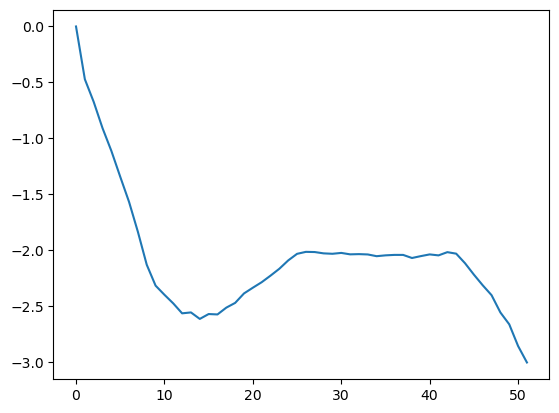

In [831]:
a = []
#jump = 3*mean_factor_slice_d[l]
#fit_range = fit_ranges_slice_d[l]
for k in list(jump+fit_range*jump):
    # Create histogram
    hist, bin_edges = np.histogram(((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))/(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)+0.4), bins=50)
    
    # Find the index of the bin with the highest frequency
    mode_index = np.argmax(hist)
    
    # Calculate the mode value
    mode_value = np.max([(bin_edges[mode_index] + bin_edges[mode_index + 1]) / 2,0.1])

    #mode_value = 1.5*mode_value
    
    a.append(np.mean(((mov.reshape(mov.shape[0],-1))[k:k+jump]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))[:,np.where((((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))/(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)+0.4))>mode_value)[0]]/((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))[np.where((((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))/(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)+0.4))>mode_value)[0]],1))
plt.plot(np.log(np.mean(np.array(a),0)))

[-0.24504902 -0.13216328]


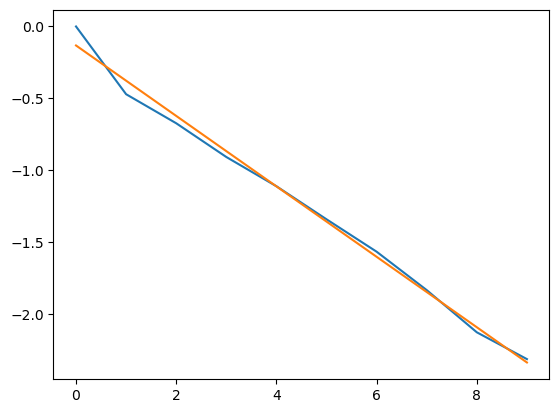

In [832]:
#a = []
#jump = 3*mean_factor_slice_d[l]
#fit_range = fit_ranges_slice_d[l]
#for k in list(jump-2+fit_range*jump):
#    a.append(np.mean(((cnmf_dicts_slice_d[l]['CY_m_raw'][np.argsort(cnmf_dicts_slice_d[l]['rises']),...].T)[k:k+jump]-(cnmf_dicts_slice_d[l]['CY_m_raw'][np.argsort(cnmf_dicts_slice_d[l]['rises']),...].T)[k])/((cnmf_dicts_slice_d[l]['CY_m_raw'][np.argsort(cnmf_dicts_slice_d[l]['rises']),...].T)[k+2]-np.mean((cnmf_dicts_slice_d[l]['CY_m_raw'][np.argsort(cnmf_dicts_slice_d[l]['rises']),...].T)[k-5:k],0)),1))
xa = np.arange(10)
ya = np.mean(np.array(a)[:,:10],0)
af = np.polyfit(xa, np.log(ya), 1)
print(af)
plt.plot(np.log(np.mean(np.array(a)[:,:10],0)))
plt.plot(af[0]*xa+af[1])

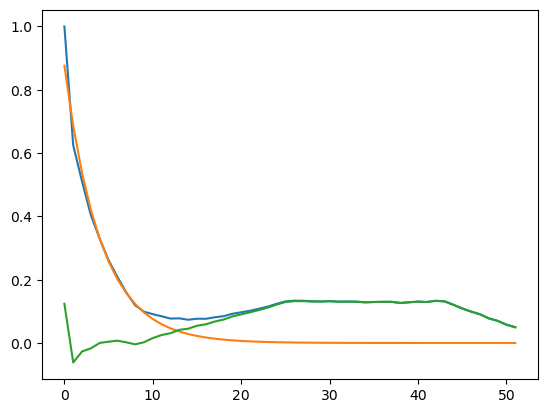

In [833]:
plt.plot(np.mean(np.array(a),0))
plt.plot(np.exp(af[0]*np.arange(52)+af[1]))
plt.plot(np.mean(np.array(a),0)-np.exp(af[0]*np.arange(52)+af[1]))

In [834]:
dfs = []
#jump = 3*mean_factor_slice_d[l]

for k in trange(jump,mov.reshape(mov.shape[0],-1).shape[0]-1,jump):
    # Create histogram
    #hist, bin_edges = np.histogram(((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))/(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)+0.4), bins=50)
    
    # Find the index of the bin with the highest frequency
    #mode_index = np.argmax(hist)
    
    # Calculate the mode value
    #mode_value = np.max([(bin_edges[mode_index] + bin_edges[mode_index + 1]) / 2,0.1])
        
    df = np.zeros(mov.reshape(mov.shape[0],-1).shape[1])
    df[np.where((mov.reshape(mov.shape[0],-1).T[:,k]-np.mean(mov.reshape(mov.shape[0],-1).T[:,k-5:k],1))>0)[0]] = (mov.reshape(mov.shape[0],-1).T[:,k]-np.mean(mov.reshape(mov.shape[0],-1).T[:,k-5:k],1))[np.where((mov.reshape(mov.shape[0],-1).T[:,k]-np.mean(mov.reshape(mov.shape[0],-1).T[:,k-5:k],1))>0)[0]]
    
    dfs.append(df)

mcb = np.zeros(mov.reshape(mov.shape[0],-1).T.shape)
for d in trange(np.array(dfs).shape[0]):
    #mcb[:,jump*(d+1):np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1,jump*(d+2)-1)] = mcb[:,jump*(d+1):np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1,jump*(d+2)-1)]+np.broadcast_to(np.exp(af[0]*np.arange(0,np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1-jump*(d+1),jump-1)))+np.exp(af2[0]*np.arange(0,np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1-jump*(d+1),jump-1))),(np.array(dfs).shape[1],) + (np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1-jump*(d+1),jump-1),))*np.array(dfs)[d,:][...,np.newaxis]
    mcb[:,jump*(d+1):np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1,jump*(d+2)-1)] = mcb[:,jump*(d+1):np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1,jump*(d+2)-1)]+np.broadcast_to(np.exp(af[0]*np.arange(0,np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1-jump*(d+1),jump-1))),(np.array(dfs).shape[1],) + (np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1-jump*(d+1),jump-1),))*np.array(dfs)[d,:][...,np.newaxis]

#cnmf_dicts_slice_d[l]['CY_m_raw_corr'] = cnmf_dicts_slice_d[l]['CY_m_raw']-cnmf_dicts_slice_d[l]['corrbase']

#cnmf_dicts_slice_d[l]['CY_m_raw_corr_sort'] = np.sort(cnmf_dicts_slice_d[l]['CY_m_raw_corr'],axis=1)
#cnmf_dicts_slice_d[l]['CY_m_raw_corr_b10'] = np.mean(cnmf_dicts_slice_d[l]['CY_m_raw_corr_sort'][:,:int(np.ceil(cnmf_dicts_slice_d[l]['CY_m_raw_corr_sort'].shape[1]/10))],axis=1) # bottom 10% mean
#cnmf_dicts_slice_d[l]['CY_m_raw_corr_t10'] = np.mean(cnmf_dicts_slice_d[l]['CY_m_raw_corr_sort'][:,-int(np.ceil(cnmf_dicts_slice_d[l]['CY_m_raw_corr_sort'].shape[1]/10)):],axis=1) # top 10% mean

#cnmf_dicts_slice_d[l]['CY_m_raw_corr_dff'] = ((cnmf_dicts_slice_d[l]['CY_m_raw_corr'].T-cnmf_dicts_slice_d[l]['CY_m_raw_corr_b10'])/(cnmf_dicts_slice_d[l]['CY_m_raw_corr_b10'])).T
#cnmf_dicts_slice_d[l]['CY_m_raw_corr_norm1'] = ((cnmf_dicts_slice_d[l]['CY_m_raw_corr'].T-cnmf_dicts_slice_d[l]['CY_m_raw_corr_b10'])/(cnmf_dicts_slice_d[l]['CY_m_raw_corr_t10']-cnmf_dicts_slice_d[l]['CY_m_raw_corr_b10'])).T

  0%|          | 0/52 [00:00<?, ?it/s]

  0%|          | 0/52 [00:00<?, ?it/s]

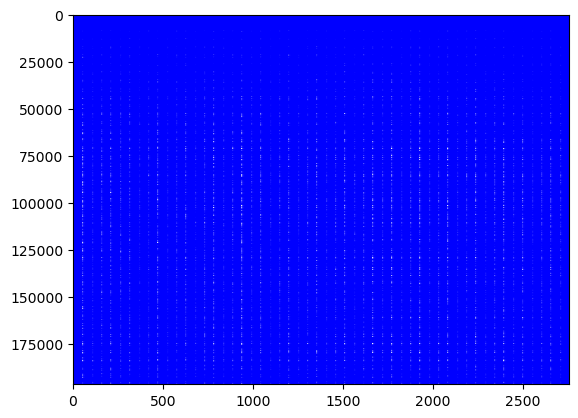

In [835]:
plt.imshow(mcb, interpolation='nearest', aspect='auto',cmap='bwr')

In [836]:
movc = mov-mcb.T.reshape(mov.shape)
movc.shape

(2756, 414, 475)

In [837]:
for d in trange(np.array(dfs).shape[0]):
    movc[jump*(d+1),...] = np.mean([movc[jump*(d+1)-1,...],movc[jump*(d+1)+1,...]],axis=0)

  0%|          | 0/52 [00:00<?, ?it/s]

In [838]:
print(fname)
print(fname[:-4]+r'_corr.tif')

\\nasquatch\data\2p\peter\grin_videos\PK49PL18_220701_101_full_wch0_aniso4_scale4AFS2PL4_toref100_wxy_nobg\movie_z10_tds3.tif
\\nasquatch\data\2p\peter\grin_videos\PK49PL18_220701_101_full_wch0_aniso4_scale4AFS2PL4_toref100_wxy_nobg\movie_z10_tds3_corr.tif


In [839]:
imwrite(fname[:-4]+r'_corr.tif',movc)

In [840]:
# supp video 8s
fname = r'\\nasquatch\data\2p\peter\grin_videos\PK49PL18_220701_101_full_wch0_aniso4_scale4AFS2PL4_toref100_wxy_nobg\movie_z10s_tds3.tif'
mov = imread(fname)
mov.shape

(2756, 414, 475)

In [841]:
mov.reshape(mov.shape[0],-1).shape

(2756, 196650)

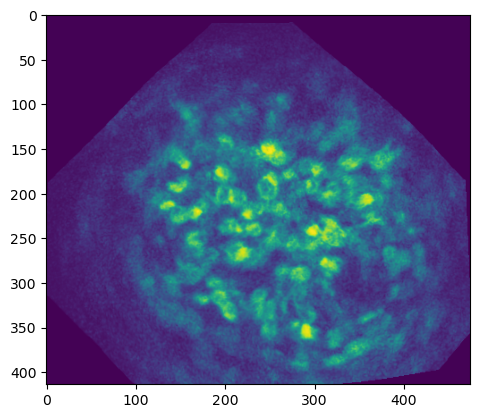

In [842]:
plt.imshow(mov[0,...])

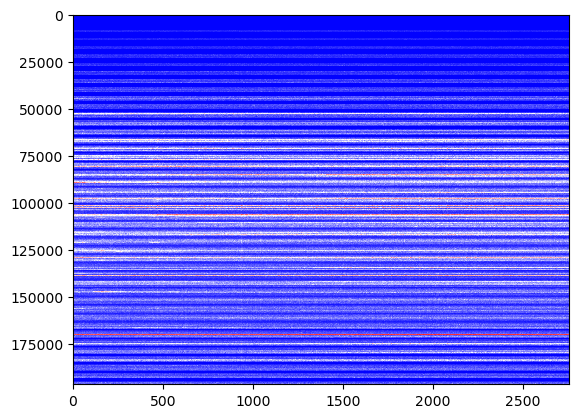

In [843]:
plt.imshow((mov.reshape(mov.shape[0],-1)).T, interpolation='nearest', aspect='auto',cmap='bwr')

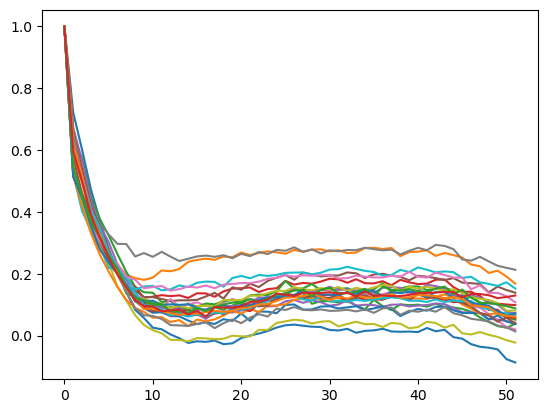

In [844]:
jump = 52
#for k in range(jump-2,jump*2,jump):
fit_range = np.array([0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23])
for k in list(jump+fit_range*jump):
    # Create histogram
    hist, bin_edges = np.histogram(((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))/(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)+0.4), bins=50)
    
    # Find the index of the bin with the highest frequency
    mode_index = np.argmax(hist)
    
    # Calculate the mode value
    mode_value = np.max([(bin_edges[mode_index] + bin_edges[mode_index + 1]) / 2,0.1])

    #mode_value = 1.5*mode_value
    
    plt.plot(np.mean(((mov.reshape(mov.shape[0],-1))[k:k+jump]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))[:,np.where((((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))/(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)+0.4))>mode_value)[0]]/((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))[np.where((((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))/(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)+0.4))>mode_value)[0]],1))

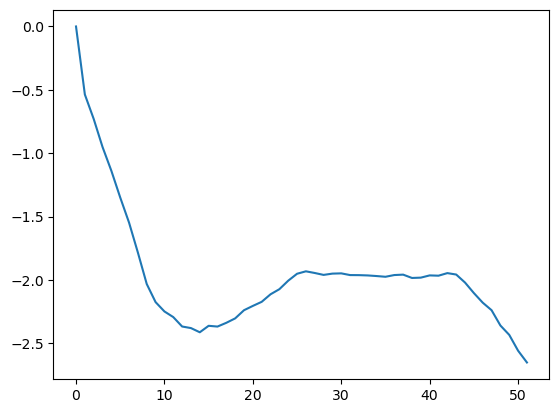

In [845]:
a = []
#jump = 3*mean_factor_slice_d[l]
#fit_range = fit_ranges_slice_d[l]
for k in list(jump+fit_range*jump):
    # Create histogram
    hist, bin_edges = np.histogram(((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))/(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)+0.4), bins=50)
    
    # Find the index of the bin with the highest frequency
    mode_index = np.argmax(hist)
    
    # Calculate the mode value
    mode_value = np.max([(bin_edges[mode_index] + bin_edges[mode_index + 1]) / 2,0.1])

    #mode_value = 1.5*mode_value
    
    a.append(np.mean(((mov.reshape(mov.shape[0],-1))[k:k+jump]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))[:,np.where((((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))/(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)+0.4))>mode_value)[0]]/((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))[np.where((((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))/(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)+0.4))>mode_value)[0]],1))
plt.plot(np.log(np.mean(np.array(a),0)))

[-0.22608184 -0.2067664 ]


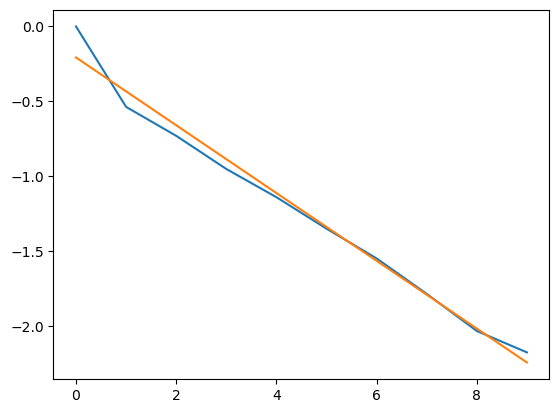

In [846]:
#a = []
#jump = 3*mean_factor_slice_d[l]
#fit_range = fit_ranges_slice_d[l]
#for k in list(jump-2+fit_range*jump):
#    a.append(np.mean(((cnmf_dicts_slice_d[l]['CY_m_raw'][np.argsort(cnmf_dicts_slice_d[l]['rises']),...].T)[k:k+jump]-(cnmf_dicts_slice_d[l]['CY_m_raw'][np.argsort(cnmf_dicts_slice_d[l]['rises']),...].T)[k])/((cnmf_dicts_slice_d[l]['CY_m_raw'][np.argsort(cnmf_dicts_slice_d[l]['rises']),...].T)[k+2]-np.mean((cnmf_dicts_slice_d[l]['CY_m_raw'][np.argsort(cnmf_dicts_slice_d[l]['rises']),...].T)[k-5:k],0)),1))
xa = np.arange(10)
ya = np.mean(np.array(a)[:,:10],0)
af = np.polyfit(xa, np.log(ya), 1)
print(af)
plt.plot(np.log(np.mean(np.array(a)[:,:10],0)))
plt.plot(af[0]*xa+af[1])

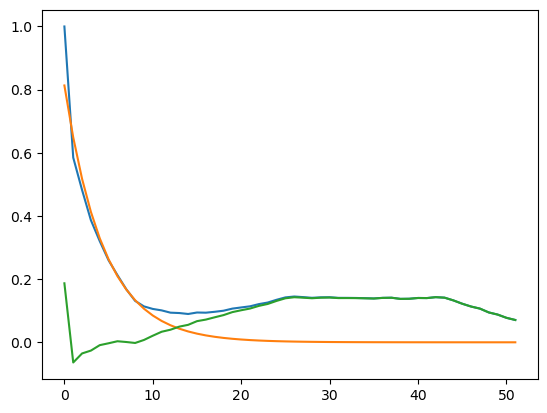

In [847]:
plt.plot(np.mean(np.array(a),0))
plt.plot(np.exp(af[0]*np.arange(52)+af[1]))
plt.plot(np.mean(np.array(a),0)-np.exp(af[0]*np.arange(52)+af[1]))

In [848]:
dfs = []
#jump = 3*mean_factor_slice_d[l]

for k in trange(jump,mov.reshape(mov.shape[0],-1).shape[0]-1,jump):
    # Create histogram
    #hist, bin_edges = np.histogram(((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))/(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)+0.4), bins=50)
    
    # Find the index of the bin with the highest frequency
    #mode_index = np.argmax(hist)
    
    # Calculate the mode value
    #mode_value = np.max([(bin_edges[mode_index] + bin_edges[mode_index + 1]) / 2,0.1])
        
    df = np.zeros(mov.reshape(mov.shape[0],-1).shape[1])
    df[np.where((mov.reshape(mov.shape[0],-1).T[:,k]-np.mean(mov.reshape(mov.shape[0],-1).T[:,k-5:k],1))>0)[0]] = (mov.reshape(mov.shape[0],-1).T[:,k]-np.mean(mov.reshape(mov.shape[0],-1).T[:,k-5:k],1))[np.where((mov.reshape(mov.shape[0],-1).T[:,k]-np.mean(mov.reshape(mov.shape[0],-1).T[:,k-5:k],1))>0)[0]]
    
    dfs.append(df)

mcb = np.zeros(mov.reshape(mov.shape[0],-1).T.shape)
for d in trange(np.array(dfs).shape[0]):
    #mcb[:,jump*(d+1):np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1,jump*(d+2)-1)] = mcb[:,jump*(d+1):np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1,jump*(d+2)-1)]+np.broadcast_to(np.exp(af[0]*np.arange(0,np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1-jump*(d+1),jump-1)))+np.exp(af2[0]*np.arange(0,np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1-jump*(d+1),jump-1))),(np.array(dfs).shape[1],) + (np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1-jump*(d+1),jump-1),))*np.array(dfs)[d,:][...,np.newaxis]
    mcb[:,jump*(d+1):np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1,jump*(d+2)-1)] = mcb[:,jump*(d+1):np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1,jump*(d+2)-1)]+np.broadcast_to(np.exp(af[0]*np.arange(0,np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1-jump*(d+1),jump-1))),(np.array(dfs).shape[1],) + (np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1-jump*(d+1),jump-1),))*np.array(dfs)[d,:][...,np.newaxis]

#cnmf_dicts_slice_d[l]['CY_m_raw_corr'] = cnmf_dicts_slice_d[l]['CY_m_raw']-cnmf_dicts_slice_d[l]['corrbase']

#cnmf_dicts_slice_d[l]['CY_m_raw_corr_sort'] = np.sort(cnmf_dicts_slice_d[l]['CY_m_raw_corr'],axis=1)
#cnmf_dicts_slice_d[l]['CY_m_raw_corr_b10'] = np.mean(cnmf_dicts_slice_d[l]['CY_m_raw_corr_sort'][:,:int(np.ceil(cnmf_dicts_slice_d[l]['CY_m_raw_corr_sort'].shape[1]/10))],axis=1) # bottom 10% mean
#cnmf_dicts_slice_d[l]['CY_m_raw_corr_t10'] = np.mean(cnmf_dicts_slice_d[l]['CY_m_raw_corr_sort'][:,-int(np.ceil(cnmf_dicts_slice_d[l]['CY_m_raw_corr_sort'].shape[1]/10)):],axis=1) # top 10% mean

#cnmf_dicts_slice_d[l]['CY_m_raw_corr_dff'] = ((cnmf_dicts_slice_d[l]['CY_m_raw_corr'].T-cnmf_dicts_slice_d[l]['CY_m_raw_corr_b10'])/(cnmf_dicts_slice_d[l]['CY_m_raw_corr_b10'])).T
#cnmf_dicts_slice_d[l]['CY_m_raw_corr_norm1'] = ((cnmf_dicts_slice_d[l]['CY_m_raw_corr'].T-cnmf_dicts_slice_d[l]['CY_m_raw_corr_b10'])/(cnmf_dicts_slice_d[l]['CY_m_raw_corr_t10']-cnmf_dicts_slice_d[l]['CY_m_raw_corr_b10'])).T

  0%|          | 0/52 [00:00<?, ?it/s]

  0%|          | 0/52 [00:00<?, ?it/s]

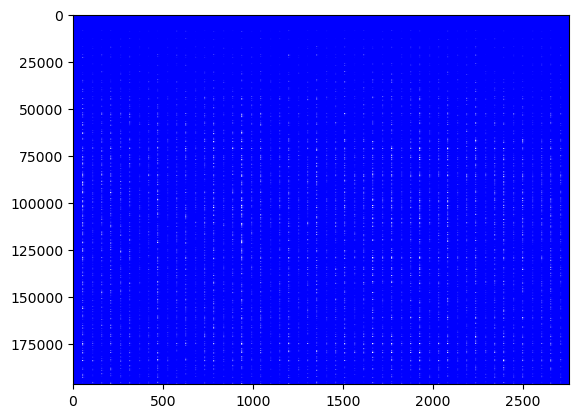

In [849]:
plt.imshow(mcb, interpolation='nearest', aspect='auto',cmap='bwr')

In [850]:
movc = mov-mcb.T.reshape(mov.shape)
movc.shape

(2756, 414, 475)

In [851]:
for d in trange(np.array(dfs).shape[0]):
    movc[jump*(d+1),...] = np.mean([movc[jump*(d+1)-1,...],movc[jump*(d+1)+1,...]],axis=0)

  0%|          | 0/52 [00:00<?, ?it/s]

In [852]:
print(fname)
print(fname[:-4]+r'_corr.tif')

\\nasquatch\data\2p\peter\grin_videos\PK49PL18_220701_101_full_wch0_aniso4_scale4AFS2PL4_toref100_wxy_nobg\movie_z10s_tds3.tif
\\nasquatch\data\2p\peter\grin_videos\PK49PL18_220701_101_full_wch0_aniso4_scale4AFS2PL4_toref100_wxy_nobg\movie_z10s_tds3_corr.tif


In [853]:
imwrite(fname[:-4]+r'_corr.tif',movc)

In [965]:
# supp video 3 dff/cleaned up f (do dff in fiji to a single baseline frame)
fname = r'\\nasquatch\data\2p\peter\grin_videos\PL28_230922_001_full_wch1_aniso4_scale4AFS2PL4_toref35_wxy_nobg\movie_z06_tds3_corr.tif'
mov = imread(fname)
mov.shape

(527, 433, 494)

In [966]:
mov.reshape(mov.shape[0],-1).shape

(527, 213902)

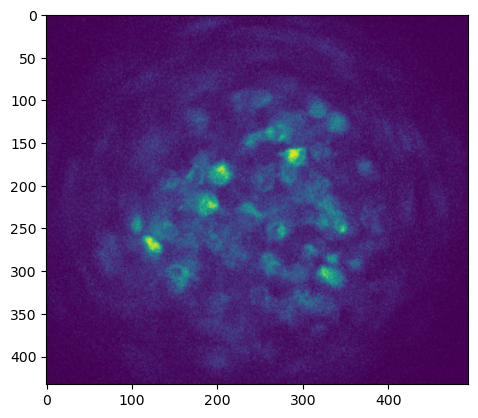

In [967]:
plt.imshow(mov[0,...])

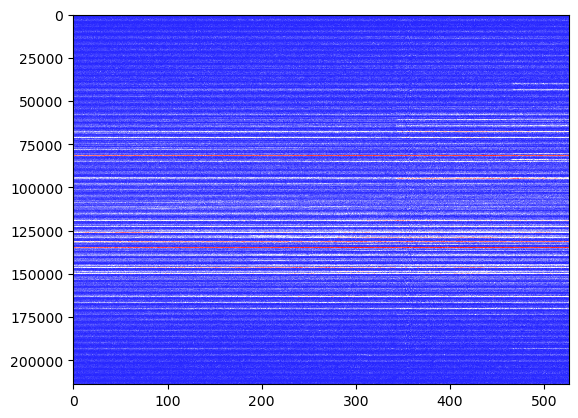

In [968]:
plt.imshow((mov.reshape(mov.shape[0],-1)).T, interpolation='nearest', aspect='auto',cmap='bwr')

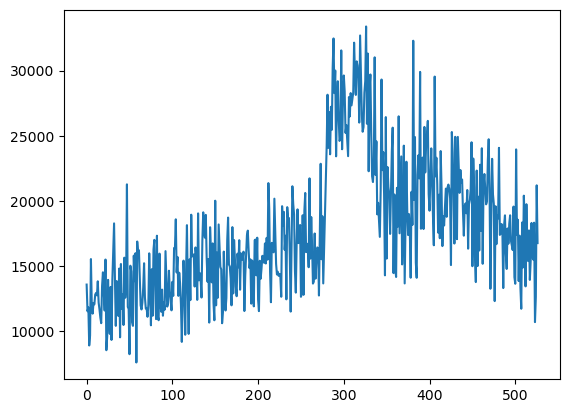

In [969]:
plt.plot((mov.reshape(mov.shape[0],-1))[:,66000])

In [970]:
C_sort = np.sort(sg.savgol_filter((mov.reshape(mov.shape[0],-1))[:,66000],31,1))
C_b10 = np.mean(C_sort[:int(np.ceil(C_sort.shape[0]/10))]) # bottom 10% mean
C_b10

12593.272716078302

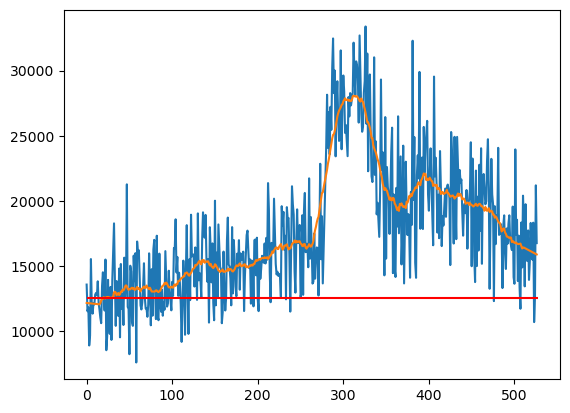

In [971]:
plt.plot((mov.reshape(mov.shape[0],-1))[:,66000])
plt.plot(sg.savgol_filter((mov.reshape(mov.shape[0],-1))[:,66000],31,1))
plt.hlines(y=C_b10,xmin=0,xmax=C_sort.shape[0],color='red')

In [972]:
%%time
pixo = (mov.reshape(mov.shape[0],-1)).T
pixomf = sg.savgol_filter(pixo,31,1,axis=1)

CPU times: total: 2.72 s
Wall time: 2.72 s


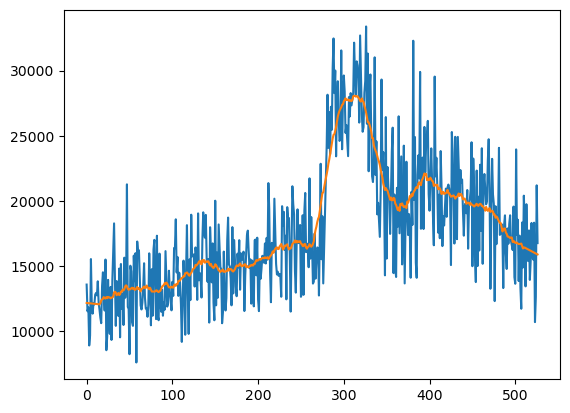

In [973]:
plt.plot(pixo[66000,...])
plt.plot(pixomf[66000,...])

CPU times: total: 4.38 s
Wall time: 4.44 s


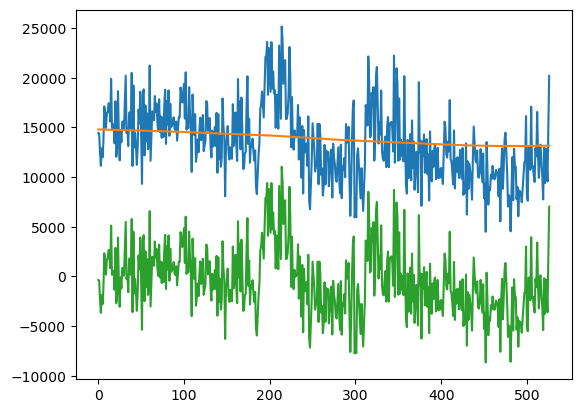

In [974]:
%%time
# bandpass pixels
sample_rate = 31/180
def lowpass(data: np.ndarray, cutoff: float, sample_rate: float, poles: int = 5):
    sos = sg.butter(poles, cutoff, 'lowpass', fs=sample_rate, output='sos')
    filtered_data = scipy.signal.sosfiltfilt(sos, data)
    return filtered_data
def highpass(data: np.ndarray, cutoff: float, sample_rate: float, poles: int = 5):
    sos = sg.butter(poles, cutoff, 'highpass', fs=sample_rate, output='sos')
    filtered_data = scipy.signal.sosfiltfilt(sos, data)
    return filtered_data
def bandpass(data: np.ndarray, cutoff, sample_rate: float, poles: int = 5):
    sos = sg.butter(poles, cutoff, 'bandpass', fs=sample_rate, output='sos')
    filtered_data = scipy.signal.sosfiltfilt(sos, data)
    return filtered_data

times = np.arange(pixo.shape[1])/sample_rate #[...,:936]

#filtered = lowpass(cnmf_dicts_invivo_ip[l]['CY_mov_matched_raw_corr_norm1'][hdbs_invivo.labels_==c,...][...,:2400], 1/600, sample_rate)
#filtered = cnmf_dicts_invivo_ip[l]['CY_mov_matched_raw_corr_norm1'][hdbs_invivo.labels_==c,...][...,:2400]-highpass(cnmf_dicts_invivo_ip[l]['CY_mov_matched_raw_corr_norm1'][hdbs_invivo.labels_==c,...][...,:2400], 1/600, sample_rate,1)
#filtered =  bandpass(CY_m_matched_raw_corr_norm1[...,:3000], [1/8000,1/50], sample_rate,1)
#filteredu = bandpass(pixomf_dff, [1/6000,1/50], sample_rate,1) #[np.argsort(hdbs_invivo.labels_),...]
filteredu = lowpass(pixo, 1/(3*pixo.shape[1]/sample_rate), sample_rate,1) #[np.argsort(hdbs_invivo.labels_),...]
#filtered2 = bandpass(CY_m2_matched_raw_gr_corr_norm1[...,:2000], [1/4000,1/50], sample_rate,1) #[np.argsort(hdbs_invivo.labels_),...]

#from matplotlib import colors
#divnorm=colors.TwoSlopeNorm(vcenter=0)
#filteredu_sort = np.sort(filteredu,axis=1)
#filteredu_b10 = np.mean(filteredu_sort[:,:int(np.ceil(filteredu_sort.shape[1]/10))],axis=1) #[[x for x in np.arange(21).tolist() if x not in oxt_rm],...]
#filteredu_t10 = np.mean(filteredu_sort[:,-int(np.ceil(filteredu_sort.shape[1]/10)):],axis=1)
#filteredu_norm1 = ((filteredu.T-filteredu_b10)/(filteredu_t10-filteredu_b10)).T
#plt.imshow(filteredu_norm1[np.argsort(cnmf_dicts_invivo_ip[l]['row_clusts_f']),...],interpolation='nearest',aspect='auto',cmap='bwr')#,vmax=1)
plt.plot(pixo[245*494+215,...])
plt.plot(filteredu[245*494+215,...])
plt.plot((pixo-filteredu)[245*494+215,...])

#filtered2_sort = np.sort(filtered2,axis=1)
#filtered2_b10 = np.mean(filtered2_sort[:,:int(np.ceil(filtered2_sort.shape[1]/10))],axis=1) #[[x for x in np.arange(21).tolist() if x not in oxt_rm],...]
#filtered2_t10 = np.mean(filtered2_sort[:,-int(np.ceil(filtered2_sort.shape[1]/10)):],axis=1)
#filtered2_norm1 = ((filtered2.T-filtered2_b10)/(filtered2_t10-filtered2_b10)).T
#plt.imshow(filtered2_norm1[np.argsort(hdbs_slice_w.labels_),...],interpolation='nearest',aspect='auto',cmap='bwr',vmax=1)

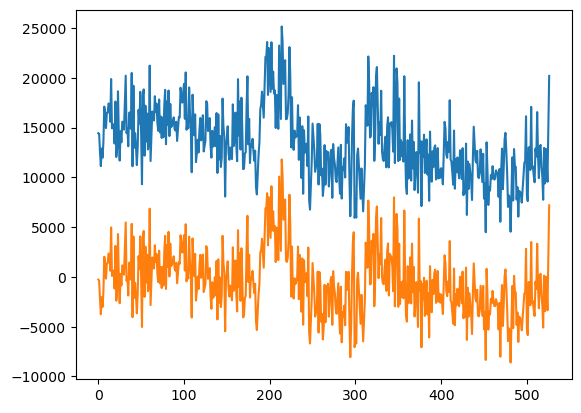

In [975]:
filteredu2 = bandpass((pixo-filteredu), [1/190,1/170], sample_rate,1) #[np.argsort(hdbs_invivo.labels_),...]

plt.plot(pixo[245*494+215,...])
plt.plot((pixo-filteredu-filteredu2)[245*494+215,...])

In [976]:
pixoc = pixo-filteredu-filteredu2
pixocmf = sg.savgol_filter(pixoc,31,1,axis=1)

pixomf_sort = np.sort(pixomf,axis=1)
pixocmf_sort = np.sort(pixocmf,axis=1)

pixomf_b10 = np.mean(pixomf_sort[:,:int(np.ceil(pixomf_sort.shape[1]/10))],axis=1) # bottom 10% mean
pixocmf_b10 = np.mean(pixocmf_sort[:,:int(np.ceil(pixocmf_sort.shape[1]/10))],axis=1) # bottom 10% mean

(array([128939.,  43642.,  18677.,  10309.,   5086.,   3303.,   1893.,
          1149.,    679.,    225.]),
 array([ 2643.43265078,  8722.3830601 , 14801.33346941, 20880.28387873,
        26959.23428804, 33038.18469736, 39117.13510667, 45196.08551599,
        51275.0359253 , 57353.98633462, 63432.93674393]),
 <BarContainer object of 10 artists>)

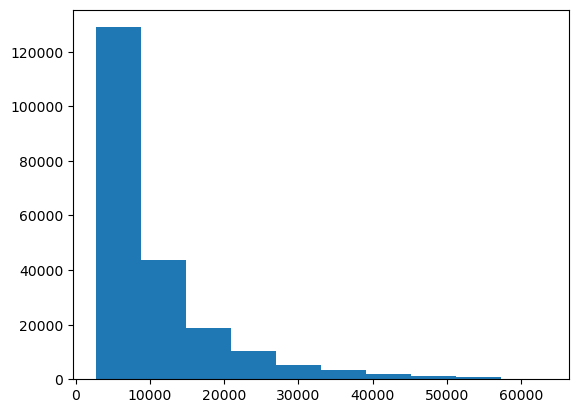

In [977]:
plt.hist(np.max(pixomf,axis=1))

(array([1.56588e+05, 3.87800e+04, 1.17180e+04, 3.83800e+03, 1.54100e+03,
        6.59000e+02, 3.65000e+02, 2.05000e+02, 9.60000e+01, 1.12000e+02]),
 array([ 2259.86122126,  7629.66116704, 12999.46111282, 18369.2610586 ,
        23739.06100437, 29108.86095015, 34478.66089593, 39848.46084171,
        45218.26078748, 50588.06073326, 55957.86067904]),
 <BarContainer object of 10 artists>)

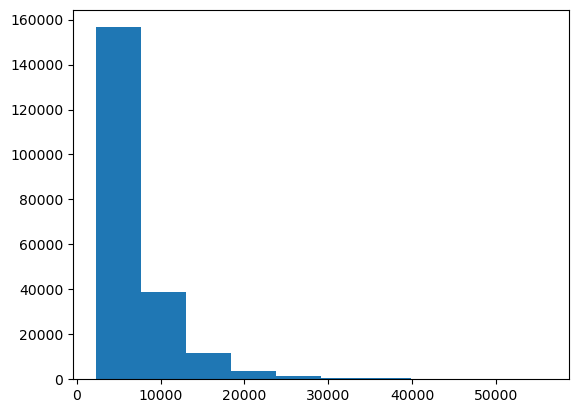

In [978]:
plt.hist(pixomf_b10)

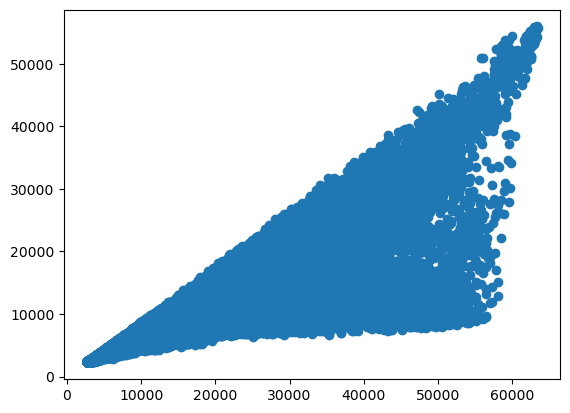

In [979]:
plt.scatter(np.max(pixomf,axis=1),pixomf_b10)

(array([6.6766e+04, 9.1616e+04, 3.4219e+04, 1.2926e+04, 4.7600e+03,
        1.8910e+03, 1.0090e+03, 4.6000e+02, 2.0700e+02, 4.8000e+01]),
 array([ 1080.36525612,  5526.84226631,  9973.31927651, 14419.7962867 ,
        18866.2732969 , 23312.75030709, 27759.22731728, 32205.70432748,
        36652.18133767, 41098.65834786, 45545.13535806]),
 <BarContainer object of 10 artists>)

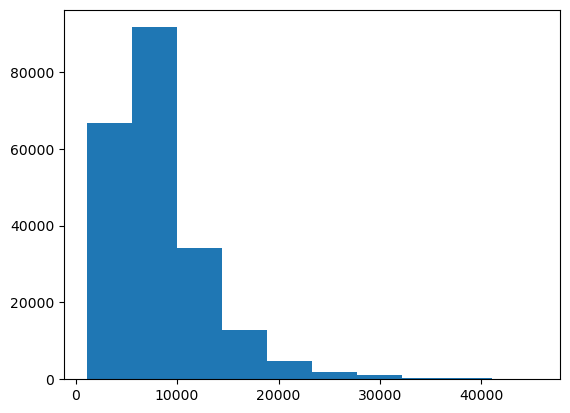

In [980]:
plt.hist(np.max((pixoc.T-pixocmf_b10),axis=0))

In [981]:
np.where(np.max((pixoc.T-pixocmf_b10),axis=0)<10000)[0].shape

(158720,)

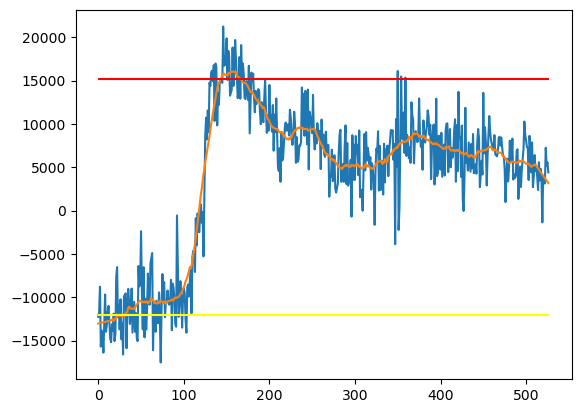

In [982]:
plt.plot(pixoc[273*494+318,...])
plt.plot(pixocmf[273*494+318,...])
plt.hlines(y=pixomf_b10[273*494+318],xmin=0,xmax=pixoc.shape[1],color='red')
plt.hlines(y=pixocmf_b10[273*494+318],xmin=0,xmax=pixoc.shape[1],color='yellow')

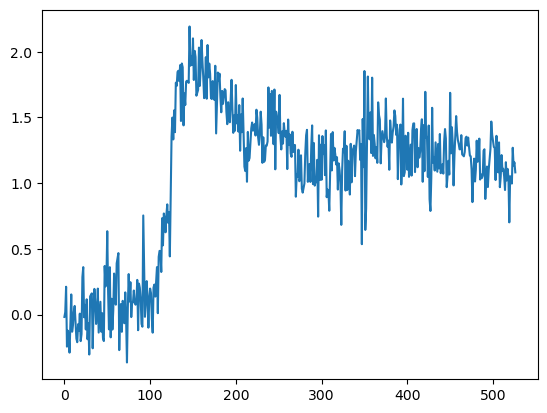

In [983]:
pixocdff = (pixoc.T-pixocmf_b10)/pixomf_b10
plt.plot(pixocdff[...,273*494+318])

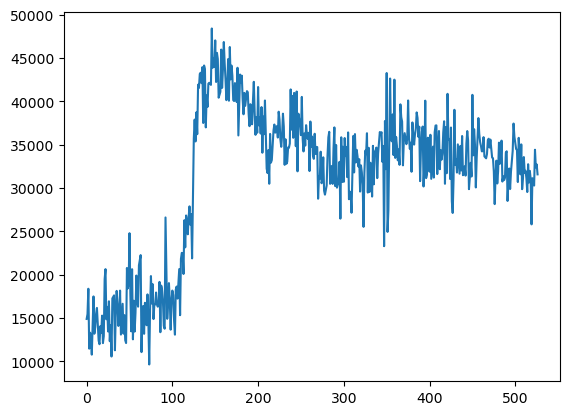

In [984]:
pixocf = (pixoc.T-pixocmf_b10)+pixomf_b10
plt.plot(pixocf[...,273*494+318])

In [985]:
pixocdff.T.shape

(213902, 527)

In [986]:
movc = pixocdff.reshape(mov.shape)
movc.shape

(527, 433, 494)

In [987]:
pixocdff2 = deepcopy(pixocdff)
pixocdff2[...,np.where(np.max((pixoc.T-pixocmf_b10),axis=0)<5000)[0]] = np.zeros((pixocdff.shape[0],np.where(np.max((pixoc.T-pixocmf_b10),axis=0)<5000)[0].shape[0]))

In [988]:
movc2 = pixocdff2.reshape(mov.shape)
movc2.shape

(527, 433, 494)

In [989]:
movc3 = pixocf.reshape(mov.shape)
movc3.shape

(527, 433, 494)

In [990]:
print(fname)
print(fname[:-4]+r'_dff.tif')

\\nasquatch\data\2p\peter\grin_videos\PL28_230922_001_full_wch1_aniso4_scale4AFS2PL4_toref35_wxy_nobg\movie_z06_tds3_corr.tif
\\nasquatch\data\2p\peter\grin_videos\PL28_230922_001_full_wch1_aniso4_scale4AFS2PL4_toref35_wxy_nobg\movie_z06_tds3_corr_dff.tif


In [991]:
imwrite(fname[:-4]+r'_dff.tif',movc)

In [992]:
imwrite(fname[:-4]+r'_dff2.tif',movc2)

In [993]:
imwrite(fname[:-4]+r'_f.tif',movc3)

In [994]:
# supp video 4 dff/cleaned up f (do dff in fiji to a single baseline frame)
fname = r'\\nasquatch\data\2p\peter\grin_videos\PL28_230922_201_full_wch1_aniso4_scale4AFS2PL4_toref19_wxy_nobg\movie_z06_tds3_corr.tif'
mov = imread(fname)
mov.shape

(403, 438, 500)

In [995]:
mov.reshape(mov.shape[0],-1).shape

(403, 219000)

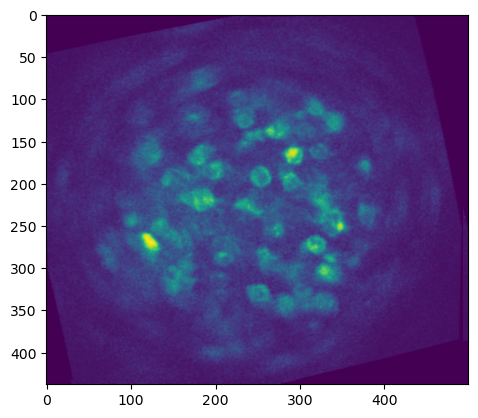

In [996]:
plt.imshow(mov[0,...])

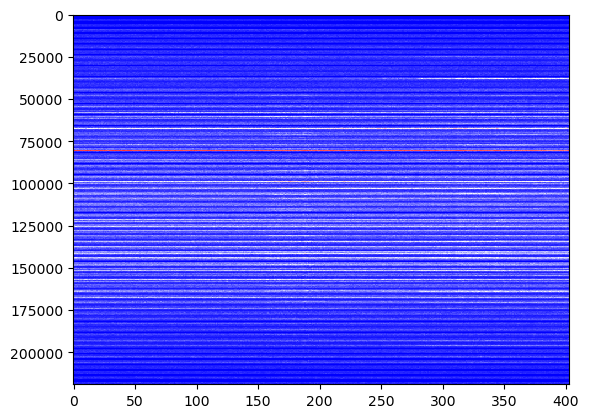

In [997]:
plt.imshow((mov.reshape(mov.shape[0],-1)).T, interpolation='nearest', aspect='auto',cmap='bwr')

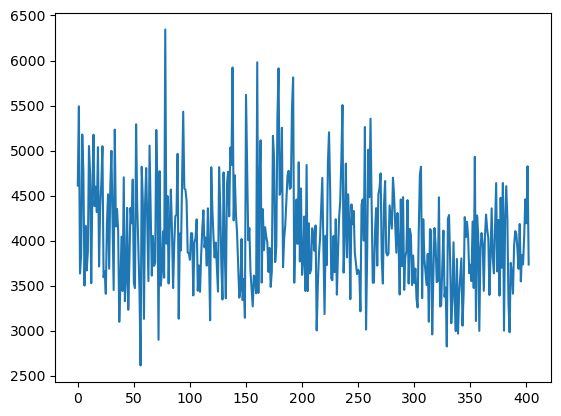

In [998]:
plt.plot((mov.reshape(mov.shape[0],-1))[:,66000])

In [999]:
C_sort = np.sort(sg.savgol_filter((mov.reshape(mov.shape[0],-1))[:,66000],31,1))
C_b10 = np.mean(C_sort[:int(np.ceil(C_sort.shape[0]/10))]) # bottom 10% mean
C_b10

3686.512323863666

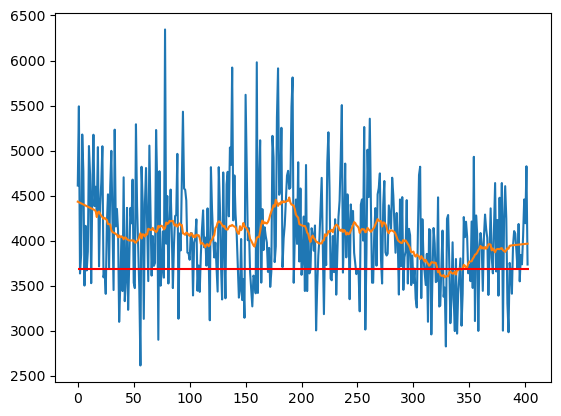

In [1000]:
plt.plot((mov.reshape(mov.shape[0],-1))[:,66000])
plt.plot(sg.savgol_filter((mov.reshape(mov.shape[0],-1))[:,66000],31,1))
plt.hlines(y=C_b10,xmin=0,xmax=C_sort.shape[0],color='red')

In [1001]:
%%time
pixo = (mov.reshape(mov.shape[0],-1)).T
pixomf = sg.savgol_filter(pixo,31,1,axis=1)

CPU times: total: 2.25 s
Wall time: 2.25 s


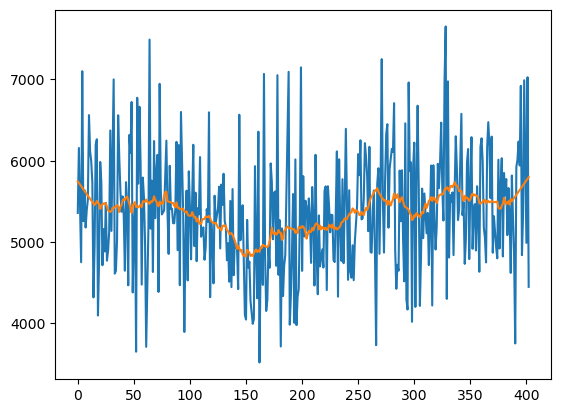

In [1002]:
plt.plot(pixo[104000,...])
plt.plot(pixomf[104000,...])

CPU times: total: 3.11 s
Wall time: 3.12 s


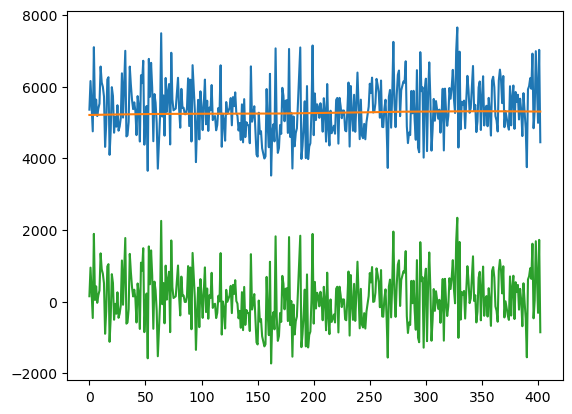

In [1003]:
%%time
# bandpass pixels
sample_rate = 31/180
def lowpass(data: np.ndarray, cutoff: float, sample_rate: float, poles: int = 5):
    sos = sg.butter(poles, cutoff, 'lowpass', fs=sample_rate, output='sos')
    filtered_data = scipy.signal.sosfiltfilt(sos, data)
    return filtered_data
def highpass(data: np.ndarray, cutoff: float, sample_rate: float, poles: int = 5):
    sos = sg.butter(poles, cutoff, 'highpass', fs=sample_rate, output='sos')
    filtered_data = scipy.signal.sosfiltfilt(sos, data)
    return filtered_data
def bandpass(data: np.ndarray, cutoff, sample_rate: float, poles: int = 5):
    sos = sg.butter(poles, cutoff, 'bandpass', fs=sample_rate, output='sos')
    filtered_data = scipy.signal.sosfiltfilt(sos, data)
    return filtered_data

times = np.arange(pixo.shape[1])/sample_rate #[...,:936]

#filtered = lowpass(cnmf_dicts_invivo_ip[l]['CY_mov_matched_raw_corr_norm1'][hdbs_invivo.labels_==c,...][...,:2400], 1/600, sample_rate)
#filtered = cnmf_dicts_invivo_ip[l]['CY_mov_matched_raw_corr_norm1'][hdbs_invivo.labels_==c,...][...,:2400]-highpass(cnmf_dicts_invivo_ip[l]['CY_mov_matched_raw_corr_norm1'][hdbs_invivo.labels_==c,...][...,:2400], 1/600, sample_rate,1)
#filtered =  bandpass(CY_m_matched_raw_corr_norm1[...,:3000], [1/8000,1/50], sample_rate,1)
#filteredu = bandpass(pixomf_dff, [1/6000,1/50], sample_rate,1) #[np.argsort(hdbs_invivo.labels_),...]
filteredu = lowpass(pixo, 1/(3*pixo.shape[1]/sample_rate), sample_rate,1) #[np.argsort(hdbs_invivo.labels_),...]
#filtered2 = bandpass(CY_m2_matched_raw_gr_corr_norm1[...,:2000], [1/4000,1/50], sample_rate,1) #[np.argsort(hdbs_invivo.labels_),...]

#from matplotlib import colors
#divnorm=colors.TwoSlopeNorm(vcenter=0)
#filteredu_sort = np.sort(filteredu,axis=1)
#filteredu_b10 = np.mean(filteredu_sort[:,:int(np.ceil(filteredu_sort.shape[1]/10))],axis=1) #[[x for x in np.arange(21).tolist() if x not in oxt_rm],...]
#filteredu_t10 = np.mean(filteredu_sort[:,-int(np.ceil(filteredu_sort.shape[1]/10)):],axis=1)
#filteredu_norm1 = ((filteredu.T-filteredu_b10)/(filteredu_t10-filteredu_b10)).T
#plt.imshow(filteredu_norm1[np.argsort(cnmf_dicts_invivo_ip[l]['row_clusts_f']),...],interpolation='nearest',aspect='auto',cmap='bwr')#,vmax=1)
plt.plot(pixo[104000,...])
plt.plot(filteredu[104000,...])
plt.plot((pixo-filteredu)[104000,...])

#filtered2_sort = np.sort(filtered2,axis=1)
#filtered2_b10 = np.mean(filtered2_sort[:,:int(np.ceil(filtered2_sort.shape[1]/10))],axis=1) #[[x for x in np.arange(21).tolist() if x not in oxt_rm],...]
#filtered2_t10 = np.mean(filtered2_sort[:,-int(np.ceil(filtered2_sort.shape[1]/10)):],axis=1)
#filtered2_norm1 = ((filtered2.T-filtered2_b10)/(filtered2_t10-filtered2_b10)).T
#plt.imshow(filtered2_norm1[np.argsort(hdbs_slice_w.labels_),...],interpolation='nearest',aspect='auto',cmap='bwr',vmax=1)

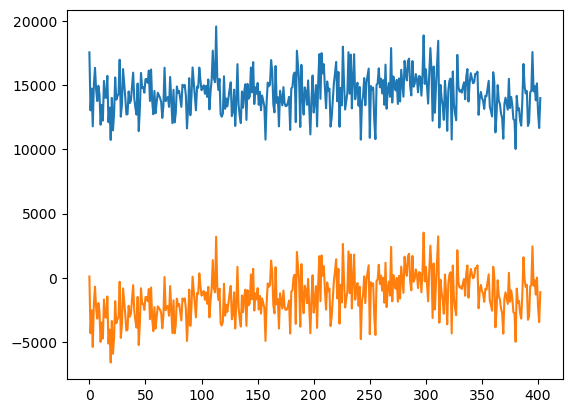

In [1004]:
filteredu2 = bandpass((pixo-filteredu), [1/190,1/170], sample_rate,1) #[np.argsort(hdbs_invivo.labels_),...]

plt.plot(pixo[245*494+215,...])
plt.plot((pixo-filteredu-filteredu2)[245*494+215,...])

In [1005]:
pixoc = pixo-filteredu-filteredu2
pixocmf = sg.savgol_filter(pixoc,31,1,axis=1)

pixomf_sort = np.sort(pixomf,axis=1)
pixocmf_sort = np.sort(pixocmf,axis=1)

pixomf_b10 = np.mean(pixomf_sort[:,:int(np.ceil(pixomf_sort.shape[1]/10))],axis=1) # bottom 10% mean
pixocmf_b10 = np.mean(pixocmf_sort[:,:int(np.ceil(pixocmf_sort.shape[1]/10))],axis=1) # bottom 10% mean

(array([91246., 73492., 27481., 14463.,  6826.,  3270.,  1212.,   636.,
          230.,   144.]),
 array([    0.        ,  6457.21081246, 12914.42162493, 19371.63243739,
        25828.84324986, 32286.05406232, 38743.26487479, 45200.47568725,
        51657.68649972, 58114.89731218, 64572.10812465]),
 <BarContainer object of 10 artists>)

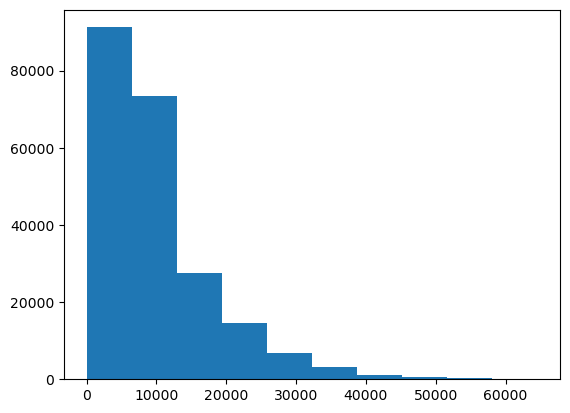

In [1006]:
plt.hist(np.max(pixomf,axis=1))

(array([1.07519e+05, 7.19980e+04, 2.63060e+04, 7.97200e+03, 3.37000e+03,
        1.07700e+03, 4.03000e+02, 1.65000e+02, 9.30000e+01, 9.70000e+01]),
 array([    0.        ,  6124.20612625, 12248.41225251, 18372.61837876,
        24496.82450501, 30621.03063126, 36745.23675752, 42869.44288377,
        48993.64901002, 55117.85513627, 61242.06126253]),
 <BarContainer object of 10 artists>)

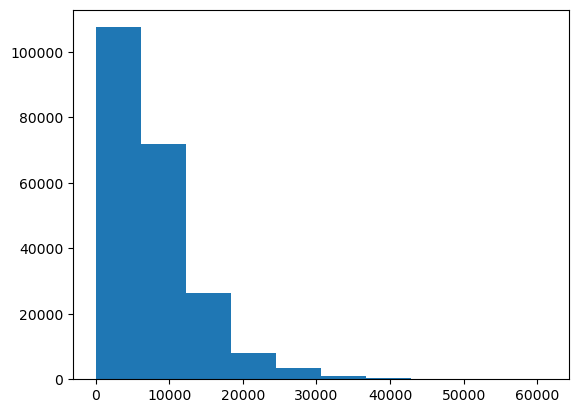

In [1007]:
plt.hist(pixomf_b10)

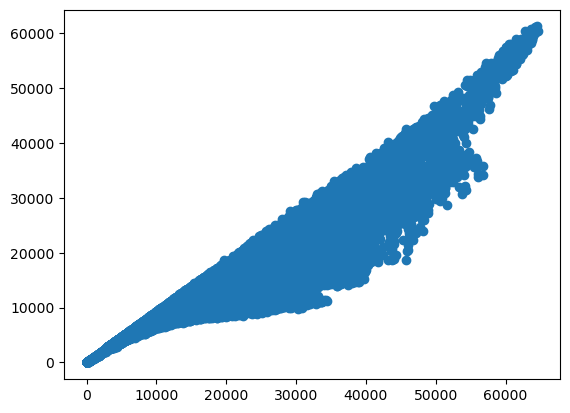

In [1008]:
plt.scatter(np.max(pixomf,axis=1),pixomf_b10)

(array([6.7288e+04, 9.5218e+04, 3.4554e+04, 1.4102e+04, 4.9840e+03,
        1.9110e+03, 6.1500e+02, 2.4200e+02, 7.3000e+01, 1.3000e+01]),
 array([    0.        ,  3076.44802526,  6152.89605053,  9229.34407579,
        12305.79210105, 15382.24012632, 18458.68815158, 21535.13617685,
        24611.58420211, 27688.03222737, 30764.48025264]),
 <BarContainer object of 10 artists>)

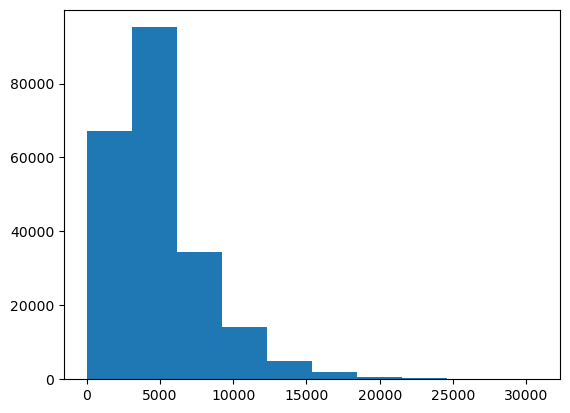

In [1009]:
plt.hist(np.max((pixoc.T-pixocmf_b10),axis=0))

In [1010]:
np.where(np.max((pixoc.T-pixocmf_b10),axis=0)<10000)[0].shape

(201867,)

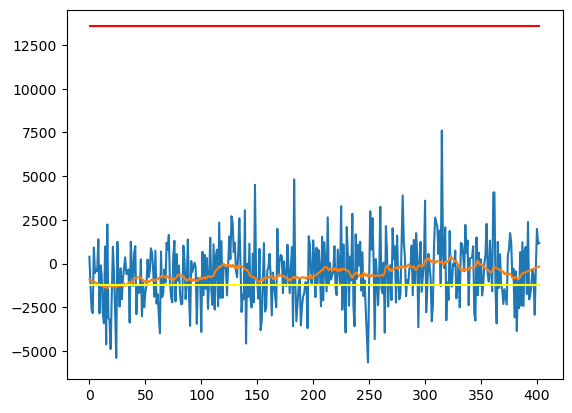

In [1011]:
plt.plot(pixoc[273*494+318,...])
plt.plot(pixocmf[273*494+318,...])
plt.hlines(y=pixomf_b10[273*494+318],xmin=0,xmax=pixoc.shape[1],color='red')
plt.hlines(y=pixocmf_b10[273*494+318],xmin=0,xmax=pixoc.shape[1],color='yellow')

C:\Users\pkalugin\AppData\Local\Temp\7\ipykernel_24584\3425924152.py:1: RuntimeWarning: invalid value encountered in divide
  pixocdff = (pixoc.T-pixocmf_b10)/pixomf_b10


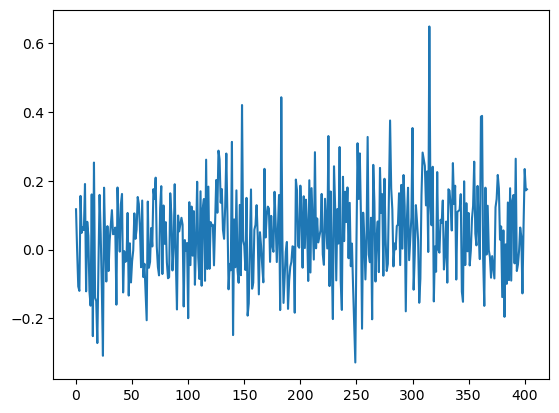

In [1012]:
pixocdff = (pixoc.T-pixocmf_b10)/pixomf_b10
plt.plot(pixocdff[...,273*494+318])

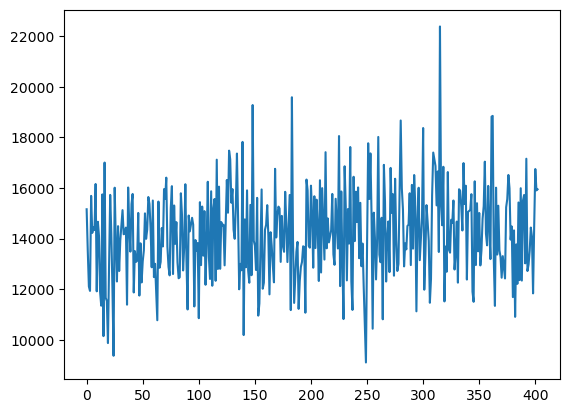

In [1013]:
pixocf = (pixoc.T-pixocmf_b10)+pixomf_b10
plt.plot(pixocf[...,273*494+318])

In [1014]:
pixocdff.T.shape

(219000, 403)

In [1015]:
movc = pixocdff.reshape(mov.shape)
movc.shape

(403, 438, 500)

In [1016]:
pixocdff2 = deepcopy(pixocdff)
pixocdff2[...,np.where(np.max((pixoc.T-pixocmf_b10),axis=0)<5000)[0]] = np.zeros((pixocdff.shape[0],np.where(np.max((pixoc.T-pixocmf_b10),axis=0)<5000)[0].shape[0]))

In [1017]:
movc2 = pixocdff2.reshape(mov.shape)
movc2.shape

(403, 438, 500)

In [1018]:
movc3 = pixocf.reshape(mov.shape)
movc3.shape

(403, 438, 500)

In [1019]:
print(fname)
print(fname[:-4]+r'_dff.tif')

\\nasquatch\data\2p\peter\grin_videos\PL28_230922_201_full_wch1_aniso4_scale4AFS2PL4_toref19_wxy_nobg\movie_z06_tds3_corr.tif
\\nasquatch\data\2p\peter\grin_videos\PL28_230922_201_full_wch1_aniso4_scale4AFS2PL4_toref19_wxy_nobg\movie_z06_tds3_corr_dff.tif


In [1020]:
imwrite(fname[:-4]+r'_dff.tif',movc)

In [1021]:
imwrite(fname[:-4]+r'_dff2.tif',movc2)

In [1022]:
imwrite(fname[:-4]+r'_f.tif',movc3)

In [1023]:
# supp video 5 dff/cleaned up f (do dff in fiji to a single baseline frame)
fname = r'\\nasquatch\data\2p\peter\grin_videos\SL1PL56_230829_001_noartifact_wch1_aniso4_scale4AFS2PL4_toref28_wxy_nobg\movie_z09_tds3.tif'
mov = imread(fname)
mov.shape

(980, 443, 500)

In [1024]:
mov.reshape(mov.shape[0],-1).shape

(980, 221500)

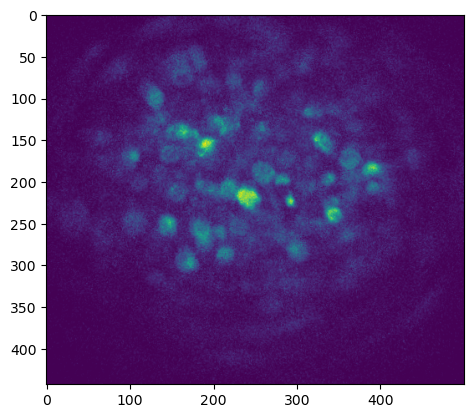

In [1025]:
plt.imshow(mov[0,...])

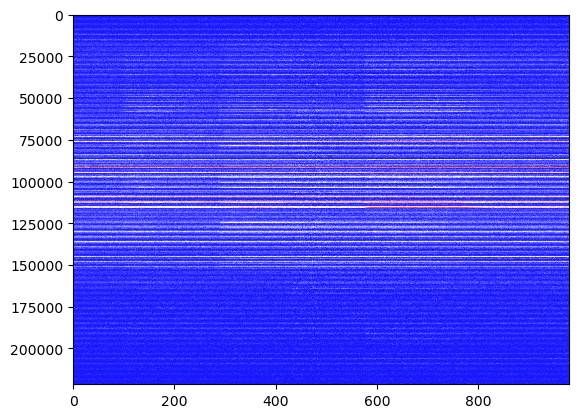

In [1026]:
plt.imshow((mov.reshape(mov.shape[0],-1)).T, interpolation='nearest', aspect='auto',cmap='bwr')

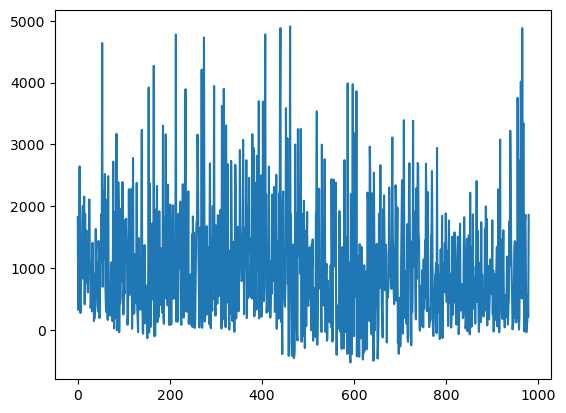

In [1027]:
plt.plot((mov.reshape(mov.shape[0],-1))[:,66000])

In [1028]:
C_sort = np.sort(sg.savgol_filter((mov.reshape(mov.shape[0],-1))[:,66000],31,1))
C_b10 = np.mean(C_sort[:int(np.ceil(C_sort.shape[0]/10))]) # bottom 10% mean
C_b10

736.4753

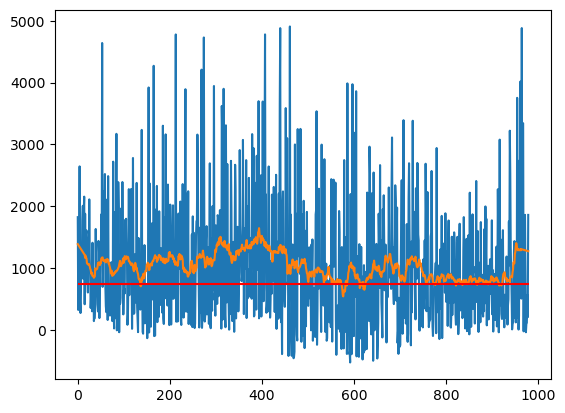

In [1029]:
plt.plot((mov.reshape(mov.shape[0],-1))[:,66000])
plt.plot(sg.savgol_filter((mov.reshape(mov.shape[0],-1))[:,66000],31,1))
plt.hlines(y=C_b10,xmin=0,xmax=C_sort.shape[0],color='red')

In [1030]:
%%time
pixo = (mov.reshape(mov.shape[0],-1)).T
pixomf = sg.savgol_filter(pixo,31,1,axis=1)

CPU times: total: 4.31 s
Wall time: 4.32 s


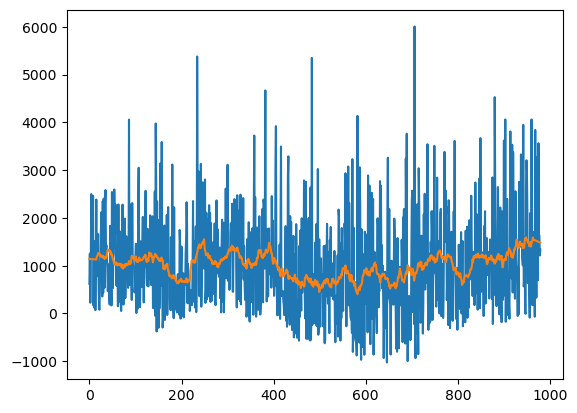

In [1031]:
plt.plot(pixo[104500,...])
plt.plot(pixomf[104500,...])

CPU times: total: 7.5 s
Wall time: 7.57 s


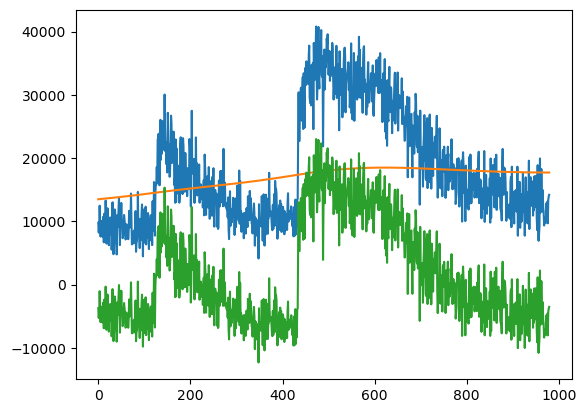

In [1032]:
%%time
# bandpass pixels
sample_rate = 31/180
def lowpass(data: np.ndarray, cutoff: float, sample_rate: float, poles: int = 5):
    sos = sg.butter(poles, cutoff, 'lowpass', fs=sample_rate, output='sos')
    filtered_data = scipy.signal.sosfiltfilt(sos, data)
    return filtered_data
def highpass(data: np.ndarray, cutoff: float, sample_rate: float, poles: int = 5):
    sos = sg.butter(poles, cutoff, 'highpass', fs=sample_rate, output='sos')
    filtered_data = scipy.signal.sosfiltfilt(sos, data)
    return filtered_data
def bandpass(data: np.ndarray, cutoff, sample_rate: float, poles: int = 5):
    sos = sg.butter(poles, cutoff, 'bandpass', fs=sample_rate, output='sos')
    filtered_data = scipy.signal.sosfiltfilt(sos, data)
    return filtered_data

times = np.arange(pixo.shape[1])/sample_rate #[...,:936]

#filtered = lowpass(cnmf_dicts_invivo_ip[l]['CY_mov_matched_raw_corr_norm1'][hdbs_invivo.labels_==c,...][...,:2400], 1/600, sample_rate)
#filtered = cnmf_dicts_invivo_ip[l]['CY_mov_matched_raw_corr_norm1'][hdbs_invivo.labels_==c,...][...,:2400]-highpass(cnmf_dicts_invivo_ip[l]['CY_mov_matched_raw_corr_norm1'][hdbs_invivo.labels_==c,...][...,:2400], 1/600, sample_rate,1)
#filtered =  bandpass(CY_m_matched_raw_corr_norm1[...,:3000], [1/8000,1/50], sample_rate,1)
#filteredu = bandpass(pixomf_dff, [1/6000,1/50], sample_rate,1) #[np.argsort(hdbs_invivo.labels_),...]
filteredu = lowpass(pixo, 1/(3*pixo.shape[1]/sample_rate), sample_rate,1) #[np.argsort(hdbs_invivo.labels_),...]
#filtered2 = bandpass(CY_m2_matched_raw_gr_corr_norm1[...,:2000], [1/4000,1/50], sample_rate,1) #[np.argsort(hdbs_invivo.labels_),...]

#from matplotlib import colors
#divnorm=colors.TwoSlopeNorm(vcenter=0)
#filteredu_sort = np.sort(filteredu,axis=1)
#filteredu_b10 = np.mean(filteredu_sort[:,:int(np.ceil(filteredu_sort.shape[1]/10))],axis=1) #[[x for x in np.arange(21).tolist() if x not in oxt_rm],...]
#filteredu_t10 = np.mean(filteredu_sort[:,-int(np.ceil(filteredu_sort.shape[1]/10)):],axis=1)
#filteredu_norm1 = ((filteredu.T-filteredu_b10)/(filteredu_t10-filteredu_b10)).T
#plt.imshow(filteredu_norm1[np.argsort(cnmf_dicts_invivo_ip[l]['row_clusts_f']),...],interpolation='nearest',aspect='auto',cmap='bwr')#,vmax=1)
plt.plot(pixo[261*500+255,...])
plt.plot(filteredu[261*500+255,...])
plt.plot((pixo-filteredu)[261*500+255,...])

#filtered2_sort = np.sort(filtered2,axis=1)
#filtered2_b10 = np.mean(filtered2_sort[:,:int(np.ceil(filtered2_sort.shape[1]/10))],axis=1) #[[x for x in np.arange(21).tolist() if x not in oxt_rm],...]
#filtered2_t10 = np.mean(filtered2_sort[:,-int(np.ceil(filtered2_sort.shape[1]/10)):],axis=1)
#filtered2_norm1 = ((filtered2.T-filtered2_b10)/(filtered2_t10-filtered2_b10)).T
#plt.imshow(filtered2_norm1[np.argsort(hdbs_slice_w.labels_),...],interpolation='nearest',aspect='auto',cmap='bwr',vmax=1)

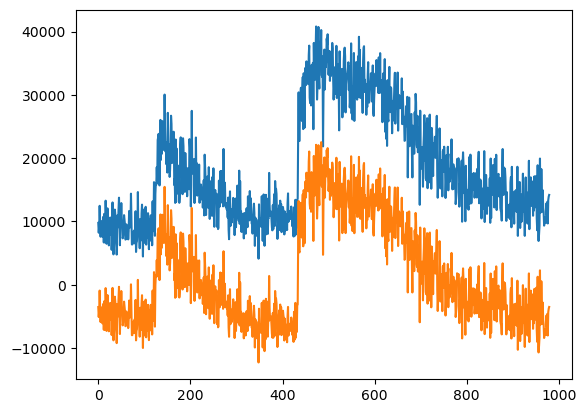

In [1033]:
filteredu2 = bandpass((pixo-filteredu), [1/190,1/170], sample_rate,1) #[np.argsort(hdbs_invivo.labels_),...]

plt.plot(pixo[261*500+255,...])
plt.plot((pixo-filteredu-filteredu2)[261*500+255,...])

In [1034]:
pixoc = pixo-filteredu#-filteredu2
pixocmf = sg.savgol_filter(pixoc,31,1,axis=1)

pixomf_sort = np.sort(pixomf,axis=1)
pixocmf_sort = np.sort(pixocmf,axis=1)

pixomf_b10 = np.mean(pixomf_sort[:,:int(np.ceil(pixomf_sort.shape[1]/10))],axis=1) # bottom 10% mean
pixocmf_b10 = np.mean(pixocmf_sort[:,:int(np.ceil(pixocmf_sort.shape[1]/10))],axis=1) # bottom 10% mean

(array([140288.,  44558.,  18704.,   8658.,   4514.,   2194.,   1200.,
           690.,    534.,    160.]),
 array([  137.34059143,  5962.32080078, 11787.30175781, 17612.28125   ,
        23437.26171875, 29262.2421875 , 35087.22265625, 40912.203125  ,
        46737.18359375, 52562.1640625 , 58387.14453125]),
 <BarContainer object of 10 artists>)

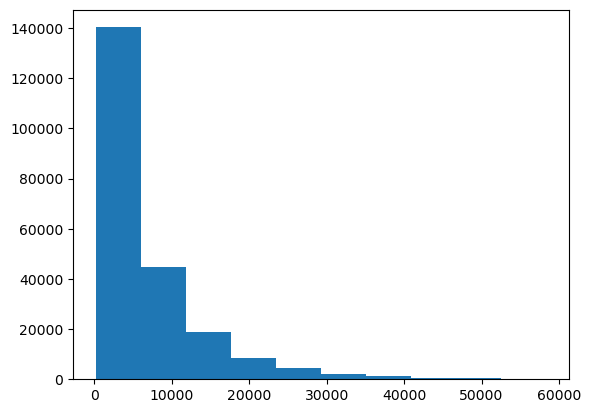

In [1035]:
plt.hist(np.max(pixomf,axis=1))

(array([1.62319e+05, 4.17640e+04, 9.47800e+03, 4.05000e+03, 1.98200e+03,
        8.00000e+02, 4.18000e+02, 3.02000e+02, 3.01000e+02, 8.60000e+01]),
 array([ -157.03544617,  4957.16259766, 10071.36035156, 15185.55859375,
        20299.7578125 , 25413.95507812, 30528.15234375, 35642.3515625 ,
        40756.55078125, 45870.74609375, 50984.9453125 ]),
 <BarContainer object of 10 artists>)

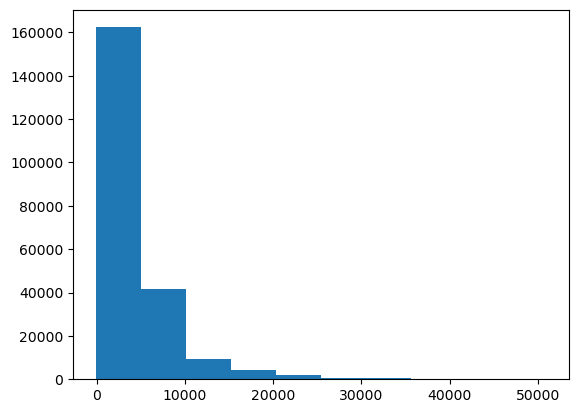

In [1036]:
plt.hist(pixomf_b10)

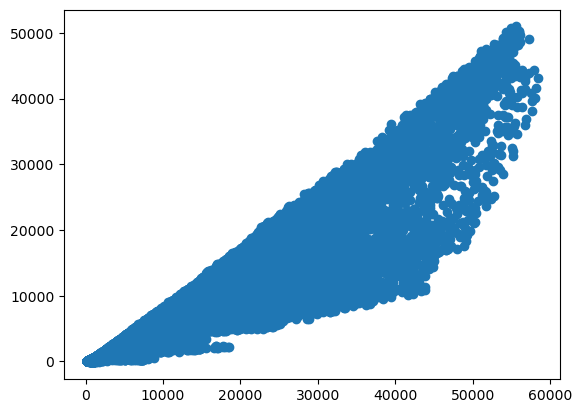

In [1037]:
plt.scatter(np.max(pixomf,axis=1),pixomf_b10)

(array([3.4903e+04, 9.5780e+04, 5.5602e+04, 2.2964e+04, 7.3200e+03,
        2.9710e+03, 1.3380e+03, 5.0600e+02, 1.0700e+02, 9.0000e+00]),
 array([ 1235.19125472,  4880.06858066,  8524.94590659, 12169.82323253,
        15814.70055846, 19459.5778844 , 23104.45521034, 26749.33253627,
        30394.20986221, 34039.08718814, 37683.96451408]),
 <BarContainer object of 10 artists>)

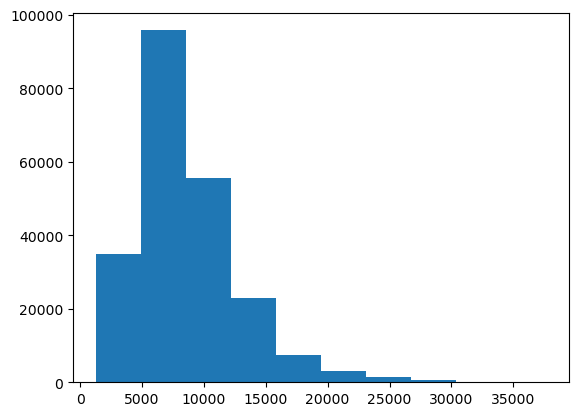

In [1038]:
plt.hist(np.max((pixoc.T-pixocmf_b10),axis=0))

In [1039]:
np.where(np.max((pixoc.T-pixocmf_b10),axis=0)<10000)[0].shape

(158709,)

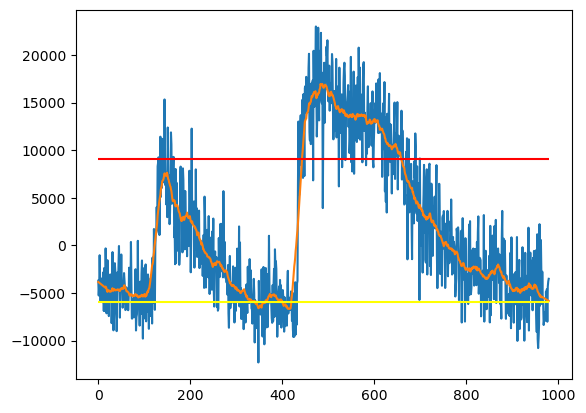

In [1040]:
plt.plot(pixoc[261*500+255,...])
plt.plot(pixocmf[261*500+255,...])
plt.hlines(y=pixomf_b10[261*500+255],xmin=0,xmax=pixoc.shape[1],color='red')
plt.hlines(y=pixocmf_b10[261*500+255],xmin=0,xmax=pixoc.shape[1],color='yellow')

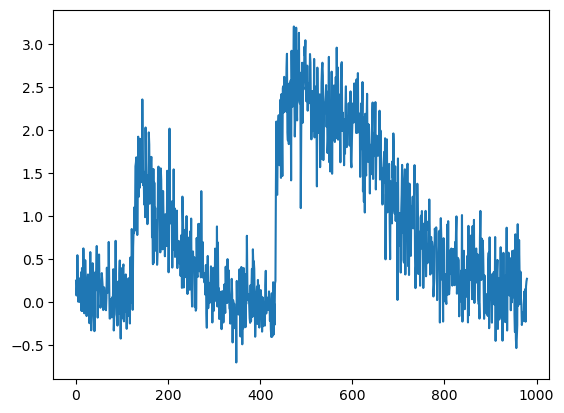

In [1041]:
pixocdff = (pixoc.T-pixocmf_b10)/pixomf_b10
plt.plot(pixocdff[...,261*500+255])

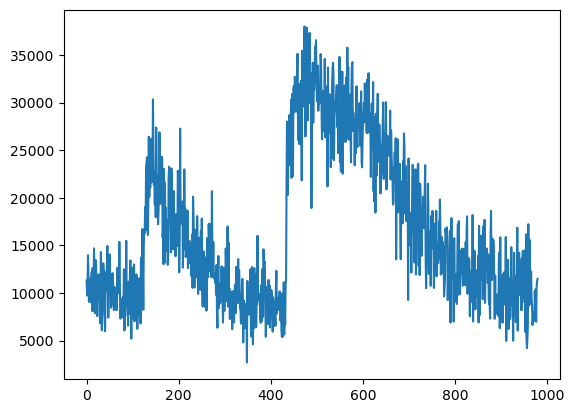

In [1042]:
pixocf = (pixoc.T-pixocmf_b10)+pixomf_b10
plt.plot(pixocf[...,261*500+255])

In [1043]:
pixocdff.T.shape

(221500, 980)

In [1044]:
movc = pixocdff.reshape(mov.shape)
movc.shape

(980, 443, 500)

In [1045]:
pixocdff2 = deepcopy(pixocdff)
pixocdff2[...,np.where(np.max((pixoc.T-pixocmf_b10),axis=0)<5000)[0]] = np.zeros((pixocdff.shape[0],np.where(np.max((pixoc.T-pixocmf_b10),axis=0)<5000)[0].shape[0]))

In [1046]:
movc2 = pixocdff2.reshape(mov.shape)
movc2.shape

(980, 443, 500)

In [1047]:
movc3 = pixocf.reshape(mov.shape)
movc3.shape

(980, 443, 500)

In [1048]:
print(fname)
print(fname[:-4]+r'_dff.tif')

\\nasquatch\data\2p\peter\grin_videos\SL1PL56_230829_001_noartifact_wch1_aniso4_scale4AFS2PL4_toref28_wxy_nobg\movie_z09_tds3.tif
\\nasquatch\data\2p\peter\grin_videos\SL1PL56_230829_001_noartifact_wch1_aniso4_scale4AFS2PL4_toref28_wxy_nobg\movie_z09_tds3_dff.tif


In [1049]:
imwrite(fname[:-4]+r'_dff.tif',movc)

In [1050]:
imwrite(fname[:-4]+r'_dff2.tif',movc2)

In [1051]:
imwrite(fname[:-4]+r'_f.tif',movc3)

In [1086]:
# supp video 6 dff/cleaned up f (do dff in fiji to a single baseline frame)
fname = r'\\nasquatch\data\2p\peter\grin_videos\PL56_230829_001_full_wch1_aniso4_scale4AFS2PL4_toref52_wxy_nobg\movie_z09_tds3_corr.tif'
mov = imread(fname)
mov.shape

(1820, 423, 482)

In [1087]:
mov = mov[:884,...]

In [1088]:
mov.reshape(mov.shape[0],-1).shape

(884, 203886)

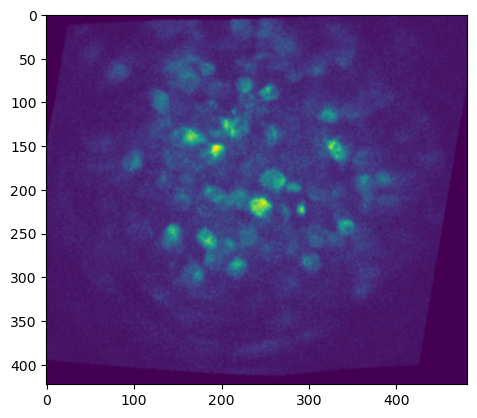

In [1089]:
plt.imshow(mov[0,...])

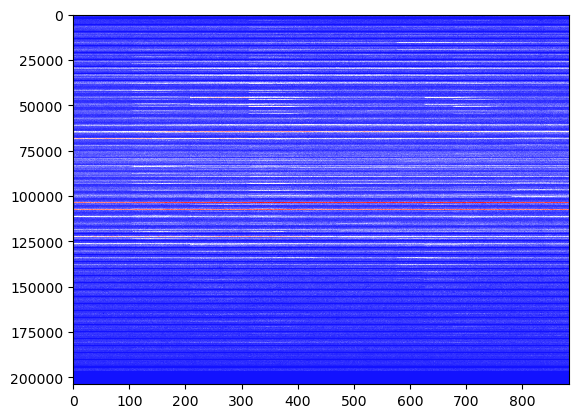

In [1090]:
plt.imshow((mov.reshape(mov.shape[0],-1)).T, interpolation='nearest', aspect='auto',cmap='bwr')

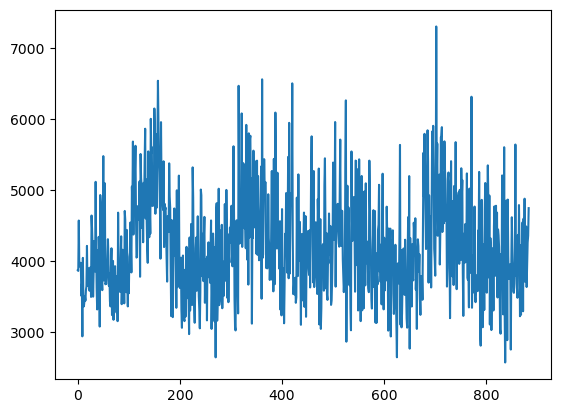

In [1091]:
plt.plot((mov.reshape(mov.shape[0],-1))[:,66000])

In [1092]:
C_sort = np.sort(sg.savgol_filter((mov.reshape(mov.shape[0],-1))[:,66000],31,1))
C_b10 = np.mean(C_sort[:int(np.ceil(C_sort.shape[0]/10))]) # bottom 10% mean
C_b10

3787.0291037490374

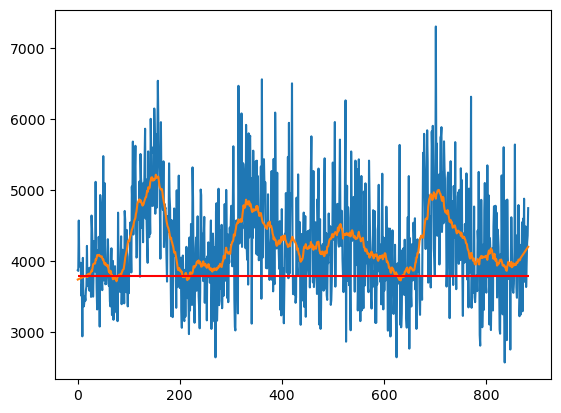

In [1093]:
plt.plot((mov.reshape(mov.shape[0],-1))[:,66000])
plt.plot(sg.savgol_filter((mov.reshape(mov.shape[0],-1))[:,66000],31,1))
plt.hlines(y=C_b10,xmin=0,xmax=C_sort.shape[0],color='red')

In [1094]:
%%time
pixo = (mov.reshape(mov.shape[0],-1)).T
pixomf = sg.savgol_filter(pixo,31,1,axis=1)

CPU times: total: 4.56 s
Wall time: 4.56 s


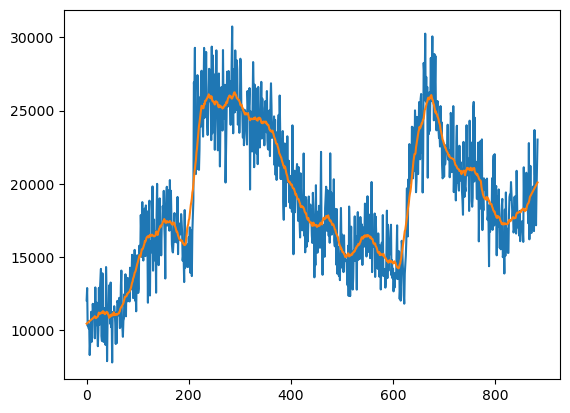

In [1095]:
plt.plot(pixo[104000,...])
plt.plot(pixomf[104000,...])

CPU times: total: 7.12 s
Wall time: 7.13 s


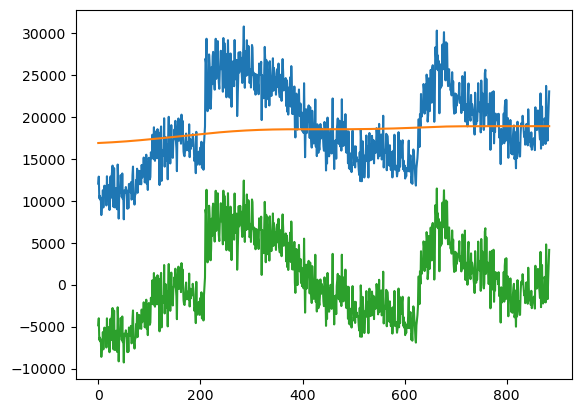

In [1096]:
%%time
# bandpass pixels
sample_rate = 31/180
def lowpass(data: np.ndarray, cutoff: float, sample_rate: float, poles: int = 5):
    sos = sg.butter(poles, cutoff, 'lowpass', fs=sample_rate, output='sos')
    filtered_data = scipy.signal.sosfiltfilt(sos, data)
    return filtered_data
def highpass(data: np.ndarray, cutoff: float, sample_rate: float, poles: int = 5):
    sos = sg.butter(poles, cutoff, 'highpass', fs=sample_rate, output='sos')
    filtered_data = scipy.signal.sosfiltfilt(sos, data)
    return filtered_data
def bandpass(data: np.ndarray, cutoff, sample_rate: float, poles: int = 5):
    sos = sg.butter(poles, cutoff, 'bandpass', fs=sample_rate, output='sos')
    filtered_data = scipy.signal.sosfiltfilt(sos, data)
    return filtered_data

times = np.arange(pixo.shape[1])/sample_rate #[...,:936]

#filtered = lowpass(cnmf_dicts_invivo_ip[l]['CY_mov_matched_raw_corr_norm1'][hdbs_invivo.labels_==c,...][...,:2400], 1/600, sample_rate)
#filtered = cnmf_dicts_invivo_ip[l]['CY_mov_matched_raw_corr_norm1'][hdbs_invivo.labels_==c,...][...,:2400]-highpass(cnmf_dicts_invivo_ip[l]['CY_mov_matched_raw_corr_norm1'][hdbs_invivo.labels_==c,...][...,:2400], 1/600, sample_rate,1)
#filtered =  bandpass(CY_m_matched_raw_corr_norm1[...,:3000], [1/8000,1/50], sample_rate,1)
#filteredu = bandpass(pixomf_dff, [1/6000,1/50], sample_rate,1) #[np.argsort(hdbs_invivo.labels_),...]
filteredu = lowpass(pixo, 1/(3*pixo.shape[1]/sample_rate), sample_rate,1) #[np.argsort(hdbs_invivo.labels_),...]
#filtered2 = bandpass(CY_m2_matched_raw_gr_corr_norm1[...,:2000], [1/4000,1/50], sample_rate,1) #[np.argsort(hdbs_invivo.labels_),...]

#from matplotlib import colors
#divnorm=colors.TwoSlopeNorm(vcenter=0)
#filteredu_sort = np.sort(filteredu,axis=1)
#filteredu_b10 = np.mean(filteredu_sort[:,:int(np.ceil(filteredu_sort.shape[1]/10))],axis=1) #[[x for x in np.arange(21).tolist() if x not in oxt_rm],...]
#filteredu_t10 = np.mean(filteredu_sort[:,-int(np.ceil(filteredu_sort.shape[1]/10)):],axis=1)
#filteredu_norm1 = ((filteredu.T-filteredu_b10)/(filteredu_t10-filteredu_b10)).T
#plt.imshow(filteredu_norm1[np.argsort(cnmf_dicts_invivo_ip[l]['row_clusts_f']),...],interpolation='nearest',aspect='auto',cmap='bwr')#,vmax=1)
plt.plot(pixo[104000,...])
plt.plot(filteredu[104000,...])
plt.plot((pixo-filteredu)[104000,...])

#filtered2_sort = np.sort(filtered2,axis=1)
#filtered2_b10 = np.mean(filtered2_sort[:,:int(np.ceil(filtered2_sort.shape[1]/10))],axis=1) #[[x for x in np.arange(21).tolist() if x not in oxt_rm],...]
#filtered2_t10 = np.mean(filtered2_sort[:,-int(np.ceil(filtered2_sort.shape[1]/10)):],axis=1)
#filtered2_norm1 = ((filtered2.T-filtered2_b10)/(filtered2_t10-filtered2_b10)).T
#plt.imshow(filtered2_norm1[np.argsort(hdbs_slice_w.labels_),...],interpolation='nearest',aspect='auto',cmap='bwr',vmax=1)

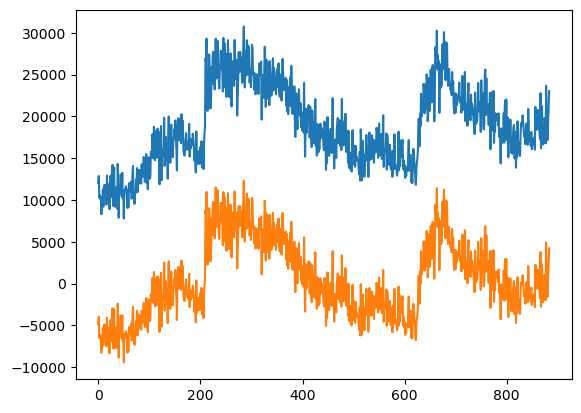

In [1097]:
filteredu2 = bandpass((pixo-filteredu), [1/190,1/170], sample_rate,1) #[np.argsort(hdbs_invivo.labels_),...]

plt.plot(pixo[104000,...])
plt.plot((pixo-filteredu-filteredu2)[104000,...])

In [1098]:
pixoc = pixo-filteredu-filteredu2
pixocmf = sg.savgol_filter(pixoc,31,1,axis=1)

pixomf_sort = np.sort(pixomf,axis=1)
pixocmf_sort = np.sort(pixocmf,axis=1)

pixomf_b10 = np.mean(pixomf_sort[:,:int(np.ceil(pixomf_sort.shape[1]/10))],axis=1) # bottom 10% mean
pixocmf_b10 = np.mean(pixocmf_sort[:,:int(np.ceil(pixocmf_sort.shape[1]/10))],axis=1) # bottom 10% mean

(array([92518., 63574., 22399., 11284.,  6691.,  3708.,  1874.,   938.,
          620.,   280.]),
 array([    0.        ,  6002.36691452, 12004.73382905, 18007.10074357,
        24009.46765809, 30011.83457262, 36014.20148714, 42016.56840167,
        48018.93531619, 54021.30223071, 60023.66914524]),
 <BarContainer object of 10 artists>)

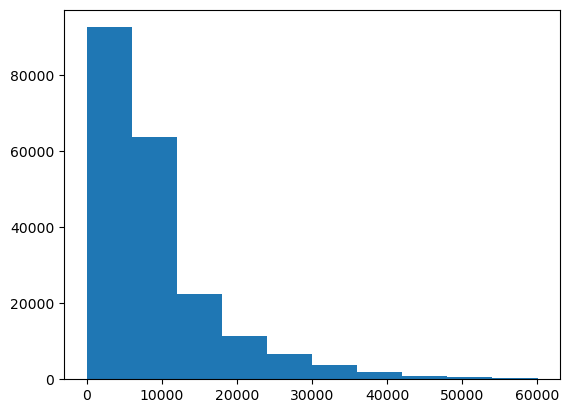

In [1099]:
plt.hist(np.max(pixomf,axis=1))

(array([1.20379e+05, 6.38150e+04, 1.32200e+04, 3.92200e+03, 1.30200e+03,
        5.14000e+02, 3.58000e+02, 1.91000e+02, 1.34000e+02, 5.10000e+01]),
 array([    0.        ,  5461.05572485, 10922.1114497 , 16383.16717455,
        21844.2228994 , 27305.27862425, 32766.3343491 , 38227.39007395,
        43688.4457988 , 49149.50152365, 54610.5572485 ]),
 <BarContainer object of 10 artists>)

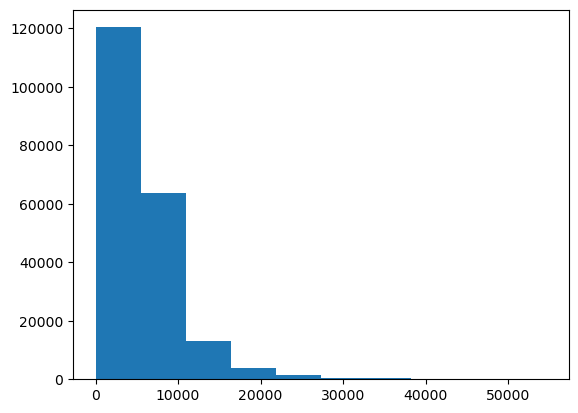

In [1100]:
plt.hist(pixomf_b10)

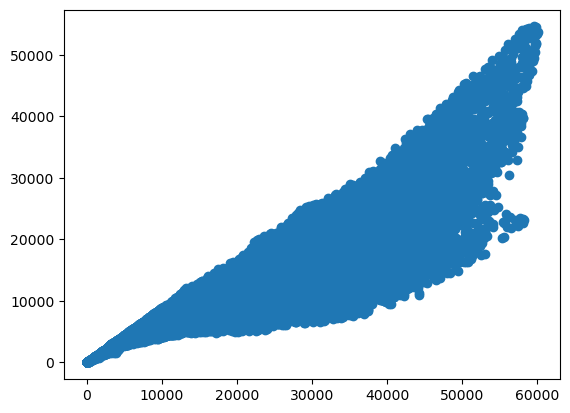

In [1101]:
plt.scatter(np.max(pixomf,axis=1),pixomf_b10)

(array([7.9891e+04, 7.7033e+04, 2.3638e+04, 1.1363e+04, 6.5760e+03,
        3.1670e+03, 1.5480e+03, 5.1100e+02, 1.2900e+02, 3.0000e+01]),
 array([    0.        ,  3733.85774819,  7467.71549637, 11201.57324456,
        14935.43099275, 18669.28874093, 22403.14648912, 26137.0042373 ,
        29870.86198549, 33604.71973368, 37338.57748186]),
 <BarContainer object of 10 artists>)

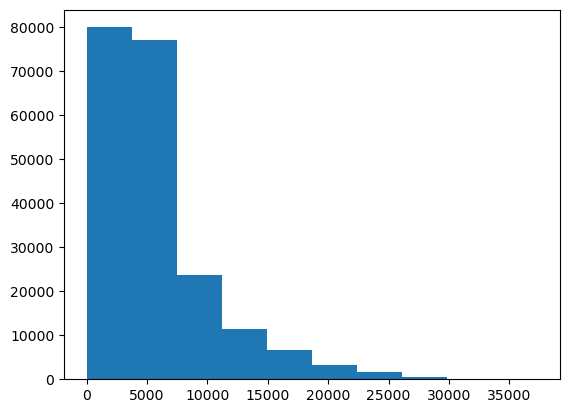

In [1102]:
plt.hist(np.max((pixoc.T-pixocmf_b10),axis=0))

In [1103]:
np.where(np.max((pixoc.T-pixocmf_b10),axis=0)<10000)[0].shape

(175073,)

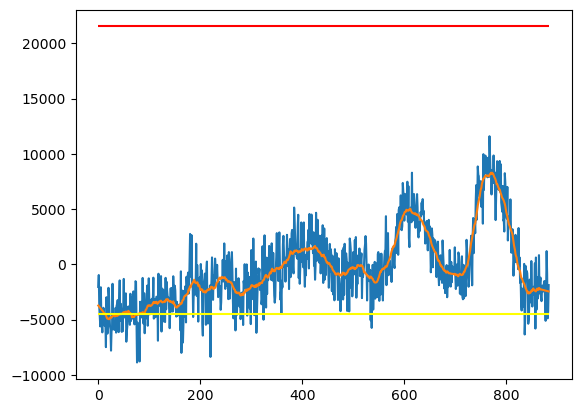

In [1104]:
plt.plot(pixoc[273*494+318,...])
plt.plot(pixocmf[273*494+318,...])
plt.hlines(y=pixomf_b10[273*494+318],xmin=0,xmax=pixoc.shape[1],color='red')
plt.hlines(y=pixocmf_b10[273*494+318],xmin=0,xmax=pixoc.shape[1],color='yellow')

C:\Users\pkalugin\AppData\Local\Temp\7\ipykernel_24584\3425924152.py:1: RuntimeWarning: invalid value encountered in divide
  pixocdff = (pixoc.T-pixocmf_b10)/pixomf_b10


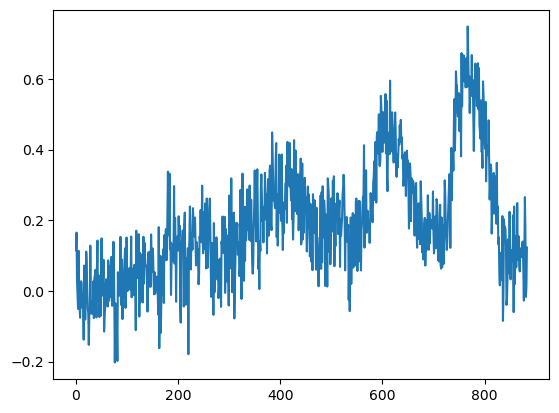

In [1105]:
pixocdff = (pixoc.T-pixocmf_b10)/pixomf_b10
plt.plot(pixocdff[...,273*494+318])

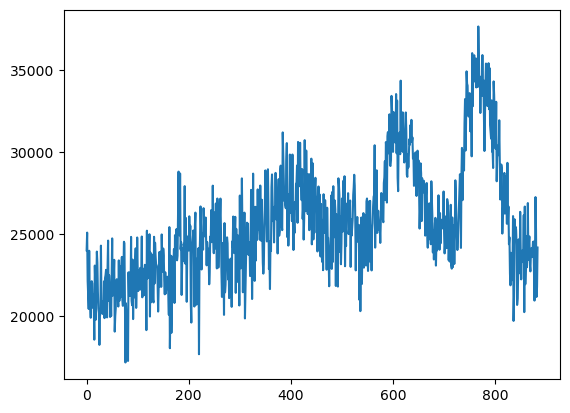

In [1106]:
pixocf = (pixoc.T-pixocmf_b10)+pixomf_b10
plt.plot(pixocf[...,273*494+318])

In [1107]:
pixocdff.T.shape

(203886, 884)

In [1108]:
movc = pixocdff.reshape(mov.shape)
movc.shape

(884, 423, 482)

In [1109]:
pixocdff2 = deepcopy(pixocdff)
pixocdff2[...,np.where(np.max((pixoc.T-pixocmf_b10),axis=0)<5000)[0]] = np.zeros((pixocdff.shape[0],np.where(np.max((pixoc.T-pixocmf_b10),axis=0)<5000)[0].shape[0]))

In [1110]:
movc2 = pixocdff2.reshape(mov.shape)
movc2.shape

(884, 423, 482)

In [1111]:
movc3 = pixocf.reshape(mov.shape)
movc3.shape

(884, 423, 482)

In [1112]:
print(fname)
print(fname[:-4]+r'_dff.tif')

\\nasquatch\data\2p\peter\grin_videos\PL56_230829_001_full_wch1_aniso4_scale4AFS2PL4_toref52_wxy_nobg\movie_z09_tds3_corr.tif
\\nasquatch\data\2p\peter\grin_videos\PL56_230829_001_full_wch1_aniso4_scale4AFS2PL4_toref52_wxy_nobg\movie_z09_tds3_corr_dff.tif


In [1113]:
imwrite(fname[:-4]+r'_dff.tif',movc)

In [1114]:
imwrite(fname[:-4]+r'_dff2.tif',movc2)

In [1115]:
imwrite(fname[:-4]+r'_f.tif',movc3)

In [1116]:
# supp video 7 dff/cleaned up f (do dff in fiji to a single baseline frame)
fname = r'\\nasquatch\data\2p\peter\grin_videos\PK49PL18_220701_001_noartifact_wch0_aniso4_scale4AFS2PL4_toref76_wxy_nobg\movie_z10_tds3.tif'
mov = imread(fname)
mov.shape

(1590, 441, 502)

In [1117]:
mov.reshape(mov.shape[0],-1).shape

(1590, 221382)

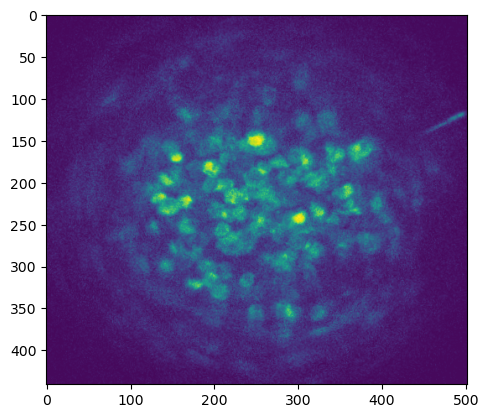

In [1118]:
plt.imshow(mov[0,...])

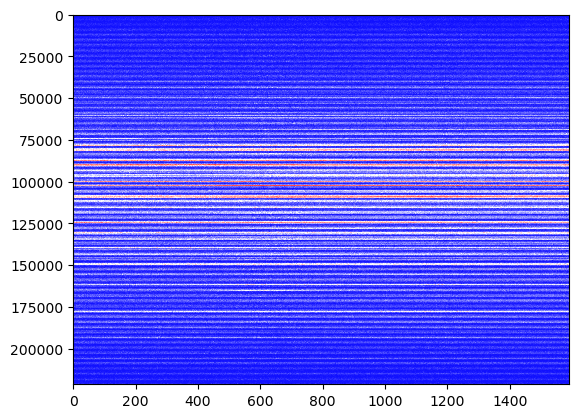

In [1119]:
plt.imshow((mov.reshape(mov.shape[0],-1)).T, interpolation='nearest', aspect='auto',cmap='bwr')

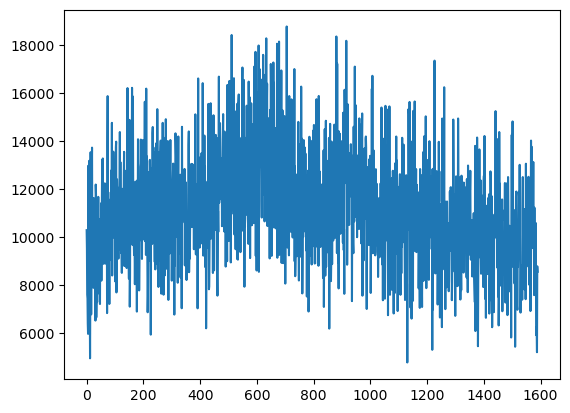

In [1120]:
plt.plot((mov.reshape(mov.shape[0],-1))[:,66000])

In [1121]:
C_sort = np.sort(sg.savgol_filter((mov.reshape(mov.shape[0],-1))[:,66000],31,1))
C_b10 = np.mean(C_sort[:int(np.ceil(C_sort.shape[0]/10))]) # bottom 10% mean
C_b10

9408.595

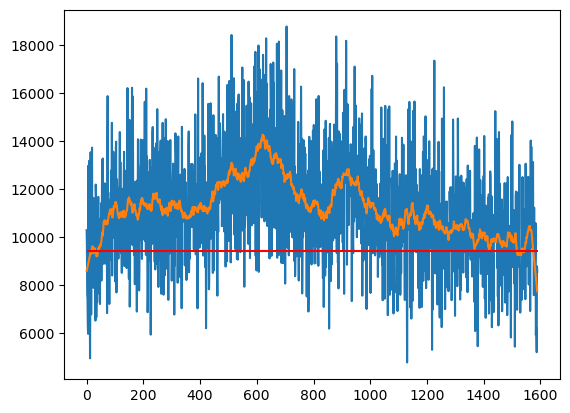

In [1122]:
plt.plot((mov.reshape(mov.shape[0],-1))[:,66000])
plt.plot(sg.savgol_filter((mov.reshape(mov.shape[0],-1))[:,66000],31,1))
plt.hlines(y=C_b10,xmin=0,xmax=C_sort.shape[0],color='red')

In [1123]:
%%time
pixo = (mov.reshape(mov.shape[0],-1)).T
pixomf = sg.savgol_filter(pixo,31,1,axis=1)

CPU times: total: 8.58 s
Wall time: 8.57 s


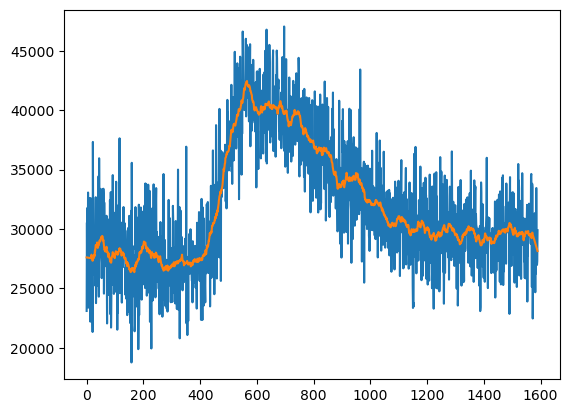

In [1125]:
plt.plot(pixo[192+201*502,...])
plt.plot(pixomf[192+201*502,...])

CPU times: total: 14.6 s
Wall time: 14.6 s


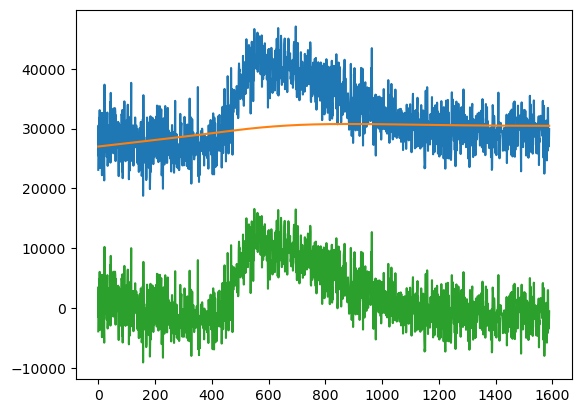

In [1129]:
%%time
# bandpass pixels
sample_rate = 31/180
def lowpass(data: np.ndarray, cutoff: float, sample_rate: float, poles: int = 5):
    sos = sg.butter(poles, cutoff, 'lowpass', fs=sample_rate, output='sos')
    filtered_data = scipy.signal.sosfiltfilt(sos, data)
    return filtered_data
def highpass(data: np.ndarray, cutoff: float, sample_rate: float, poles: int = 5):
    sos = sg.butter(poles, cutoff, 'highpass', fs=sample_rate, output='sos')
    filtered_data = scipy.signal.sosfiltfilt(sos, data)
    return filtered_data
def bandpass(data: np.ndarray, cutoff, sample_rate: float, poles: int = 5):
    sos = sg.butter(poles, cutoff, 'bandpass', fs=sample_rate, output='sos')
    filtered_data = scipy.signal.sosfiltfilt(sos, data)
    return filtered_data

times = np.arange(pixo.shape[1])/sample_rate #[...,:936]

#filtered = lowpass(cnmf_dicts_invivo_ip[l]['CY_mov_matched_raw_corr_norm1'][hdbs_invivo.labels_==c,...][...,:2400], 1/600, sample_rate)
#filtered = cnmf_dicts_invivo_ip[l]['CY_mov_matched_raw_corr_norm1'][hdbs_invivo.labels_==c,...][...,:2400]-highpass(cnmf_dicts_invivo_ip[l]['CY_mov_matched_raw_corr_norm1'][hdbs_invivo.labels_==c,...][...,:2400], 1/600, sample_rate,1)
#filtered =  bandpass(CY_m_matched_raw_corr_norm1[...,:3000], [1/8000,1/50], sample_rate,1)
#filteredu = bandpass(pixomf_dff, [1/6000,1/50], sample_rate,1) #[np.argsort(hdbs_invivo.labels_),...]
filteredu = lowpass(pixo, 1/(3*pixo.shape[1]/sample_rate), sample_rate,1) #[np.argsort(hdbs_invivo.labels_),...]
#filtered2 = bandpass(CY_m2_matched_raw_gr_corr_norm1[...,:2000], [1/4000,1/50], sample_rate,1) #[np.argsort(hdbs_invivo.labels_),...]

#from matplotlib import colors
#divnorm=colors.TwoSlopeNorm(vcenter=0)
#filteredu_sort = np.sort(filteredu,axis=1)
#filteredu_b10 = np.mean(filteredu_sort[:,:int(np.ceil(filteredu_sort.shape[1]/10))],axis=1) #[[x for x in np.arange(21).tolist() if x not in oxt_rm],...]
#filteredu_t10 = np.mean(filteredu_sort[:,-int(np.ceil(filteredu_sort.shape[1]/10)):],axis=1)
#filteredu_norm1 = ((filteredu.T-filteredu_b10)/(filteredu_t10-filteredu_b10)).T
#plt.imshow(filteredu_norm1[np.argsort(cnmf_dicts_invivo_ip[l]['row_clusts_f']),...],interpolation='nearest',aspect='auto',cmap='bwr')#,vmax=1)
plt.plot(pixo[192+201*502,...])
plt.plot(filteredu[192+201*502,...])
plt.plot((pixo-filteredu)[192+201*502,...])

#filtered2_sort = np.sort(filtered2,axis=1)
#filtered2_b10 = np.mean(filtered2_sort[:,:int(np.ceil(filtered2_sort.shape[1]/10))],axis=1) #[[x for x in np.arange(21).tolist() if x not in oxt_rm],...]
#filtered2_t10 = np.mean(filtered2_sort[:,-int(np.ceil(filtered2_sort.shape[1]/10)):],axis=1)
#filtered2_norm1 = ((filtered2.T-filtered2_b10)/(filtered2_t10-filtered2_b10)).T
#plt.imshow(filtered2_norm1[np.argsort(hdbs_slice_w.labels_),...],interpolation='nearest',aspect='auto',cmap='bwr',vmax=1)

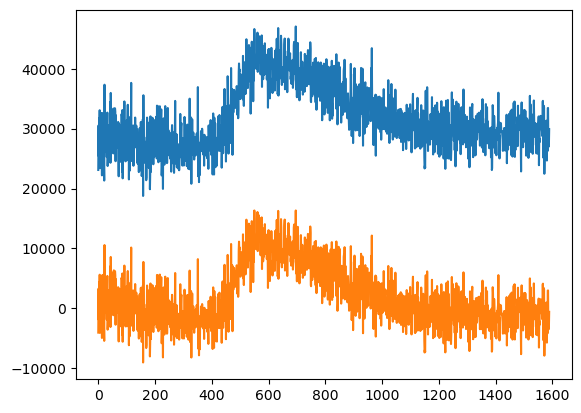

In [1130]:
filteredu2 = bandpass((pixo-filteredu), [1/190,1/170], sample_rate,1) #[np.argsort(hdbs_invivo.labels_),...]

plt.plot(pixo[192+201*502,...])
plt.plot((pixo-filteredu-filteredu2)[192+201*502,...])

In [1131]:
pixoc = pixo-filteredu#-filteredu2
pixocmf = sg.savgol_filter(pixoc,31,1,axis=1)

pixomf_sort = np.sort(pixomf,axis=1)
pixocmf_sort = np.sort(pixocmf,axis=1)

pixomf_b10 = np.mean(pixomf_sort[:,:int(np.ceil(pixomf_sort.shape[1]/10))],axis=1) # bottom 10% mean
pixocmf_b10 = np.mean(pixocmf_sort[:,:int(np.ceil(pixocmf_sort.shape[1]/10))],axis=1) # bottom 10% mean

(array([110275.,  50623.,  22124.,  14734.,   9705.,   6649.,   3733.,
          2189.,    930.,    420.]),
 array([ 1706.01696777,  8053.52734375, 14401.03808594, 20748.54882812,
        27096.05859375, 33443.5703125 , 39791.078125  , 46138.58984375,
        52486.1015625 , 58833.609375  , 65181.12109375]),
 <BarContainer object of 10 artists>)

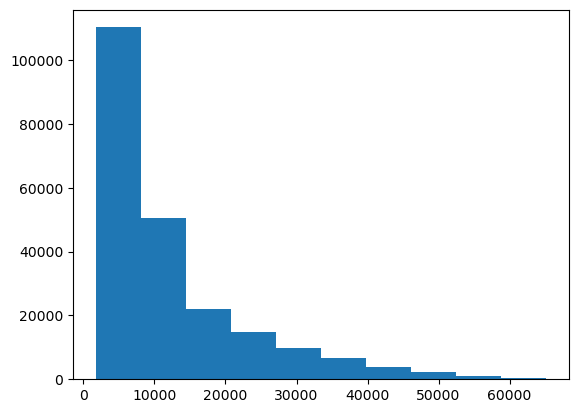

In [1132]:
plt.hist(np.max(pixomf,axis=1))

(array([126220.,  50867.,  21780.,  10426.,   5891.,   3323.,   1701.,
           700.,    247.,    227.]),
 array([  852.9420166 ,  7080.77490234, 13308.60742188, 19536.43945312,
        25764.2734375 , 31992.10546875, 38219.9375    , 44447.76953125,
        50675.60546875, 56903.4375    , 63131.26953125]),
 <BarContainer object of 10 artists>)

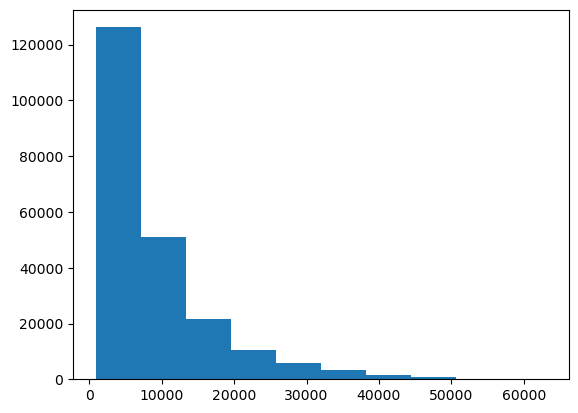

In [1133]:
plt.hist(pixomf_b10)

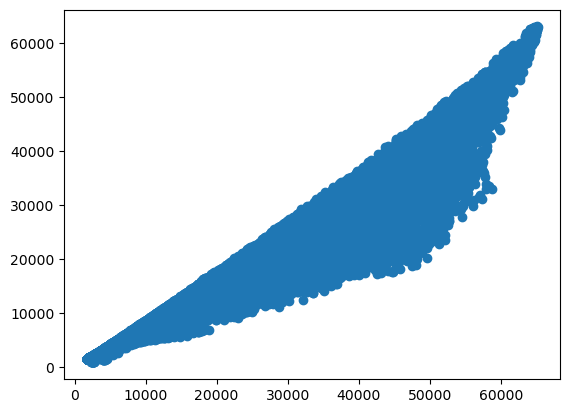

In [1134]:
plt.scatter(np.max(pixomf,axis=1),pixomf_b10)

(array([2.8082e+04, 6.7601e+04, 6.0378e+04, 3.8346e+04, 1.9221e+04,
        5.5690e+03, 1.5540e+03, 4.4400e+02, 1.4000e+02, 4.7000e+01]),
 array([ 1360.87083202,  4376.04093271,  7391.21103339, 10406.38113407,
        13421.55123475, 16436.72133543, 19451.89143611, 22467.06153679,
        25482.23163747, 28497.40173815, 31512.57183883]),
 <BarContainer object of 10 artists>)

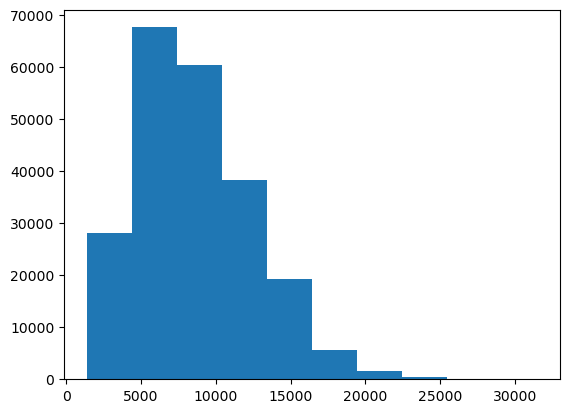

In [1135]:
plt.hist(np.max((pixoc.T-pixocmf_b10),axis=0))

In [1136]:
np.where(np.max((pixoc.T-pixocmf_b10),axis=0)<10000)[0].shape

(149706,)

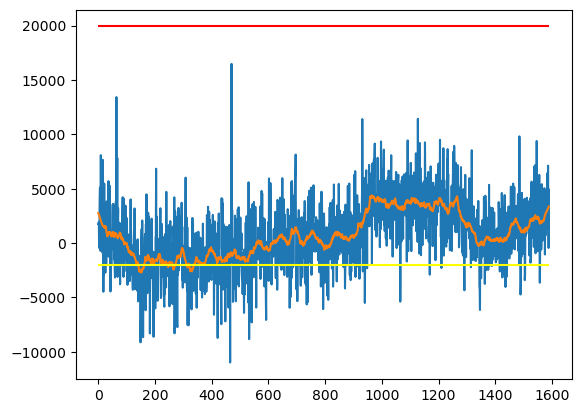

In [1137]:
plt.plot(pixoc[261*500+255,...])
plt.plot(pixocmf[261*500+255,...])
plt.hlines(y=pixomf_b10[261*500+255],xmin=0,xmax=pixoc.shape[1],color='red')
plt.hlines(y=pixocmf_b10[261*500+255],xmin=0,xmax=pixoc.shape[1],color='yellow')

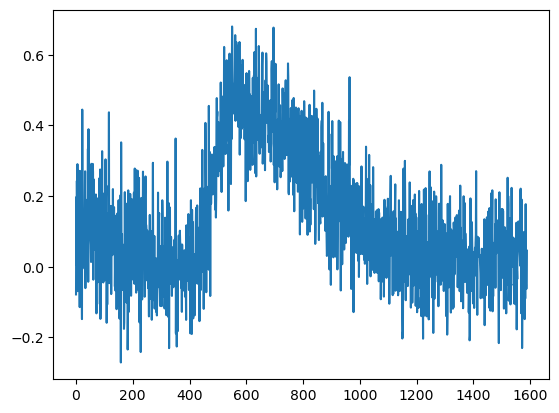

In [1138]:
pixocdff = (pixoc.T-pixocmf_b10)/pixomf_b10
plt.plot(pixocdff[...,192+201*502])

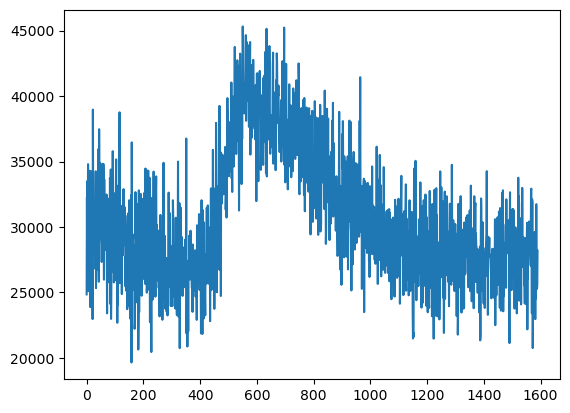

In [1139]:
pixocf = (pixoc.T-pixocmf_b10)+pixomf_b10
plt.plot(pixocf[...,192+201*502])

In [1140]:
pixocdff.T.shape

(221382, 1590)

In [1141]:
movc = pixocdff.reshape(mov.shape)
movc.shape

(1590, 441, 502)

In [1142]:
pixocdff2 = deepcopy(pixocdff)
pixocdff2[...,np.where(np.max((pixoc.T-pixocmf_b10),axis=0)<5000)[0]] = np.zeros((pixocdff.shape[0],np.where(np.max((pixoc.T-pixocmf_b10),axis=0)<5000)[0].shape[0]))

In [1143]:
movc2 = pixocdff2.reshape(mov.shape)
movc2.shape

(1590, 441, 502)

In [1144]:
movc3 = pixocf.reshape(mov.shape)
movc3.shape

(1590, 441, 502)

In [1145]:
print(fname)
print(fname[:-4]+r'_dff.tif')

\\nasquatch\data\2p\peter\grin_videos\PK49PL18_220701_001_noartifact_wch0_aniso4_scale4AFS2PL4_toref76_wxy_nobg\movie_z10_tds3.tif
\\nasquatch\data\2p\peter\grin_videos\PK49PL18_220701_001_noartifact_wch0_aniso4_scale4AFS2PL4_toref76_wxy_nobg\movie_z10_tds3_dff.tif


In [1146]:
imwrite(fname[:-4]+r'_dff.tif',movc)

In [1147]:
imwrite(fname[:-4]+r'_dff2.tif',movc2)

In [1148]:
imwrite(fname[:-4]+r'_f.tif',movc3)

In [1149]:
# supp video 7s dff/cleaned up f (do dff in fiji to a single baseline frame)
fname = r'\\nasquatch\data\2p\peter\grin_videos\PK49PL18_220701_001_noartifact_wch0_aniso4_scale4AFS2PL4_toref76_wxy_nobg\movie_z10s_tds3.tif'
mov = imread(fname)
mov.shape

(1590, 441, 502)

In [1150]:
mov.reshape(mov.shape[0],-1).shape

(1590, 221382)

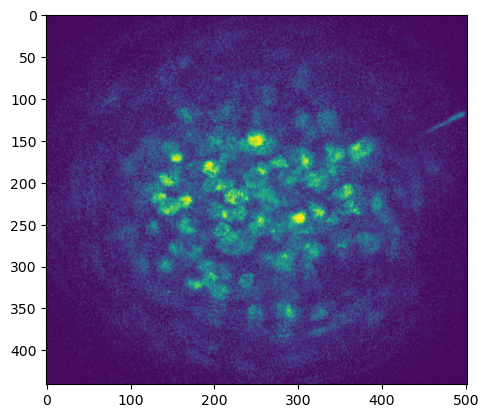

In [1151]:
plt.imshow(mov[0,...])

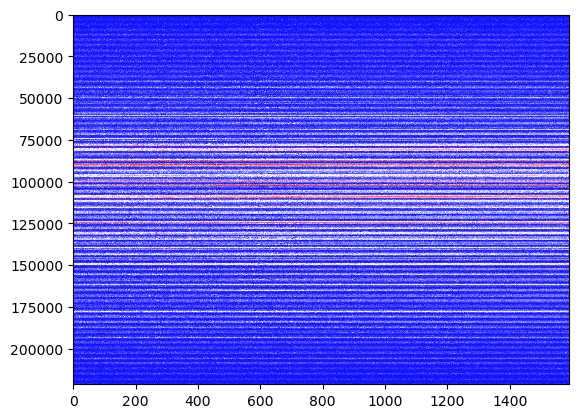

In [1152]:
plt.imshow((mov.reshape(mov.shape[0],-1)).T, interpolation='nearest', aspect='auto',cmap='bwr')

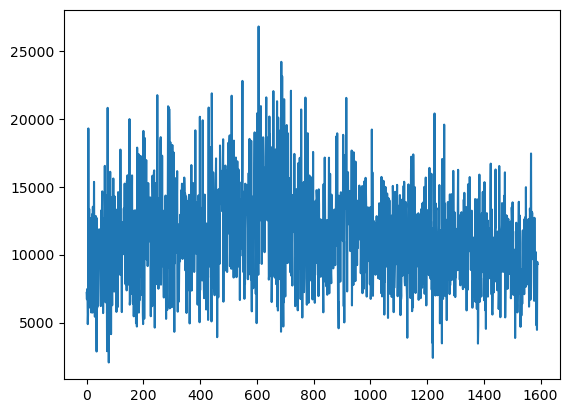

In [1153]:
plt.plot((mov.reshape(mov.shape[0],-1))[:,66000])

In [1154]:
C_sort = np.sort(sg.savgol_filter((mov.reshape(mov.shape[0],-1))[:,66000],31,1))
C_b10 = np.mean(C_sort[:int(np.ceil(C_sort.shape[0]/10))]) # bottom 10% mean
C_b10

9235.022

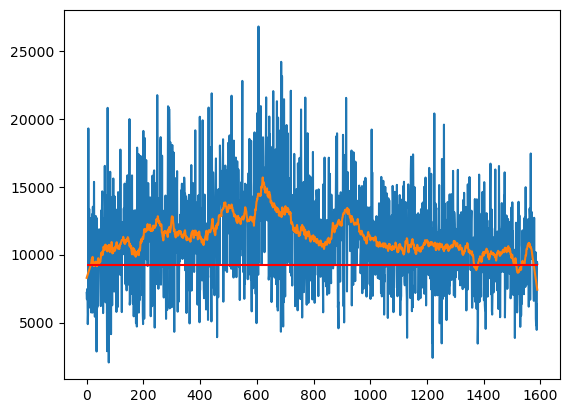

In [1155]:
plt.plot((mov.reshape(mov.shape[0],-1))[:,66000])
plt.plot(sg.savgol_filter((mov.reshape(mov.shape[0],-1))[:,66000],31,1))
plt.hlines(y=C_b10,xmin=0,xmax=C_sort.shape[0],color='red')

In [1156]:
%%time
pixo = (mov.reshape(mov.shape[0],-1)).T
pixomf = sg.savgol_filter(pixo,31,1,axis=1)

CPU times: total: 8.34 s
Wall time: 8.34 s


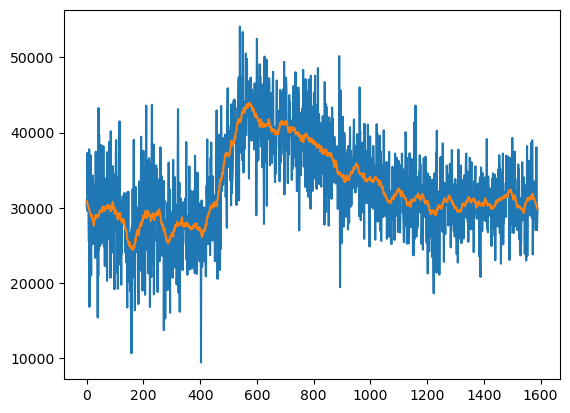

In [1157]:
plt.plot(pixo[192+201*502,...])
plt.plot(pixomf[192+201*502,...])

CPU times: total: 18 s
Wall time: 18.2 s


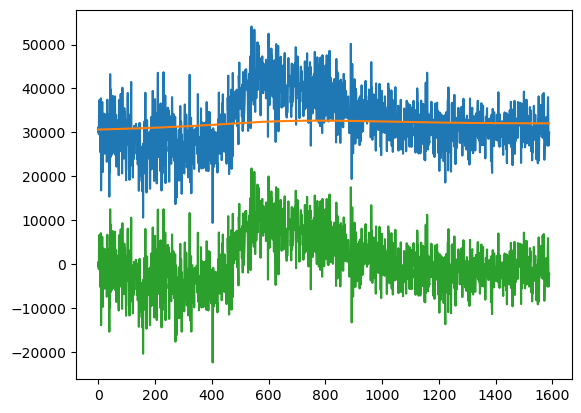

In [1158]:
%%time
# bandpass pixels
sample_rate = 31/180
def lowpass(data: np.ndarray, cutoff: float, sample_rate: float, poles: int = 5):
    sos = sg.butter(poles, cutoff, 'lowpass', fs=sample_rate, output='sos')
    filtered_data = scipy.signal.sosfiltfilt(sos, data)
    return filtered_data
def highpass(data: np.ndarray, cutoff: float, sample_rate: float, poles: int = 5):
    sos = sg.butter(poles, cutoff, 'highpass', fs=sample_rate, output='sos')
    filtered_data = scipy.signal.sosfiltfilt(sos, data)
    return filtered_data
def bandpass(data: np.ndarray, cutoff, sample_rate: float, poles: int = 5):
    sos = sg.butter(poles, cutoff, 'bandpass', fs=sample_rate, output='sos')
    filtered_data = scipy.signal.sosfiltfilt(sos, data)
    return filtered_data

times = np.arange(pixo.shape[1])/sample_rate #[...,:936]

#filtered = lowpass(cnmf_dicts_invivo_ip[l]['CY_mov_matched_raw_corr_norm1'][hdbs_invivo.labels_==c,...][...,:2400], 1/600, sample_rate)
#filtered = cnmf_dicts_invivo_ip[l]['CY_mov_matched_raw_corr_norm1'][hdbs_invivo.labels_==c,...][...,:2400]-highpass(cnmf_dicts_invivo_ip[l]['CY_mov_matched_raw_corr_norm1'][hdbs_invivo.labels_==c,...][...,:2400], 1/600, sample_rate,1)
#filtered =  bandpass(CY_m_matched_raw_corr_norm1[...,:3000], [1/8000,1/50], sample_rate,1)
#filteredu = bandpass(pixomf_dff, [1/6000,1/50], sample_rate,1) #[np.argsort(hdbs_invivo.labels_),...]
filteredu = lowpass(pixo, 1/(3*pixo.shape[1]/sample_rate), sample_rate,1) #[np.argsort(hdbs_invivo.labels_),...]
#filtered2 = bandpass(CY_m2_matched_raw_gr_corr_norm1[...,:2000], [1/4000,1/50], sample_rate,1) #[np.argsort(hdbs_invivo.labels_),...]

#from matplotlib import colors
#divnorm=colors.TwoSlopeNorm(vcenter=0)
#filteredu_sort = np.sort(filteredu,axis=1)
#filteredu_b10 = np.mean(filteredu_sort[:,:int(np.ceil(filteredu_sort.shape[1]/10))],axis=1) #[[x for x in np.arange(21).tolist() if x not in oxt_rm],...]
#filteredu_t10 = np.mean(filteredu_sort[:,-int(np.ceil(filteredu_sort.shape[1]/10)):],axis=1)
#filteredu_norm1 = ((filteredu.T-filteredu_b10)/(filteredu_t10-filteredu_b10)).T
#plt.imshow(filteredu_norm1[np.argsort(cnmf_dicts_invivo_ip[l]['row_clusts_f']),...],interpolation='nearest',aspect='auto',cmap='bwr')#,vmax=1)
plt.plot(pixo[192+201*502,...])
plt.plot(filteredu[192+201*502,...])
plt.plot((pixo-filteredu)[192+201*502,...])

#filtered2_sort = np.sort(filtered2,axis=1)
#filtered2_b10 = np.mean(filtered2_sort[:,:int(np.ceil(filtered2_sort.shape[1]/10))],axis=1) #[[x for x in np.arange(21).tolist() if x not in oxt_rm],...]
#filtered2_t10 = np.mean(filtered2_sort[:,-int(np.ceil(filtered2_sort.shape[1]/10)):],axis=1)
#filtered2_norm1 = ((filtered2.T-filtered2_b10)/(filtered2_t10-filtered2_b10)).T
#plt.imshow(filtered2_norm1[np.argsort(hdbs_slice_w.labels_),...],interpolation='nearest',aspect='auto',cmap='bwr',vmax=1)

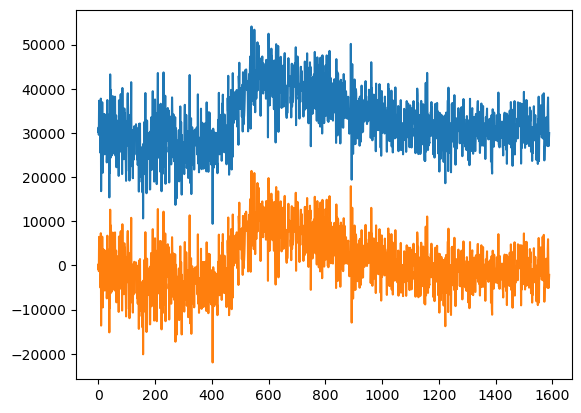

In [1159]:
filteredu2 = bandpass((pixo-filteredu), [1/190,1/170], sample_rate,1) #[np.argsort(hdbs_invivo.labels_),...]

plt.plot(pixo[192+201*502,...])
plt.plot((pixo-filteredu-filteredu2)[192+201*502,...])

In [1160]:
pixoc = pixo-filteredu#-filteredu2
pixocmf = sg.savgol_filter(pixoc,31,1,axis=1)

pixomf_sort = np.sort(pixomf,axis=1)
pixocmf_sort = np.sort(pixocmf,axis=1)

pixomf_b10 = np.mean(pixomf_sort[:,:int(np.ceil(pixomf_sort.shape[1]/10))],axis=1) # bottom 10% mean
pixocmf_b10 = np.mean(pixocmf_sort[:,:int(np.ceil(pixocmf_sort.shape[1]/10))],axis=1) # bottom 10% mean

(array([103411.,  54865.,  23327.,  15016.,   9543.,   6661.,   4042.,
          2497.,   1367.,    653.]),
 array([ 1714.25817871,  8112.41650391, 14510.57519531, 20908.734375  ,
        27306.89257812, 33705.05078125, 40103.2109375 , 46501.3671875 ,
        52899.52734375, 59297.68359375, 65695.84375   ]),
 <BarContainer object of 10 artists>)

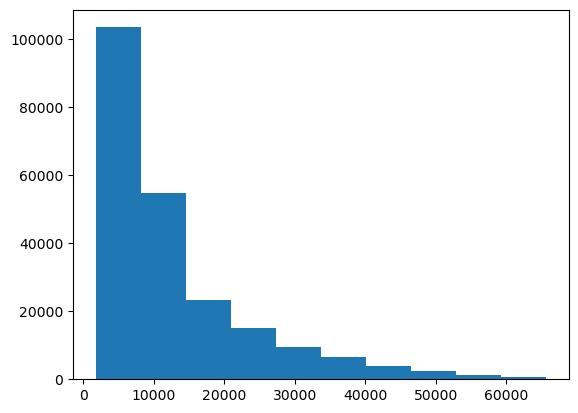

In [1161]:
plt.hist(np.max(pixomf,axis=1))

(array([128462.,  49813.,  21246.,   9812.,   5735.,   3281.,   1669.,
           772.,    325.,    267.]),
 array([  675.49835205,  6970.12695312, 13264.75585938, 19559.38476562,
        25854.01367188, 32148.64257812, 38443.26953125, 44737.8984375 ,
        51032.52734375, 57327.15625   , 63621.78515625]),
 <BarContainer object of 10 artists>)

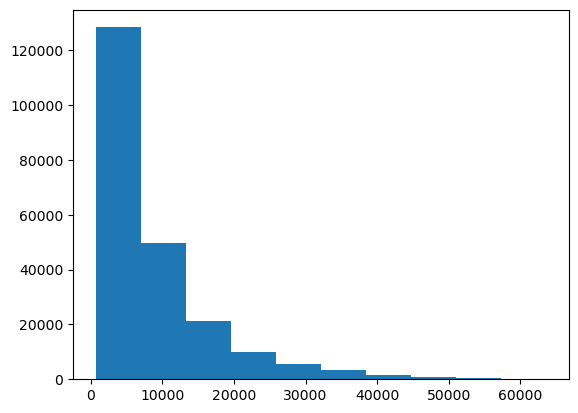

In [1162]:
plt.hist(pixomf_b10)

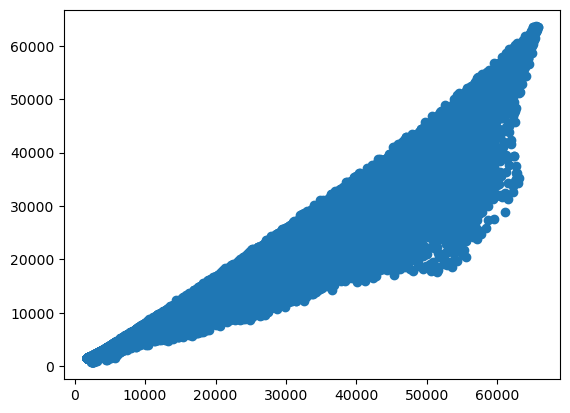

In [1163]:
plt.scatter(np.max(pixomf,axis=1),pixomf_b10)

(array([1.0467e+04, 4.0537e+04, 5.9845e+04, 5.4147e+04, 3.8269e+04,
        1.4071e+04, 3.2830e+03, 6.3400e+02, 1.1500e+02, 1.4000e+01]),
 array([ 1802.86298506,  5743.34743004,  9683.83187502, 13624.31632   ,
        17564.80076499, 21505.28520997, 25445.76965495, 29386.25409993,
        33326.73854491, 37267.2229899 , 41207.70743488]),
 <BarContainer object of 10 artists>)

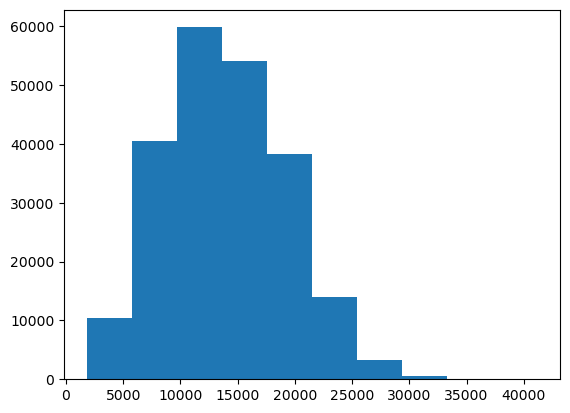

In [1164]:
plt.hist(np.max((pixoc.T-pixocmf_b10),axis=0))

In [1165]:
np.where(np.max((pixoc.T-pixocmf_b10),axis=0)<10000)[0].shape

(55604,)

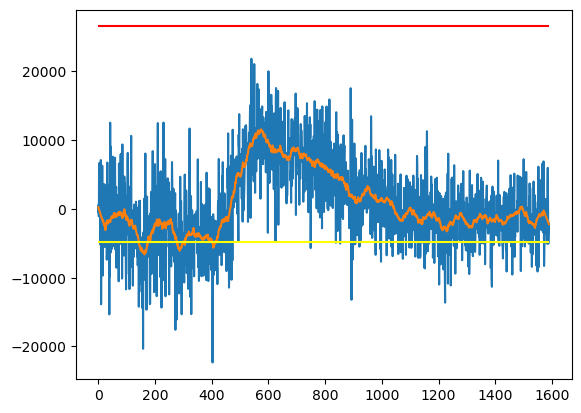

In [1166]:
plt.plot(pixoc[192+201*502,...])
plt.plot(pixocmf[192+201*502,...])
plt.hlines(y=pixomf_b10[192+201*502],xmin=0,xmax=pixoc.shape[1],color='red')
plt.hlines(y=pixocmf_b10[192+201*502],xmin=0,xmax=pixoc.shape[1],color='yellow')

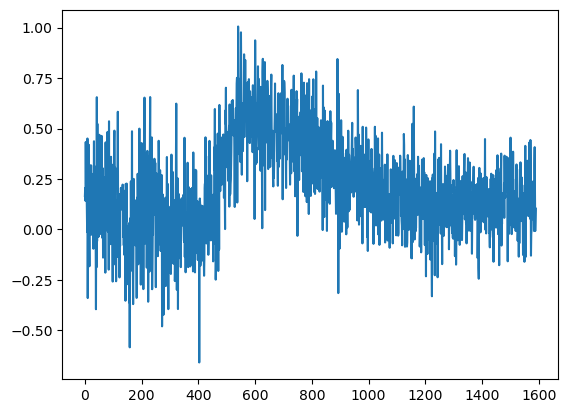

In [1167]:
pixocdff = (pixoc.T-pixocmf_b10)/pixomf_b10
plt.plot(pixocdff[...,192+201*502])

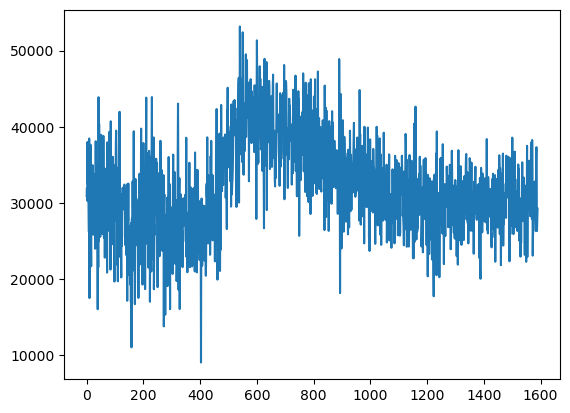

In [1168]:
pixocf = (pixoc.T-pixocmf_b10)+pixomf_b10
plt.plot(pixocf[...,192+201*502])

In [1169]:
pixocdff.T.shape

(221382, 1590)

In [1170]:
movc = pixocdff.reshape(mov.shape)
movc.shape

(1590, 441, 502)

In [1171]:
pixocdff2 = deepcopy(pixocdff)
pixocdff2[...,np.where(np.max((pixoc.T-pixocmf_b10),axis=0)<5000)[0]] = np.zeros((pixocdff.shape[0],np.where(np.max((pixoc.T-pixocmf_b10),axis=0)<5000)[0].shape[0]))

In [1172]:
movc2 = pixocdff2.reshape(mov.shape)
movc2.shape

(1590, 441, 502)

In [1173]:
movc3 = pixocf.reshape(mov.shape)
movc3.shape

(1590, 441, 502)

In [1174]:
print(fname)
print(fname[:-4]+r'_dff.tif')

\\nasquatch\data\2p\peter\grin_videos\PK49PL18_220701_001_noartifact_wch0_aniso4_scale4AFS2PL4_toref76_wxy_nobg\movie_z10s_tds3.tif
\\nasquatch\data\2p\peter\grin_videos\PK49PL18_220701_001_noartifact_wch0_aniso4_scale4AFS2PL4_toref76_wxy_nobg\movie_z10s_tds3_dff.tif


In [1175]:
imwrite(fname[:-4]+r'_dff.tif',movc)

In [1176]:
imwrite(fname[:-4]+r'_dff2.tif',movc2)

In [1177]:
imwrite(fname[:-4]+r'_f.tif',movc3)

In [1244]:
# supp video 8 dff/cleaned up f (do dff in fiji to a single baseline frame)
fname = r'\\nasquatch\data\2p\peter\grin_videos\PK49PL18_220701_101_full_wch0_aniso4_scale4AFS2PL4_toref100_wxy_nobg\movie_z10_tds3_corr.tif'
mov = imread(fname)
mov.shape

(2756, 414, 475)

In [1245]:
mov = mov[52:1300,...]

In [1246]:
mov.reshape(mov.shape[0],-1).shape

(1248, 196650)

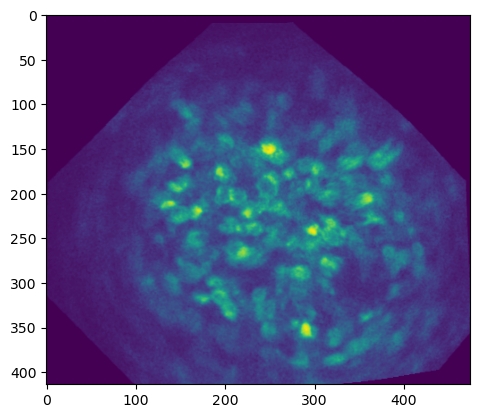

In [1247]:
plt.imshow(mov[0,...])

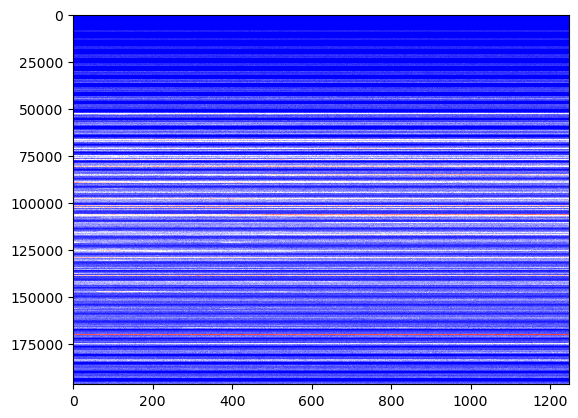

In [1248]:
plt.imshow((mov.reshape(mov.shape[0],-1)).T, interpolation='nearest', aspect='auto',cmap='bwr')

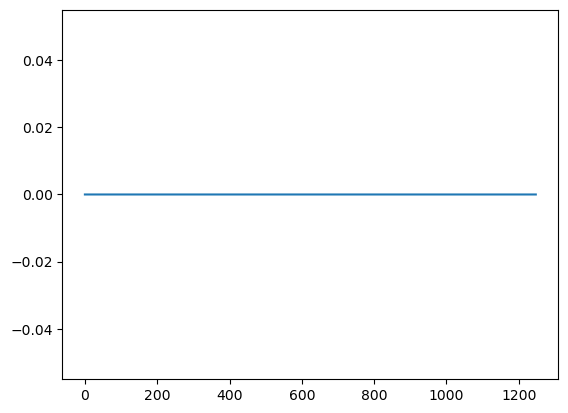

In [1249]:
plt.plot((mov.reshape(mov.shape[0],-1))[:,66000])

In [1250]:
C_sort = np.sort(sg.savgol_filter((mov.reshape(mov.shape[0],-1))[:,104000],31,1))
C_b10 = np.mean(C_sort[:int(np.ceil(C_sort.shape[0]/10))]) # bottom 10% mean
C_b10

7787.866804582569

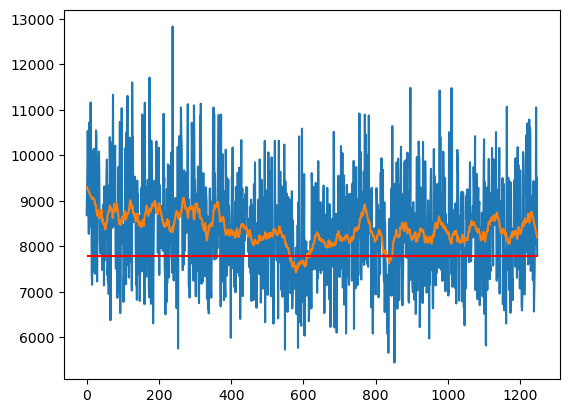

In [1251]:
plt.plot((mov.reshape(mov.shape[0],-1))[:,104000])
plt.plot(sg.savgol_filter((mov.reshape(mov.shape[0],-1))[:,104000],31,1))
plt.hlines(y=C_b10,xmin=0,xmax=C_sort.shape[0],color='red')

In [1252]:
%%time
pixo = (mov.reshape(mov.shape[0],-1)).T
pixomf = sg.savgol_filter(pixo,31,1,axis=1)

CPU times: total: 6.12 s
Wall time: 6.12 s


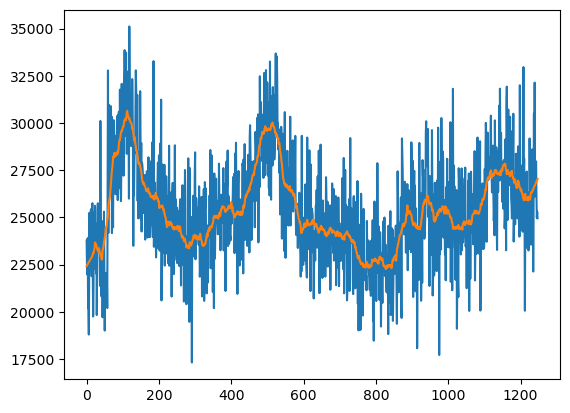

In [1258]:
plt.plot(pixo[295+270*475,...])
plt.plot(pixomf[295+270*475,...])

CPU times: total: 9.95 s
Wall time: 9.95 s


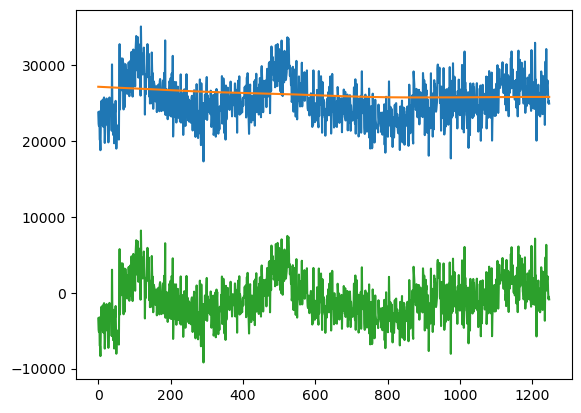

In [1259]:
%%time
# bandpass pixels
sample_rate = 31/180
def lowpass(data: np.ndarray, cutoff: float, sample_rate: float, poles: int = 5):
    sos = sg.butter(poles, cutoff, 'lowpass', fs=sample_rate, output='sos')
    filtered_data = scipy.signal.sosfiltfilt(sos, data)
    return filtered_data
def highpass(data: np.ndarray, cutoff: float, sample_rate: float, poles: int = 5):
    sos = sg.butter(poles, cutoff, 'highpass', fs=sample_rate, output='sos')
    filtered_data = scipy.signal.sosfiltfilt(sos, data)
    return filtered_data
def bandpass(data: np.ndarray, cutoff, sample_rate: float, poles: int = 5):
    sos = sg.butter(poles, cutoff, 'bandpass', fs=sample_rate, output='sos')
    filtered_data = scipy.signal.sosfiltfilt(sos, data)
    return filtered_data

times = np.arange(pixo.shape[1])/sample_rate #[...,:936]

#filtered = lowpass(cnmf_dicts_invivo_ip[l]['CY_mov_matched_raw_corr_norm1'][hdbs_invivo.labels_==c,...][...,:2400], 1/600, sample_rate)
#filtered = cnmf_dicts_invivo_ip[l]['CY_mov_matched_raw_corr_norm1'][hdbs_invivo.labels_==c,...][...,:2400]-highpass(cnmf_dicts_invivo_ip[l]['CY_mov_matched_raw_corr_norm1'][hdbs_invivo.labels_==c,...][...,:2400], 1/600, sample_rate,1)
#filtered =  bandpass(CY_m_matched_raw_corr_norm1[...,:3000], [1/8000,1/50], sample_rate,1)
#filteredu = bandpass(pixomf_dff, [1/6000,1/50], sample_rate,1) #[np.argsort(hdbs_invivo.labels_),...]
filteredu = lowpass(pixo, 1/(3*pixo.shape[1]/sample_rate), sample_rate,1) #[np.argsort(hdbs_invivo.labels_),...]
#filtered2 = bandpass(CY_m2_matched_raw_gr_corr_norm1[...,:2000], [1/4000,1/50], sample_rate,1) #[np.argsort(hdbs_invivo.labels_),...]

#from matplotlib import colors
#divnorm=colors.TwoSlopeNorm(vcenter=0)
#filteredu_sort = np.sort(filteredu,axis=1)
#filteredu_b10 = np.mean(filteredu_sort[:,:int(np.ceil(filteredu_sort.shape[1]/10))],axis=1) #[[x for x in np.arange(21).tolist() if x not in oxt_rm],...]
#filteredu_t10 = np.mean(filteredu_sort[:,-int(np.ceil(filteredu_sort.shape[1]/10)):],axis=1)
#filteredu_norm1 = ((filteredu.T-filteredu_b10)/(filteredu_t10-filteredu_b10)).T
#plt.imshow(filteredu_norm1[np.argsort(cnmf_dicts_invivo_ip[l]['row_clusts_f']),...],interpolation='nearest',aspect='auto',cmap='bwr')#,vmax=1)
plt.plot(pixo[295+270*475,...])
plt.plot(filteredu[295+270*475,...])
plt.plot((pixo-filteredu)[295+270*475,...])

#filtered2_sort = np.sort(filtered2,axis=1)
#filtered2_b10 = np.mean(filtered2_sort[:,:int(np.ceil(filtered2_sort.shape[1]/10))],axis=1) #[[x for x in np.arange(21).tolist() if x not in oxt_rm],...]
#filtered2_t10 = np.mean(filtered2_sort[:,-int(np.ceil(filtered2_sort.shape[1]/10)):],axis=1)
#filtered2_norm1 = ((filtered2.T-filtered2_b10)/(filtered2_t10-filtered2_b10)).T
#plt.imshow(filtered2_norm1[np.argsort(hdbs_slice_w.labels_),...],interpolation='nearest',aspect='auto',cmap='bwr',vmax=1)

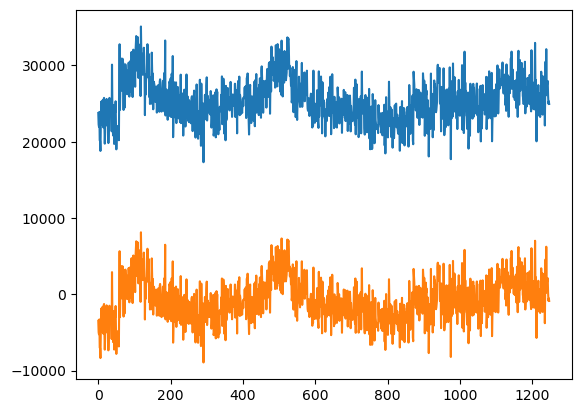

In [1260]:
filteredu2 = bandpass((pixo-filteredu), [1/190,1/170], sample_rate,1) #[np.argsort(hdbs_invivo.labels_),...]

plt.plot(pixo[295+270*475,...])
plt.plot((pixo-filteredu-filteredu2)[295+270*475,...])

In [1261]:
pixoc = pixo-filteredu-filteredu2
pixocmf = sg.savgol_filter(pixoc,31,1,axis=1)

pixomf_sort = np.sort(pixomf,axis=1)
pixocmf_sort = np.sort(pixocmf,axis=1)

pixomf_b10 = np.mean(pixomf_sort[:,:int(np.ceil(pixomf_sort.shape[1]/10))],axis=1) # bottom 10% mean
pixocmf_b10 = np.mean(pixocmf_sort[:,:int(np.ceil(pixocmf_sort.shape[1]/10))],axis=1) # bottom 10% mean

(array([65074., 55342., 34497., 19661., 10736.,  6134.,  3037.,  1402.,
          540.,   227.]),
 array([    0.        ,  6637.24820838, 13274.49641677, 19911.74462515,
        26548.99283354, 33186.24104192, 39823.4892503 , 46460.73745869,
        53097.98566707, 59735.23387546, 66372.48208384]),
 <BarContainer object of 10 artists>)

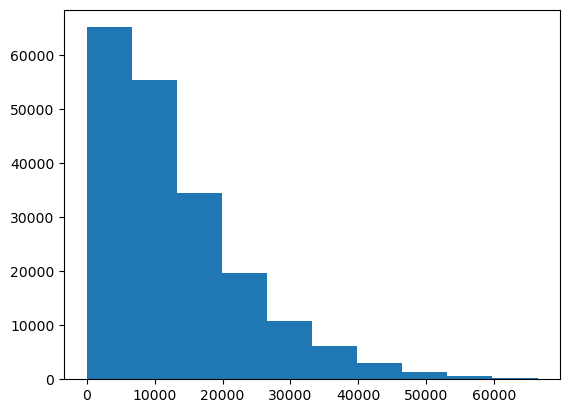

In [1262]:
plt.hist(np.max(pixomf,axis=1))

(array([74357., 64366., 33473., 14007.,  5896.,  2753.,  1043.,   419.,
          252.,    84.]),
 array([    0.        ,  6406.02419023, 12812.04838046, 19218.07257069,
        25624.09676092, 32030.12095115, 38436.14514138, 44842.16933161,
        51248.19352184, 57654.21771207, 64060.2419023 ]),
 <BarContainer object of 10 artists>)

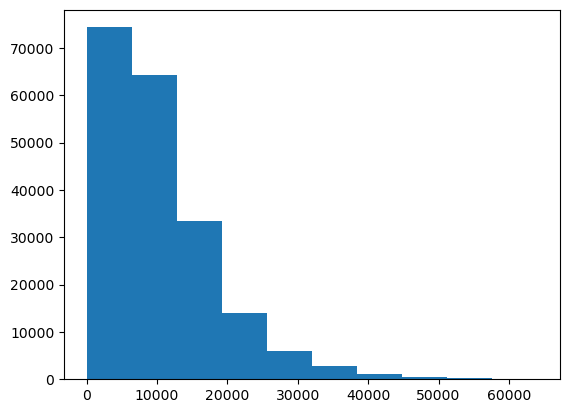

In [1263]:
plt.hist(pixomf_b10)

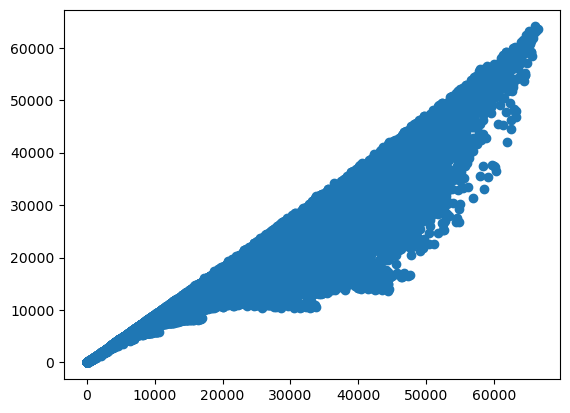

In [1264]:
plt.scatter(np.max(pixomf,axis=1),pixomf_b10)

(array([5.3876e+04, 5.8086e+04, 4.8935e+04, 2.3492e+04, 8.1700e+03,
        2.7990e+03, 9.3900e+02, 2.8000e+02, 6.4000e+01, 9.0000e+00]),
 array([    0.        ,  2874.86431199,  5749.72862398,  8624.59293597,
        11499.45724796, 14374.32155995, 17249.18587194, 20124.05018393,
        22998.91449592, 25873.77880791, 28748.6431199 ]),
 <BarContainer object of 10 artists>)

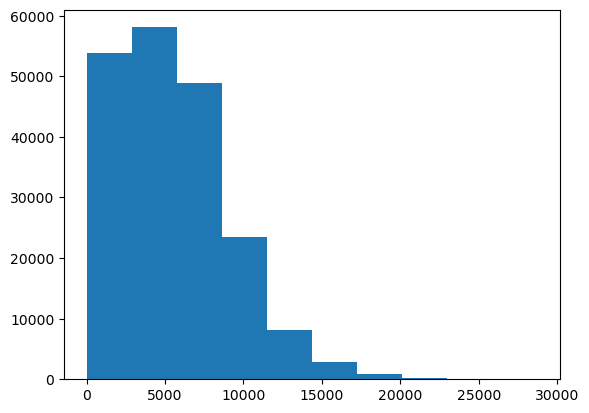

In [1265]:
plt.hist(np.max((pixoc.T-pixocmf_b10),axis=0))

In [1266]:
np.where(np.max((pixoc.T-pixocmf_b10),axis=0)<10000)[0].shape

(175123,)

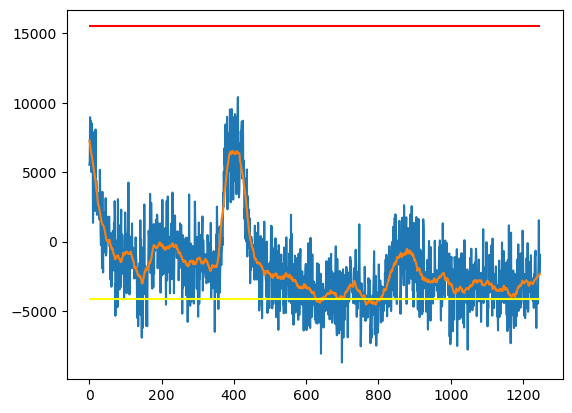

In [1267]:
plt.plot(pixoc[323+252*475,...])
plt.plot(pixocmf[323+252*475,...])
plt.hlines(y=pixomf_b10[323+252*475],xmin=0,xmax=pixoc.shape[1],color='red')
plt.hlines(y=pixocmf_b10[323+252*475],xmin=0,xmax=pixoc.shape[1],color='yellow')

C:\Users\pkalugin\AppData\Local\Temp\7\ipykernel_24584\1954383089.py:1: RuntimeWarning: invalid value encountered in divide
  pixocdff = (pixoc.T-pixocmf_b10)/pixomf_b10


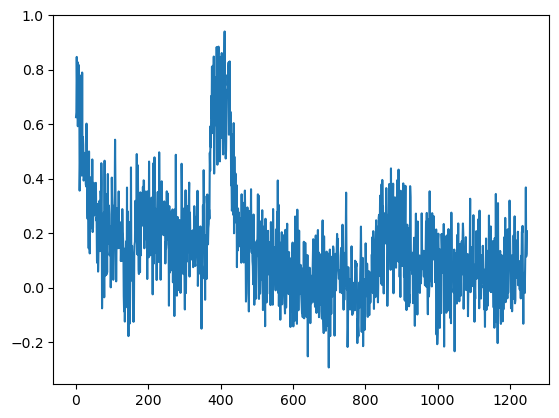

In [1268]:
pixocdff = (pixoc.T-pixocmf_b10)/pixomf_b10
plt.plot(pixocdff[...,323+252*475])

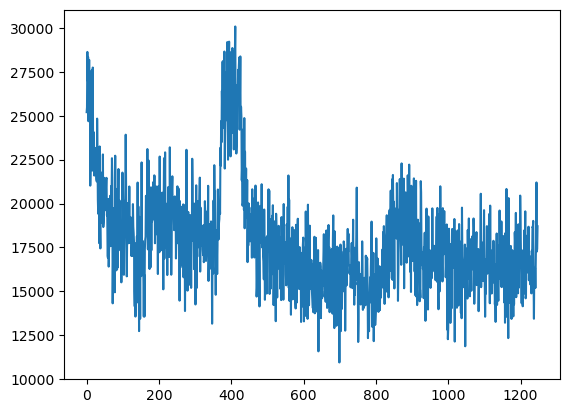

In [1269]:
pixocf = (pixoc.T-pixocmf_b10)+pixomf_b10
plt.plot(pixocf[...,323+252*475])

In [1270]:
pixocdff.T.shape

(196650, 1248)

In [1271]:
movc = pixocdff.reshape(mov.shape)
movc.shape

(1248, 414, 475)

In [1272]:
pixocdff2 = deepcopy(pixocdff)
pixocdff2[...,np.where(np.max((pixoc.T-pixocmf_b10),axis=0)<5000)[0]] = np.zeros((pixocdff.shape[0],np.where(np.max((pixoc.T-pixocmf_b10),axis=0)<5000)[0].shape[0]))

In [1273]:
movc2 = pixocdff2.reshape(mov.shape)
movc2.shape

(1248, 414, 475)

In [1274]:
movc3 = pixocf.reshape(mov.shape)
movc3.shape

(1248, 414, 475)

In [1275]:
print(fname)
print(fname[:-4]+r'_dff.tif')

\\nasquatch\data\2p\peter\grin_videos\PK49PL18_220701_101_full_wch0_aniso4_scale4AFS2PL4_toref100_wxy_nobg\movie_z10_tds3_corr.tif
\\nasquatch\data\2p\peter\grin_videos\PK49PL18_220701_101_full_wch0_aniso4_scale4AFS2PL4_toref100_wxy_nobg\movie_z10_tds3_corr_dff.tif


In [1276]:
imwrite(fname[:-4]+r'_dff.tif',movc)

In [1277]:
imwrite(fname[:-4]+r'_dff2.tif',movc2)

In [1278]:
imwrite(fname[:-4]+r'_f.tif',movc3)

In [1279]:
# supp video 8s dff/cleaned up f (do dff in fiji to a single baseline frame)
fname = r'\\nasquatch\data\2p\peter\grin_videos\PK49PL18_220701_101_full_wch0_aniso4_scale4AFS2PL4_toref100_wxy_nobg\movie_z10s_tds3_corr.tif'
mov = imread(fname)
mov.shape

(2756, 414, 475)

In [1280]:
mov = mov[52:1300,...]

In [1281]:
mov.reshape(mov.shape[0],-1).shape

(1248, 196650)

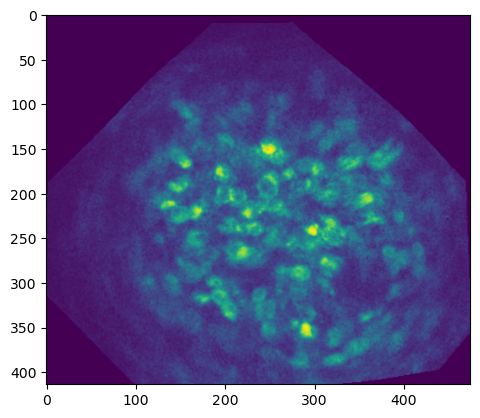

In [1282]:
plt.imshow(mov[0,...])

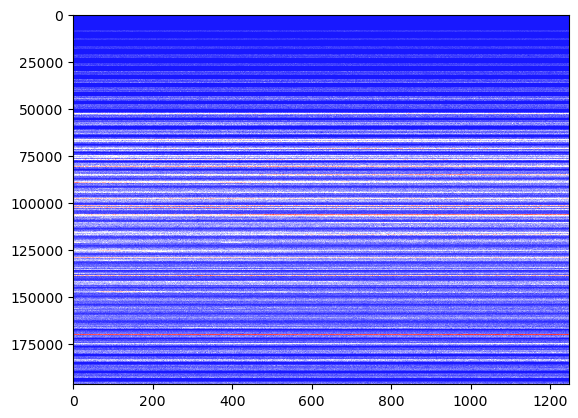

In [1283]:
plt.imshow((mov.reshape(mov.shape[0],-1)).T, interpolation='nearest', aspect='auto',cmap='bwr')

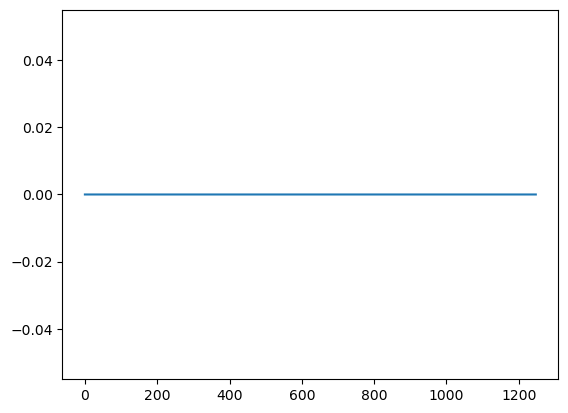

In [1284]:
plt.plot((mov.reshape(mov.shape[0],-1))[:,66000])

In [1285]:
C_sort = np.sort(sg.savgol_filter((mov.reshape(mov.shape[0],-1))[:,104000],31,1))
C_b10 = np.mean(C_sort[:int(np.ceil(C_sort.shape[0]/10))]) # bottom 10% mean
C_b10

7406.837581319505

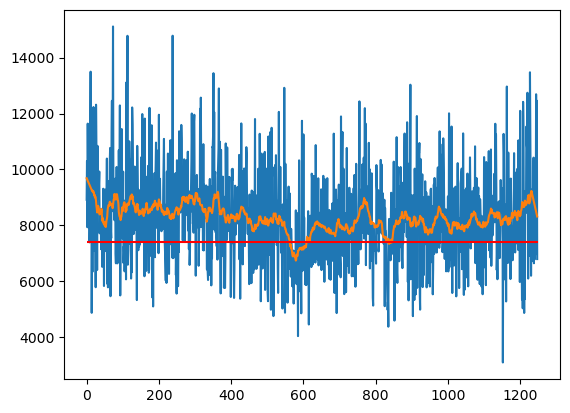

In [1286]:
plt.plot((mov.reshape(mov.shape[0],-1))[:,104000])
plt.plot(sg.savgol_filter((mov.reshape(mov.shape[0],-1))[:,104000],31,1))
plt.hlines(y=C_b10,xmin=0,xmax=C_sort.shape[0],color='red')

In [1287]:
%%time
pixo = (mov.reshape(mov.shape[0],-1)).T
pixomf = sg.savgol_filter(pixo,31,1,axis=1)

CPU times: total: 6.25 s
Wall time: 6.25 s


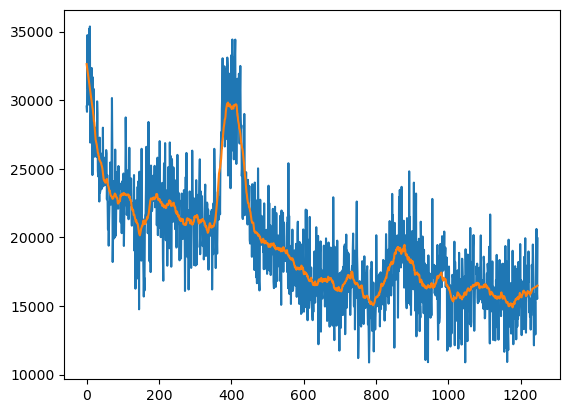

In [1288]:
plt.plot(pixo[323+252*475,...])
plt.plot(pixomf[323+252*475,...])

CPU times: total: 10.4 s
Wall time: 10.6 s


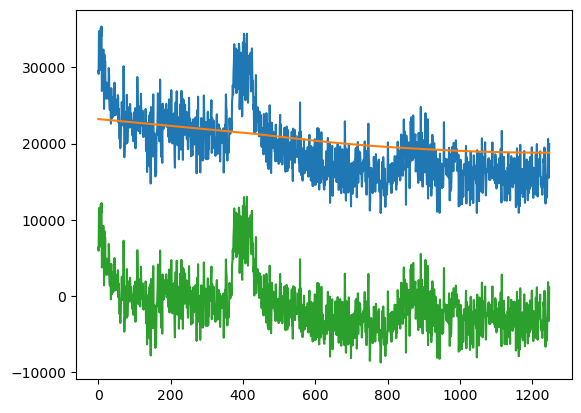

In [1289]:
%%time
# bandpass pixels
sample_rate = 31/180
def lowpass(data: np.ndarray, cutoff: float, sample_rate: float, poles: int = 5):
    sos = sg.butter(poles, cutoff, 'lowpass', fs=sample_rate, output='sos')
    filtered_data = scipy.signal.sosfiltfilt(sos, data)
    return filtered_data
def highpass(data: np.ndarray, cutoff: float, sample_rate: float, poles: int = 5):
    sos = sg.butter(poles, cutoff, 'highpass', fs=sample_rate, output='sos')
    filtered_data = scipy.signal.sosfiltfilt(sos, data)
    return filtered_data
def bandpass(data: np.ndarray, cutoff, sample_rate: float, poles: int = 5):
    sos = sg.butter(poles, cutoff, 'bandpass', fs=sample_rate, output='sos')
    filtered_data = scipy.signal.sosfiltfilt(sos, data)
    return filtered_data

times = np.arange(pixo.shape[1])/sample_rate #[...,:936]

#filtered = lowpass(cnmf_dicts_invivo_ip[l]['CY_mov_matched_raw_corr_norm1'][hdbs_invivo.labels_==c,...][...,:2400], 1/600, sample_rate)
#filtered = cnmf_dicts_invivo_ip[l]['CY_mov_matched_raw_corr_norm1'][hdbs_invivo.labels_==c,...][...,:2400]-highpass(cnmf_dicts_invivo_ip[l]['CY_mov_matched_raw_corr_norm1'][hdbs_invivo.labels_==c,...][...,:2400], 1/600, sample_rate,1)
#filtered =  bandpass(CY_m_matched_raw_corr_norm1[...,:3000], [1/8000,1/50], sample_rate,1)
#filteredu = bandpass(pixomf_dff, [1/6000,1/50], sample_rate,1) #[np.argsort(hdbs_invivo.labels_),...]
filteredu = lowpass(pixo, 1/(3*pixo.shape[1]/sample_rate), sample_rate,1) #[np.argsort(hdbs_invivo.labels_),...]
#filtered2 = bandpass(CY_m2_matched_raw_gr_corr_norm1[...,:2000], [1/4000,1/50], sample_rate,1) #[np.argsort(hdbs_invivo.labels_),...]

#from matplotlib import colors
#divnorm=colors.TwoSlopeNorm(vcenter=0)
#filteredu_sort = np.sort(filteredu,axis=1)
#filteredu_b10 = np.mean(filteredu_sort[:,:int(np.ceil(filteredu_sort.shape[1]/10))],axis=1) #[[x for x in np.arange(21).tolist() if x not in oxt_rm],...]
#filteredu_t10 = np.mean(filteredu_sort[:,-int(np.ceil(filteredu_sort.shape[1]/10)):],axis=1)
#filteredu_norm1 = ((filteredu.T-filteredu_b10)/(filteredu_t10-filteredu_b10)).T
#plt.imshow(filteredu_norm1[np.argsort(cnmf_dicts_invivo_ip[l]['row_clusts_f']),...],interpolation='nearest',aspect='auto',cmap='bwr')#,vmax=1)
plt.plot(pixo[323+252*475,...])
plt.plot(filteredu[323+252*475,...])
plt.plot((pixo-filteredu)[323+252*475,...])

#filtered2_sort = np.sort(filtered2,axis=1)
#filtered2_b10 = np.mean(filtered2_sort[:,:int(np.ceil(filtered2_sort.shape[1]/10))],axis=1) #[[x for x in np.arange(21).tolist() if x not in oxt_rm],...]
#filtered2_t10 = np.mean(filtered2_sort[:,-int(np.ceil(filtered2_sort.shape[1]/10)):],axis=1)
#filtered2_norm1 = ((filtered2.T-filtered2_b10)/(filtered2_t10-filtered2_b10)).T
#plt.imshow(filtered2_norm1[np.argsort(hdbs_slice_w.labels_),...],interpolation='nearest',aspect='auto',cmap='bwr',vmax=1)

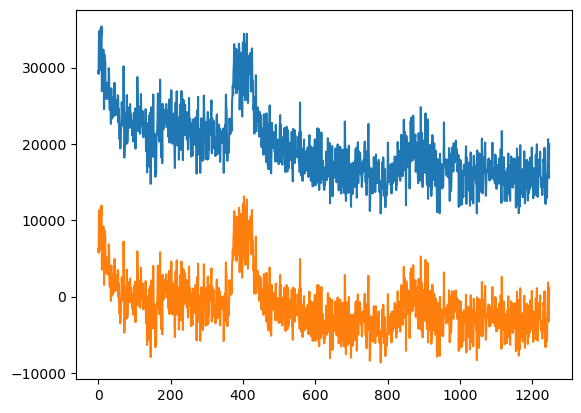

In [1290]:
filteredu2 = bandpass((pixo-filteredu), [1/190,1/170], sample_rate,1) #[np.argsort(hdbs_invivo.labels_),...]

plt.plot(pixo[323+252*475,...])
plt.plot((pixo-filteredu-filteredu2)[323+252*475,...])

In [1291]:
pixoc = pixo-filteredu-filteredu2
pixocmf = sg.savgol_filter(pixoc,31,1,axis=1)

pixomf_sort = np.sort(pixomf,axis=1)
pixocmf_sort = np.sort(pixocmf,axis=1)

pixomf_b10 = np.mean(pixomf_sort[:,:int(np.ceil(pixomf_sort.shape[1]/10))],axis=1) # bottom 10% mean
pixocmf_b10 = np.mean(pixocmf_sort[:,:int(np.ceil(pixocmf_sort.shape[1]/10))],axis=1) # bottom 10% mean

(array([64630., 55662., 34478., 19240., 10671.,  6121.,  3173.,  1624.,
          744.,   307.]),
 array([    0.        ,  6762.32257057, 13524.64514113, 20286.9677117 ,
        27049.29028227, 33811.61285283, 40573.9354234 , 47336.25799396,
        54098.58056453, 60860.9031351 , 67623.22570566]),
 <BarContainer object of 10 artists>)

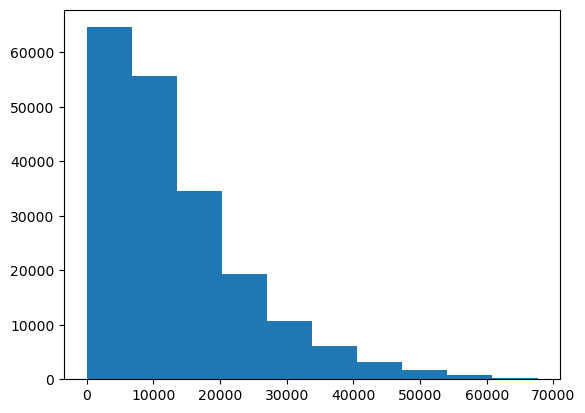

In [1292]:
plt.hist(np.max(pixomf,axis=1))

(array([78848., 63678., 31759., 12566.,  5415.,  2559.,  1031.,   425.,
          262.,   107.]),
 array([    0.        ,  6594.50692605, 13189.01385209, 19783.52077814,
        26378.02770419, 32972.53463023, 39567.04155628, 46161.54848233,
        52756.05540838, 59350.56233442, 65945.06926047]),
 <BarContainer object of 10 artists>)

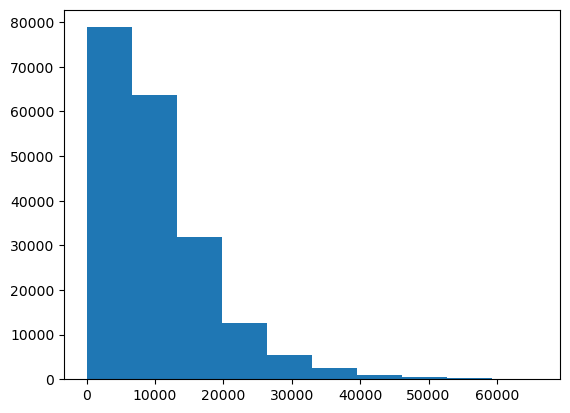

In [1293]:
plt.hist(pixomf_b10)

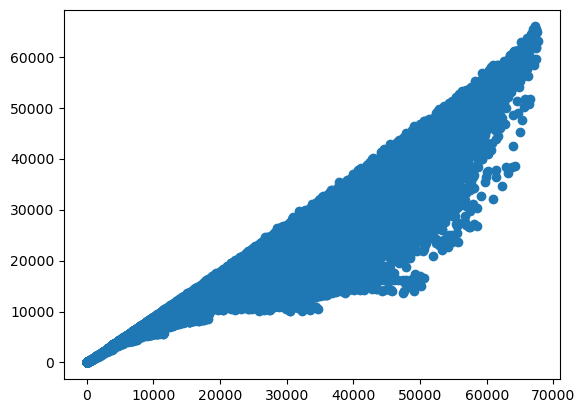

In [1294]:
plt.scatter(np.max(pixomf,axis=1),pixomf_b10)

(array([4.7650e+04, 3.6232e+04, 5.3835e+04, 3.5607e+04, 1.5681e+04,
        5.3660e+03, 1.6490e+03, 5.1400e+02, 8.8000e+01, 2.8000e+01]),
 array([    0.        ,  3191.18207097,  6382.36414193,  9573.5462129 ,
        12764.72828387, 15955.91035483, 19147.0924258 , 22338.27449676,
        25529.45656773, 28720.6386387 , 31911.82070966]),
 <BarContainer object of 10 artists>)

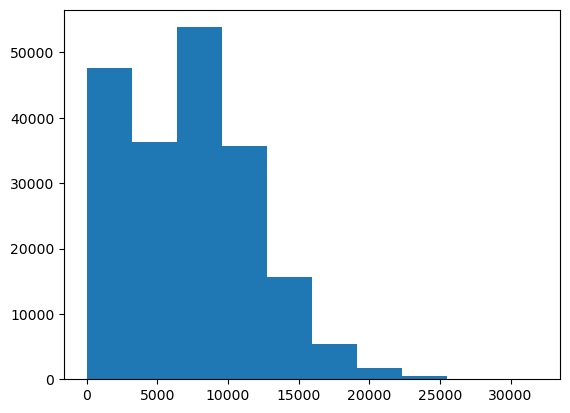

In [1295]:
plt.hist(np.max((pixoc.T-pixocmf_b10),axis=0))

In [1296]:
np.where(np.max((pixoc.T-pixocmf_b10),axis=0)<10000)[0].shape

(143595,)

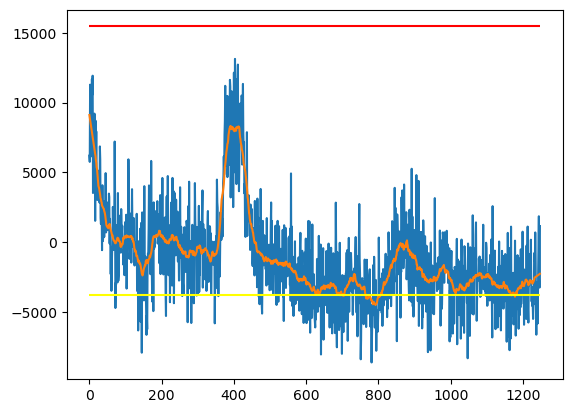

In [1297]:
plt.plot(pixoc[323+252*475,...])
plt.plot(pixocmf[323+252*475,...])
plt.hlines(y=pixomf_b10[323+252*475],xmin=0,xmax=pixoc.shape[1],color='red')
plt.hlines(y=pixocmf_b10[323+252*475],xmin=0,xmax=pixoc.shape[1],color='yellow')

C:\Users\pkalugin\AppData\Local\Temp\7\ipykernel_24584\1954383089.py:1: RuntimeWarning: invalid value encountered in divide
  pixocdff = (pixoc.T-pixocmf_b10)/pixomf_b10


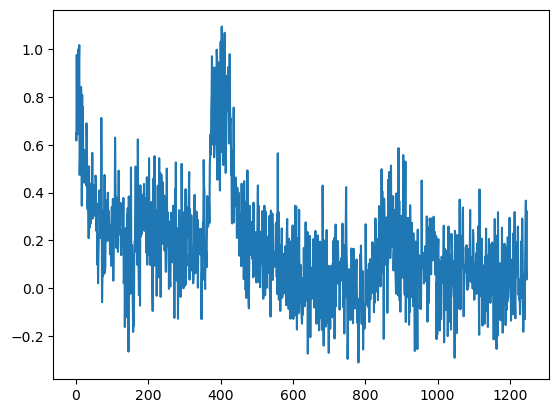

In [1298]:
pixocdff = (pixoc.T-pixocmf_b10)/pixomf_b10
plt.plot(pixocdff[...,323+252*475])

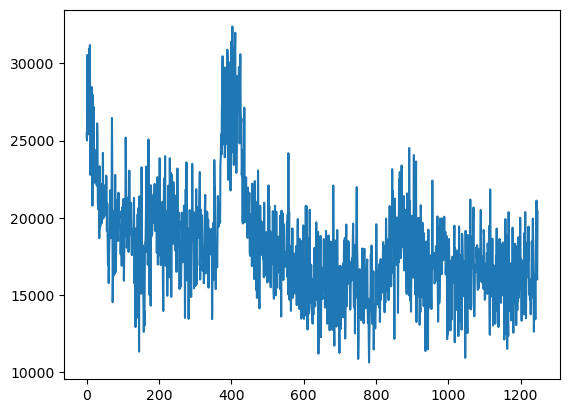

In [1299]:
pixocf = (pixoc.T-pixocmf_b10)+pixomf_b10
plt.plot(pixocf[...,323+252*475])

In [1300]:
pixocdff.T.shape

(196650, 1248)

In [1301]:
movc = pixocdff.reshape(mov.shape)
movc.shape

(1248, 414, 475)

In [1302]:
pixocdff2 = deepcopy(pixocdff)
pixocdff2[...,np.where(np.max((pixoc.T-pixocmf_b10),axis=0)<5000)[0]] = np.zeros((pixocdff.shape[0],np.where(np.max((pixoc.T-pixocmf_b10),axis=0)<5000)[0].shape[0]))

In [1303]:
movc2 = pixocdff2.reshape(mov.shape)
movc2.shape

(1248, 414, 475)

In [1304]:
movc3 = pixocf.reshape(mov.shape)
movc3.shape

(1248, 414, 475)

In [1305]:
print(fname)
print(fname[:-4]+r'_dff.tif')

\\nasquatch\data\2p\peter\grin_videos\PK49PL18_220701_101_full_wch0_aniso4_scale4AFS2PL4_toref100_wxy_nobg\movie_z10s_tds3_corr.tif
\\nasquatch\data\2p\peter\grin_videos\PK49PL18_220701_101_full_wch0_aniso4_scale4AFS2PL4_toref100_wxy_nobg\movie_z10s_tds3_corr_dff.tif


In [1306]:
imwrite(fname[:-4]+r'_dff.tif',movc)

In [1307]:
imwrite(fname[:-4]+r'_dff2.tif',movc2)

In [1308]:
imwrite(fname[:-4]+r'_f.tif',movc3)

In [1309]:
# supp video 11 dff/cleaned up f (do dff in fiji to a single baseline frame)
fname = r'\\nasquatch\data\2p\peter\grin_videos\AVG_C2-MPK14_20230510_001_max_proj1107-2r.tif'
mov = imread(fname)
mov.shape

(180, 143, 183)

In [1310]:
mov.reshape(mov.shape[0],-1).shape

(180, 26169)

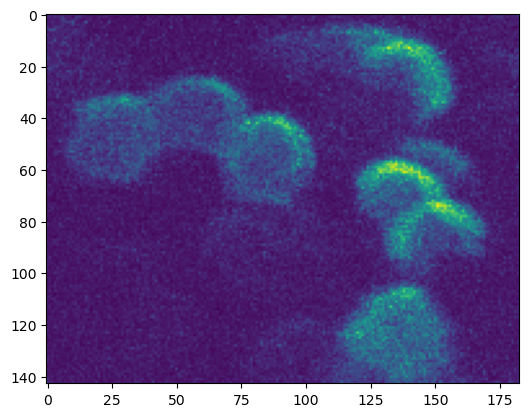

In [1450]:
plt.imshow(mov[0,...])

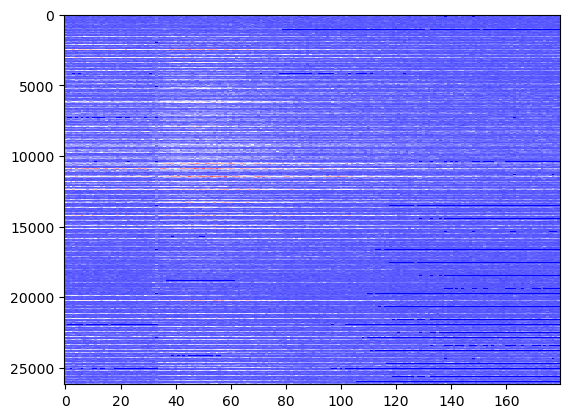

In [1451]:
plt.imshow((mov.reshape(mov.shape[0],-1)).T, interpolation='nearest', aspect='auto',cmap='bwr')

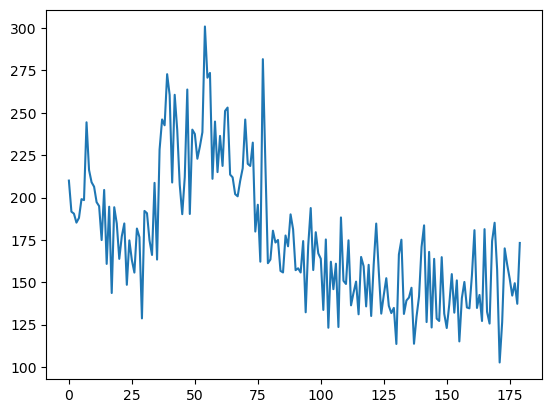

In [1452]:
plt.plot((mov.reshape(mov.shape[0],-1))[:,42+42*183])

In [1453]:
C_sort = np.sort(sg.savgol_filter((mov.reshape(mov.shape[0],-1))[:,42+42*183],31,1))
C_b10 = np.mean(C_sort[:int(np.ceil(C_sort.shape[0]/10))]) # bottom 10% mean
C_b10

142.76967

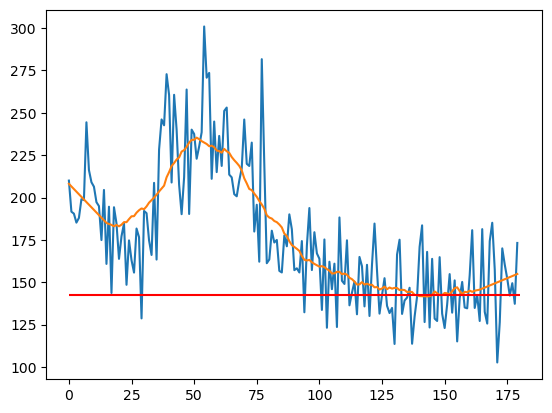

In [1454]:
plt.plot((mov.reshape(mov.shape[0],-1))[:,42+42*183])
plt.plot(sg.savgol_filter((mov.reshape(mov.shape[0],-1))[:,42+42*183],31,1))
plt.hlines(y=C_b10,xmin=0,xmax=C_sort.shape[0],color='red')

In [1455]:
%%time
pixo = (mov.reshape(mov.shape[0],-1)).T
pixomf = sg.savgol_filter(pixo,31,1,axis=1)

CPU times: total: 141 ms
Wall time: 142 ms


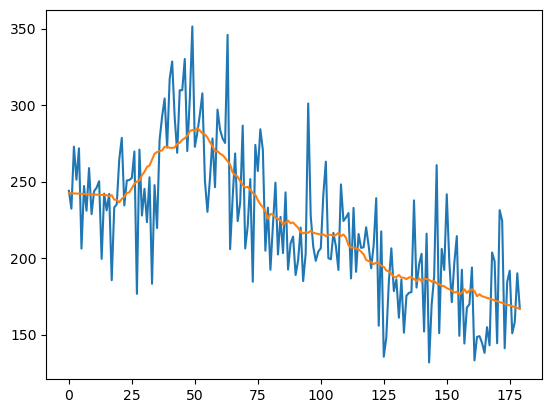

In [1456]:
plt.plot(pixo[72+54*183,...])
plt.plot(pixomf[72+54*183,...])

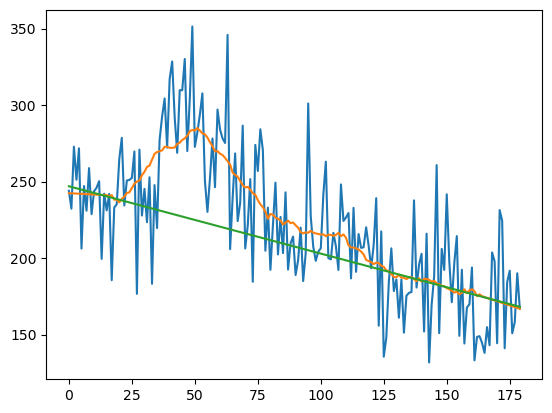

In [1457]:
xa = np.hstack((np.arange(30),np.arange(130,180)))
af = np.polyfit(xa, pixo[72+54*183,...][xa], 1)

plt.plot(pixo[72+54*183,...])
plt.plot(pixomf[72+54*183,...])
plt.plot(af[0]*np.arange(180)+af[1])

In [1458]:
%%time
xa = np.hstack((np.arange(30),np.arange(130,180)))
fixf = np.zeros(pixo.shape)
for i in trange(pixo.shape[0]):
    af = np.polyfit(xa, pixo[i,...][xa], 1)
    fixf[i,...] = af[0]*np.arange(180)+af[1]

  0%|          | 0/26169 [00:00<?, ?it/s]

CPU times: total: 2.81 s
Wall time: 2.8 s


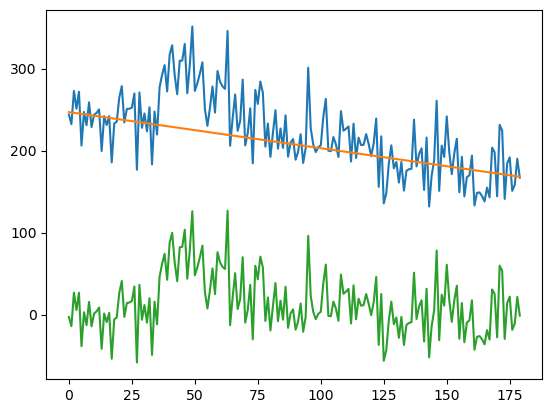

In [1459]:
plt.plot(pixo[72+54*183,...])
plt.plot(fixf[72+54*183,...])
plt.plot((pixo-fixf)[72+54*183,...])

In [1460]:
pixoc = pixo-fixf
pixocmf = sg.savgol_filter(pixoc,31,1,axis=1)

pixomf_sort = np.sort(pixomf,axis=1)
pixocmf_sort = np.sort(pixocmf,axis=1)

pixomf_b10 = np.mean(pixomf_sort[:,:int(np.ceil(pixomf_sort.shape[1]/10))],axis=1) # bottom 10% mean
pixocmf_b10 = np.mean(pixocmf_sort[:,:int(np.ceil(pixocmf_sort.shape[1]/10))],axis=1) # bottom 10% mean

(array([16390.,  3394.,  2689.,  1939.,   854.,   430.,   221.,   135.,
           93.,    24.]),
 array([120.01784515, 161.87068176, 203.72351074, 245.57633972,
        287.4291687 , 329.28198242, 371.13482666, 412.98764038,
        454.84048462, 496.69329834, 538.54614258]),
 <BarContainer object of 10 artists>)

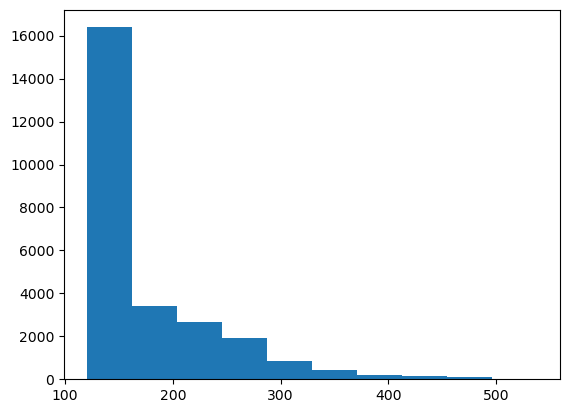

In [1461]:
plt.hist(np.max(pixomf,axis=1))

(array([ 1266.,   178.,   153.,   122., 16156.,  4956.,  2190.,   794.,
          283.,    71.]),
 array([ -1.67145824,  25.28491402,  52.24128723,  79.19766235,
        106.15403748, 133.1104126 , 160.06678772, 187.02314758,
        213.97952271, 240.93589783, 267.89227295]),
 <BarContainer object of 10 artists>)

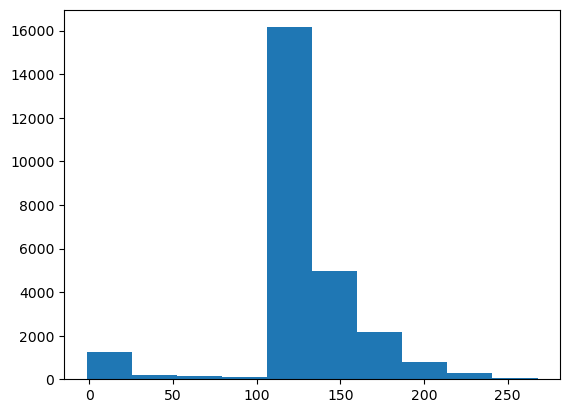

In [1462]:
plt.hist(pixomf_b10)

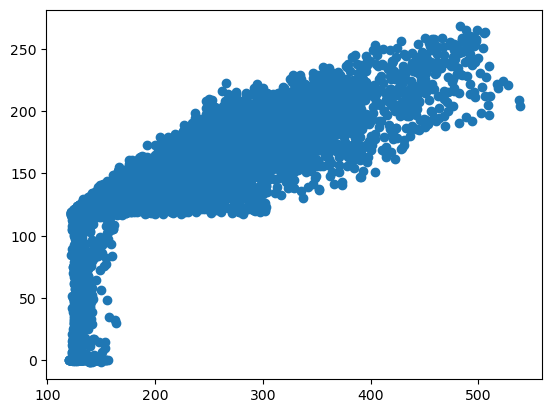

In [1463]:
plt.scatter(np.max(pixomf,axis=1),pixomf_b10)

(array([8.483e+03, 7.871e+03, 5.233e+03, 2.928e+03, 1.093e+03, 3.510e+02,
        1.250e+02, 5.400e+01, 2.700e+01, 4.000e+00]),
 array([ 18.3421653 ,  52.90593584,  87.46970638, 122.03347692,
        156.59724747, 191.16101801, 225.72478855, 260.28855909,
        294.85232963, 329.41610017, 363.97987071]),
 <BarContainer object of 10 artists>)

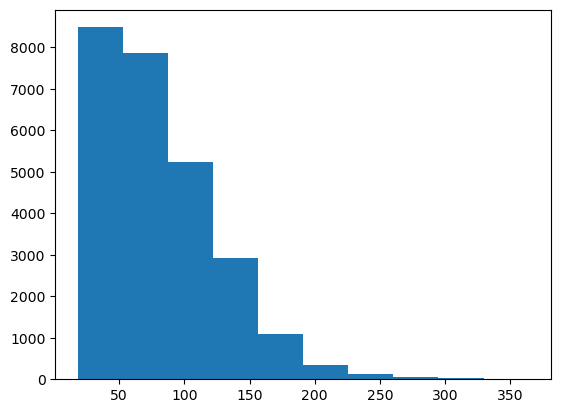

In [1464]:
plt.hist(np.max((pixoc.T-pixocmf_b10),axis=0))

In [1465]:
np.where(np.max((pixoc.T-pixocmf_b10),axis=0)<10000)[0].shape

(26169,)

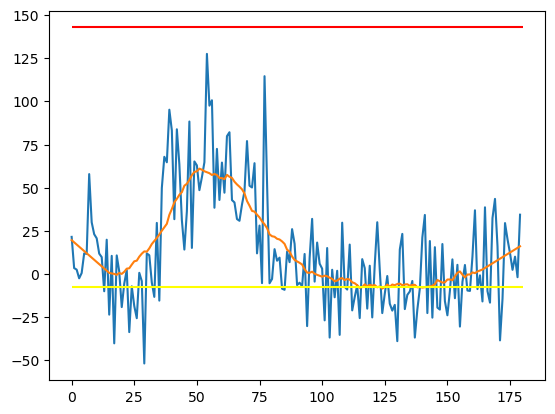

In [1466]:
plt.plot(pixoc[42+42*183,...])
plt.plot(pixocmf[42+42*183,...])
plt.hlines(y=pixomf_b10[42+42*183],xmin=0,xmax=pixoc.shape[1],color='red')
plt.hlines(y=pixocmf_b10[42+42*183],xmin=0,xmax=pixoc.shape[1],color='yellow')

C:\Users\pkalugin\AppData\Local\Temp\7\ipykernel_24584\3701932726.py:1: RuntimeWarning: divide by zero encountered in divide
  pixocdff = (pixoc.T-pixocmf_b10)/pixomf_b10


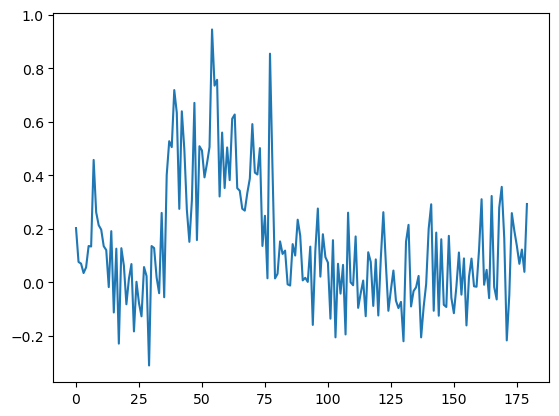

In [1467]:
pixocdff = (pixoc.T-pixocmf_b10)/pixomf_b10
plt.plot(pixocdff[...,42+42*183])

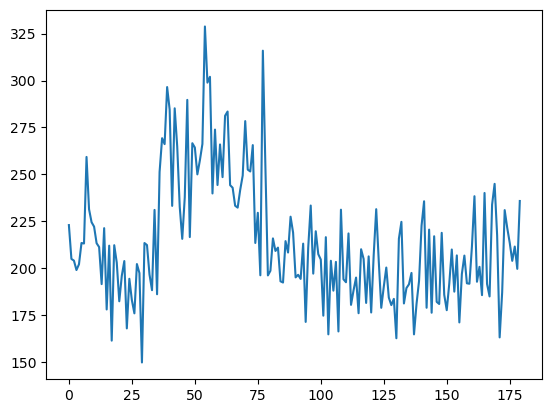

In [1468]:
pixocf = (pixoc.T-pixocmf_b10)+np.mean(pixomf[...,:20],axis=1)
plt.plot(pixocf[...,42+42*183])

In [1469]:
pixocdff.T.shape

(26169, 180)

In [1470]:
movc = pixocdff.reshape(mov.shape)
movc.shape

(180, 143, 183)

In [1471]:
pixocdff2 = deepcopy(pixocdff)
pixocdff2[...,np.where(np.max((pixoc.T-pixocmf_b10),axis=0)<5000)[0]] = np.zeros((pixocdff.shape[0],np.where(np.max((pixoc.T-pixocmf_b10),axis=0)<5000)[0].shape[0]))

In [1472]:
movc2 = pixocdff2.reshape(mov.shape)
movc2.shape

(180, 143, 183)

In [1497]:
movc3 = pixocf.reshape(mov.shape)
movc3.shape

(180, 143, 183)

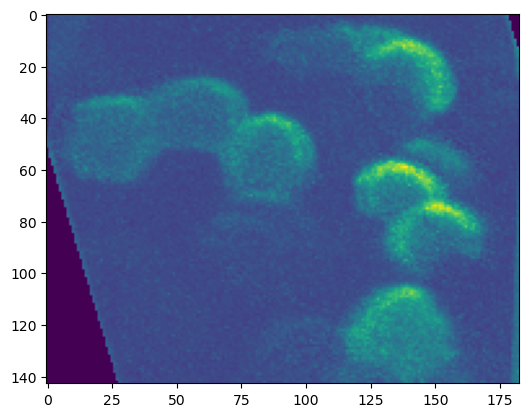

In [1498]:
plt.imshow(movc3[160,...])

In [1499]:
movc3[160,120,5]

0.0

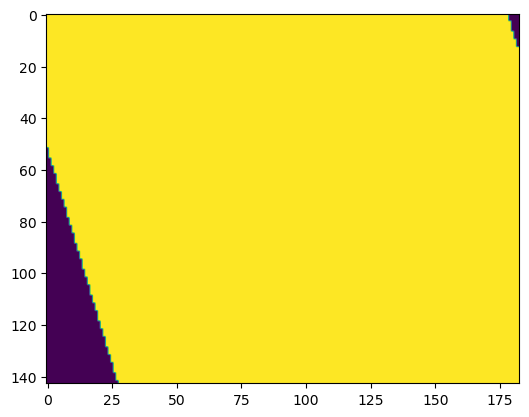

In [1500]:
plt.imshow(mov[160,...]>0)

In [1509]:
for i in trange(movc3.shape[0]):
    mtemp = deepcopy(movc3[i,...])
    movc3[i,...] = mtemp*(np.min(mov,axis=0)>0)

  0%|          | 0/180 [00:00<?, ?it/s]

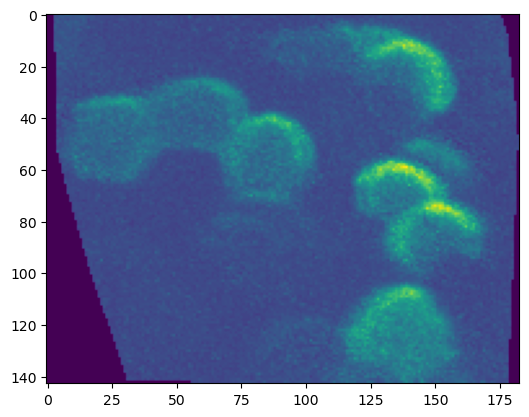

In [1510]:
plt.imshow(movc3[160,...])

In [1511]:
movc3[160,120,5]

0.0

In [1512]:
print(fname)
print(fname[:-4]+r'_dff.tif')

\\nasquatch\data\2p\peter\grin_videos\AVG_C2-MPK14_20230510_001_max_proj1107-2r.tif
\\nasquatch\data\2p\peter\grin_videos\AVG_C2-MPK14_20230510_001_max_proj1107-2r_dff.tif


In [1513]:
imwrite(fname[:-4]+r'_dff.tif',movc)

In [1514]:
imwrite(fname[:-4]+r'_dff2.tif',movc2)

In [1515]:
imwrite(fname[:-4]+r'_f.tif',movc3)

In [ ]:
# NEW supp video 3: PL48_230916_101 pre vs post warp
# first: memmap into original sbx or ch0/ch1 aligned raw rate movies and pick 3 planes to mean over every 3 timepoints
# second: remove flashing artifacts
# third: additional bandpass cleanup

In [175]:
# If i want to update stardist
import sys
import socket
from pystackreg import StackReg
from IPython.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))
from skimage import filters
import numpy as np
from tifffile import imsave as tif_imsave
from tifffile import imwrite as tif_imwrite

from tifffile import imread as tif_imread
from csbdeep.utils import normalize

import matplotlib.pyplot as plt
import sys
from tqdm.auto import tqdm
sys.path.append('/home/oamsalem/code/Projects/EZfish')
sys.path.append('/home/oamsalem/code/Projects/EZfish')
sys.path.append(r'C:\Users\oamsalem\Projects\EZfish')

from sbxreader import sbx_memmap
import os
from pathlib import Path
from skimage.morphology import disk
from funs.par_funcs import regist_stack_parallel,filter_data_parallel
#import regist_stack_parallel

from scipy import signal as sg

import scipy
from copy import deepcopy

In [18]:
def set_reg_obj(reg_method):
    if reg_method =='AFFINE':
        sr = StackReg(StackReg.AFFINE)
    elif reg_method == 'RIGID_BODY':
        sr = StackReg(StackReg.RIGID_BODY)
    elif reg_method == '':
        return None
    else:
        raise Exception("Implement")
    return sr

def regist_stack(stack, filtered_stack, sr):
    if sr==None:
        return stack
    
    reg_stack = np.zeros_like(filtered_stack)
    #raise Exception("I have a bug herer, I am registering all planes per t, this is stupid!!")
    for pn in np.arange(filtered_stack.shape[1]):
        tmats = sr.register_stack(filtered_stack[:,pn].astype(np.float64), reference='mean')
        reg_stack[:,pn] = sr.transform_stack(stack[:,pn].astype(np.float64), tmats=tmats)
    return reg_stack

def filter_data(stack, filter_pipe):
    if filter_pipe == '':
        return stack.astype(np.float64)
    
    filtered_stack = stack.copy().astype(np.float64)

    for p in range(stack.shape[0]):
        for s in range(stack[p].shape[0]):
            img = stack[p][s]
            if 'guas' in filter_pipe:
                img = img - gaussian(img,filter_pipe['guas'])
            if 'med' in filter_pipe:
                img = img -  filters.median(img, disk(filter_pipe['med']))
            filtered_stack[p][s] = img
    return filtered_stack

def apply_func(stack,fun):
    if fun == 'mean':
        stack = np.mean(stack,0)
    if fun == 'max':
        stack = np.max(stack,0)
    if fun == 'median':
        stack = np.median(stack,0)
    return stack.astype(np.float32)

In [24]:
base_path = r'//nasquatch/data/2p/peter/'
paths = [r'dipping/20230916_PL48/PL48_230916_101_full.sbx']

bounds = [(230,740,13,463)]
jumps = [3]

In [25]:
#print(sbxs0)
#print(sbxs)
#print(f'{exp_folder}/PK44PL17_220622_{sbxs[0]}.sbx')
#for sbx_n in sbxs:
#    print(f'{exp_folder}/PK44PL17_220622abcde_{sbx_n}.sbx')
#print(i)
#print(dat[i-1:i+jump-1,:,ch,bounds[2]:bounds[3],bounds[0]:bounds[1]].shape)
from tqdm.auto import trange
len(paths)
#len(bounds)
len(jumps)
jumps[0]

!!! very important to check all metadata files are working!
for p in trange(0,len(paths)):
    path = Path(f'{base_path}{paths[p]}')
    #path
    print(path)
    dat = sbx_memmap(path)
    print(dat.shape)
path = Path(f'{base_path}{paths[0]}')
path
#r_st = 1
#r_en = int(dat.shape[0])
#print(dat.shape, list(range(r_st, r_en, jumps[12])))
#path.stem[-8:] == '101_full'
#path.parent

  0%|          | 0/1 [00:00<?, ?it/s]

\\nasquatch\data\2p\peter\dipping\20230916_PL48\PL48_230916_101_full.sbx
(2511, 30, 2, 512, 796)


WindowsPath('//nasquatch/data/2p/peter/dipping/20230916_PL48/PL48_230916_101_full.sbx')

In [26]:
dat.shape # original movie memmap into sbx

(2511, 30, 2, 512, 796)

In [27]:
read_path = Path(f'{base_path}{paths[0]}')
dat = sbx_memmap(read_path)
print(dat.shape)
jump = jumps[0]
i = 1
stack = np.array(dat[i-1:i+jump-1,:,:,bounds[p][2]:bounds[p][3],bounds[p][0]:bounds[p][1]])
stack.shape

(2511, 30, 2, 512, 796)


(3, 30, 2, 450, 510)

In [28]:
loaded_stack_f = apply_func(stack, 'mean')
loaded_stack_f.shape

(30, 2, 450, 510)

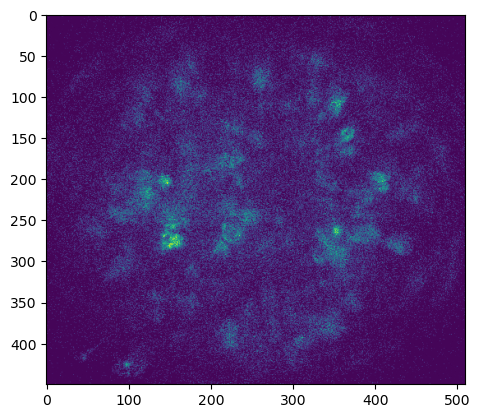

In [29]:
plt.imshow(loaded_stack_f[15,0,...])

In [30]:
paths2 = [r'dipping/20230916_PL48/PL48_230916_101_full_wch0_aniso4_scale4AFS2PL4_toref40_wxy.npy',
         r'dipping/20230916_PL48/PL48_230916_101_full_wch1_aniso4_scale4AFS2PL4_toref40_wxy.npy']

In [31]:
dat2 = np.load(Path(f'{base_path}{paths2[0]}'),mmap_mode='r+')
dat2.shape

(2, 450, 510, 30, 2511)

In [32]:
dat3 = np.load(Path(f'{base_path}{paths2[1]}'),mmap_mode='r+')
dat3.shape
# project layers 9-14 (8:14 python) - 6 layers, ~55 um thickness, dimming means it's moving out of stack

(2, 450, 510, 30, 2511)

In [41]:
ch = 0

In [60]:
datx = []
for i in trange(int(dat.shape[0]/jump)):
    stack = np.array(dat[i*jump:(i+1)*jump,8:14,ch,bounds[p][2]:bounds[p][3],bounds[p][0]:bounds[p][1]])
    datx.append(np.mean(stack.transpose([2,3,0,1]).reshape([stack.shape[2],stack.shape[3],-1]),axis=-1))
np.array(datx).shape

  0%|          | 0/837 [00:00<?, ?it/s]

(837, 450, 510)

In [65]:
datx2 = []
for i in trange(int(dat2.shape[-1]/jump)):
    stack = np.array(dat2[ch,:,:,8:14,i*jump:(i+1)*jump])
    datx2.append(np.mean(stack.reshape([stack.shape[0],stack.shape[1],-1]),axis=-1))
np.array(datx2).shape

  0%|          | 0/837 [00:00<?, ?it/s]

(837, 450, 510)

In [66]:
datx3 = []
for i in trange(int(dat3.shape[-1]/jump)):
    stack = np.array(dat3[ch,:,:,8:14,i*jump:(i+1)*jump])
    datx3.append(np.mean(stack.reshape([stack.shape[0],stack.shape[1],-1]),axis=-1))
np.array(datx3).shape

  0%|          | 0/837 [00:00<?, ?it/s]

(837, 450, 510)

In [76]:
tif_imwrite(base_path + paths[0][:-4] + r'_z6x_tds3.tif',np.array(datx))
tif_imwrite(base_path + paths2[0][:-4] + r'_z6x_tds3.tif',np.array(datx2))
tif_imwrite(base_path + paths2[1][:-4] + r'_z6x_tds3.tif',np.array(datx3))

In [78]:
# NEW SV 3 - original
fname = base_path + paths[0][:-4] + r'_z6x_tds3.tif'
mov = tif_imread(fname)
mov.shape

(837, 415, 484)

In [79]:
mov.reshape(mov.shape[0],-1).shape

(837, 200860)

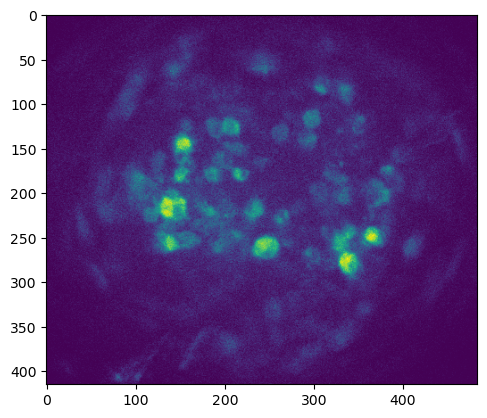

In [80]:
plt.imshow(mov[0,...])

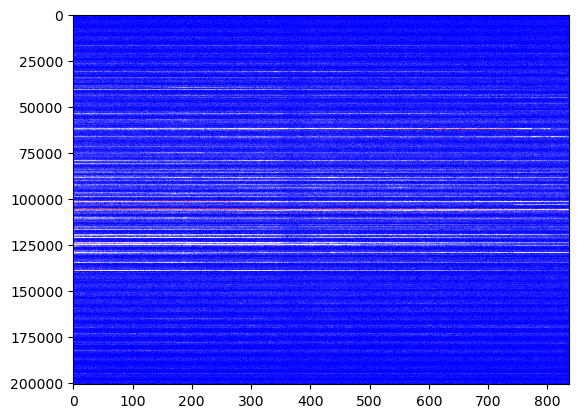

In [81]:
plt.imshow((mov.reshape(mov.shape[0],-1)).T, interpolation='nearest', aspect='auto',cmap='bwr')

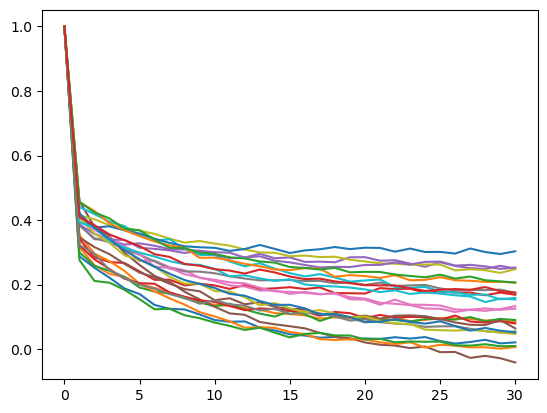

In [100]:
jump = 31
#for k in range(jump-2,jump*2,jump):
fit_range = np.array([0,1,2,3,4,5,6,7,8,9,12,13,14,15,16,17,18,19,20,21,22,23,24,25])
for k in list(jump+fit_range*jump):
    # Create histogram
    hist, bin_edges = np.histogram(((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))/(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)+0.4), bins=50)
    
    # Find the index of the bin with the highest frequency
    mode_index = np.argmax(hist)
    
    # Calculate the mode value
    mode_value = np.max([(bin_edges[mode_index] + bin_edges[mode_index + 1]) / 2,0.1])

    #mode_value = 1.5*mode_value
    
    plt.plot(np.mean(((mov.reshape(mov.shape[0],-1))[k:k+jump]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))[:,np.where((((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))/(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)+0.4))>mode_value)[0]]/((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))[np.where((((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))/(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)+0.4))>mode_value)[0]],1))

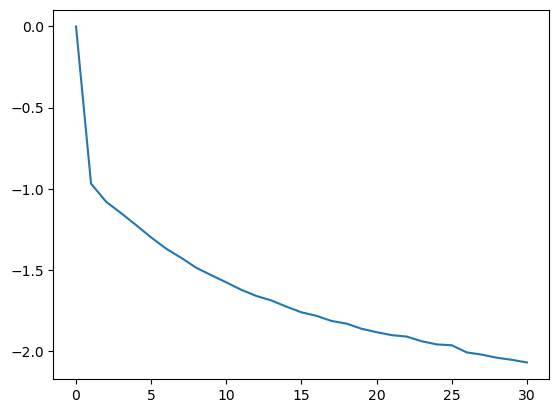

In [101]:
a = []
#jump = 3*mean_factor_slice_d[l]
#fit_range = fit_ranges_slice_d[l]
for k in list(jump+fit_range*jump):
    # Create histogram
    hist, bin_edges = np.histogram(((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))/(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)+0.4), bins=50)
    
    # Find the index of the bin with the highest frequency
    mode_index = np.argmax(hist)
    
    # Calculate the mode value
    mode_value = np.max([(bin_edges[mode_index] + bin_edges[mode_index + 1]) / 2,0.1])

    #mode_value = 1.5*mode_value
    
    a.append(np.mean(((mov.reshape(mov.shape[0],-1))[k:k+jump]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))[:,np.where((((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))/(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)+0.4))>mode_value)[0]]/((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))[np.where((((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))/(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)+0.4))>mode_value)[0]],1))
plt.plot(np.log(np.mean(np.array(a),0)))

[-0.96901691  0.        ]


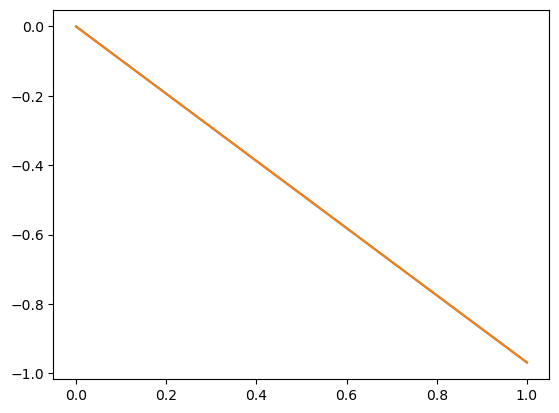

In [103]:
#a = []
#jump = 3*mean_factor_slice_d[l]
#fit_range = fit_ranges_slice_d[l]
#for k in list(jump-2+fit_range*jump):
#    a.append(np.mean(((cnmf_dicts_slice_d[l]['CY_m_raw'][np.argsort(cnmf_dicts_slice_d[l]['rises']),...].T)[k:k+jump]-(cnmf_dicts_slice_d[l]['CY_m_raw'][np.argsort(cnmf_dicts_slice_d[l]['rises']),...].T)[k])/((cnmf_dicts_slice_d[l]['CY_m_raw'][np.argsort(cnmf_dicts_slice_d[l]['rises']),...].T)[k+2]-np.mean((cnmf_dicts_slice_d[l]['CY_m_raw'][np.argsort(cnmf_dicts_slice_d[l]['rises']),...].T)[k-5:k],0)),1))
xa = np.arange(2)
ya = np.mean(np.array(a)[:,:2],0)
af = np.polyfit(xa, np.log(ya), 1)
print(af)
plt.plot(np.log(np.mean(np.array(a)[:,:2],0)))
plt.plot(af[0]*xa+af[1])

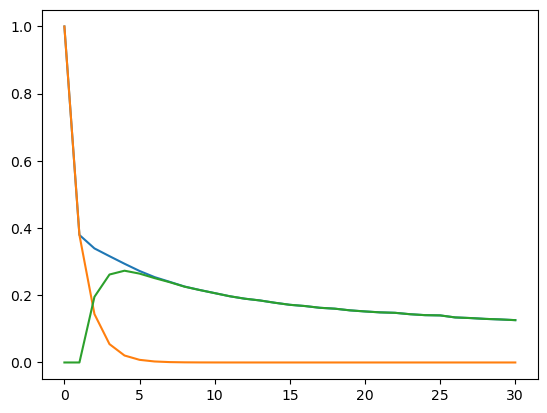

In [105]:
plt.plot(np.mean(np.array(a),0))
plt.plot(np.exp(af[0]*np.arange(31)+af[1]))
plt.plot(np.mean(np.array(a),0)-np.exp(af[0]*np.arange(31)+af[1]))

In [106]:
dfs = []
#jump = 3*mean_factor_slice_d[l]

for k in trange(jump,mov.reshape(mov.shape[0],-1).shape[0]-1,jump):
    # Create histogram
    #hist, bin_edges = np.histogram(((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))/(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)+0.4), bins=50)
    
    # Find the index of the bin with the highest frequency
    #mode_index = np.argmax(hist)
    
    # Calculate the mode value
    #mode_value = np.max([(bin_edges[mode_index] + bin_edges[mode_index + 1]) / 2,0.1])
        
    df = np.zeros(mov.reshape(mov.shape[0],-1).shape[1])
    df[np.where((mov.reshape(mov.shape[0],-1).T[:,k]-np.mean(mov.reshape(mov.shape[0],-1).T[:,k-5:k],1))>0)[0]] = (mov.reshape(mov.shape[0],-1).T[:,k]-np.mean(mov.reshape(mov.shape[0],-1).T[:,k-5:k],1))[np.where((mov.reshape(mov.shape[0],-1).T[:,k]-np.mean(mov.reshape(mov.shape[0],-1).T[:,k-5:k],1))>0)[0]]
    
    dfs.append(df)

mcb = np.zeros(mov.reshape(mov.shape[0],-1).T.shape)
for d in trange(np.array(dfs).shape[0]):
    #mcb[:,jump*(d+1):np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1,jump*(d+2)-1)] = mcb[:,jump*(d+1):np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1,jump*(d+2)-1)]+np.broadcast_to(np.exp(af[0]*np.arange(0,np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1-jump*(d+1),jump-1)))+np.exp(af2[0]*np.arange(0,np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1-jump*(d+1),jump-1))),(np.array(dfs).shape[1],) + (np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1-jump*(d+1),jump-1),))*np.array(dfs)[d,:][...,np.newaxis]
    mcb[:,jump*(d+1):np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1,jump*(d+2)-1)] = mcb[:,jump*(d+1):np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1,jump*(d+2)-1)]+np.broadcast_to(np.exp(af[0]*np.arange(0,np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1-jump*(d+1),jump-1))),(np.array(dfs).shape[1],) + (np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1-jump*(d+1),jump-1),))*np.array(dfs)[d,:][...,np.newaxis]

#cnmf_dicts_slice_d[l]['CY_m_raw_corr'] = cnmf_dicts_slice_d[l]['CY_m_raw']-cnmf_dicts_slice_d[l]['corrbase']

#cnmf_dicts_slice_d[l]['CY_m_raw_corr_sort'] = np.sort(cnmf_dicts_slice_d[l]['CY_m_raw_corr'],axis=1)
#cnmf_dicts_slice_d[l]['CY_m_raw_corr_b10'] = np.mean(cnmf_dicts_slice_d[l]['CY_m_raw_corr_sort'][:,:int(np.ceil(cnmf_dicts_slice_d[l]['CY_m_raw_corr_sort'].shape[1]/10))],axis=1) # bottom 10% mean
#cnmf_dicts_slice_d[l]['CY_m_raw_corr_t10'] = np.mean(cnmf_dicts_slice_d[l]['CY_m_raw_corr_sort'][:,-int(np.ceil(cnmf_dicts_slice_d[l]['CY_m_raw_corr_sort'].shape[1]/10)):],axis=1) # top 10% mean

#cnmf_dicts_slice_d[l]['CY_m_raw_corr_dff'] = ((cnmf_dicts_slice_d[l]['CY_m_raw_corr'].T-cnmf_dicts_slice_d[l]['CY_m_raw_corr_b10'])/(cnmf_dicts_slice_d[l]['CY_m_raw_corr_b10'])).T
#cnmf_dicts_slice_d[l]['CY_m_raw_corr_norm1'] = ((cnmf_dicts_slice_d[l]['CY_m_raw_corr'].T-cnmf_dicts_slice_d[l]['CY_m_raw_corr_b10'])/(cnmf_dicts_slice_d[l]['CY_m_raw_corr_t10']-cnmf_dicts_slice_d[l]['CY_m_raw_corr_b10'])).T

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

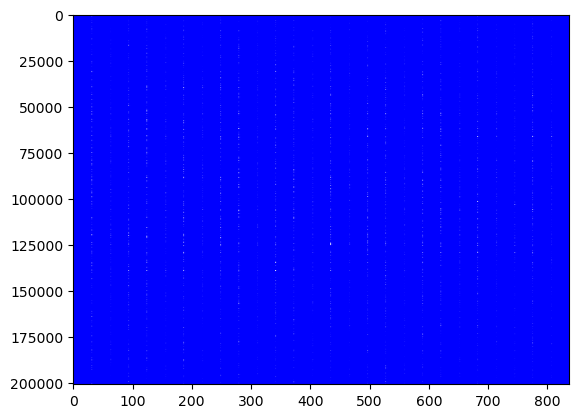

In [107]:
plt.imshow(mcb, interpolation='nearest', aspect='auto',cmap='bwr')

In [108]:
movc = mov-mcb.T.reshape(mov.shape)
movc.shape

(837, 415, 484)

In [109]:
for d in trange(np.array(dfs).shape[0]):
    movc[jump*(d+1),...] = np.mean([movc[jump*(d+1)-1,...],movc[jump*(d+1)+1,...]],axis=0)

  0%|          | 0/26 [00:00<?, ?it/s]

In [110]:
print(fname)
print(fname[:-4]+r'_corr.tif')

//nasquatch/data/2p/peter/dipping/20230916_PL48/PL48_230916_101_full_z6x_tds3.tif
//nasquatch/data/2p/peter/dipping/20230916_PL48/PL48_230916_101_full_z6x_tds3_corr.tif


In [112]:
tif_imwrite(fname[:-4]+r'_corr.tif',movc)

In [114]:
# NEW SV 3 - green warp
fname = base_path + paths2[0][:-4] + r'_z6x_tds3.tif'
mov = tif_imread(fname)
mov.shape

(837, 415, 484)

In [115]:
mov.reshape(mov.shape[0],-1).shape

(837, 200860)

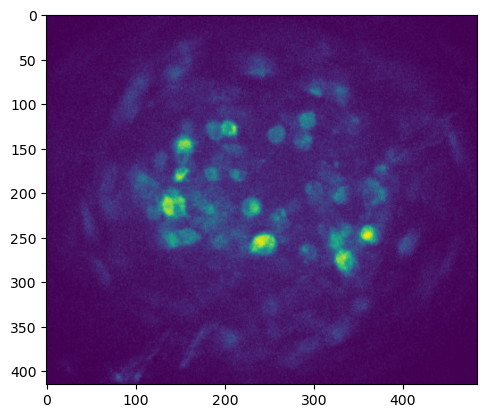

In [116]:
plt.imshow(mov[0,...])

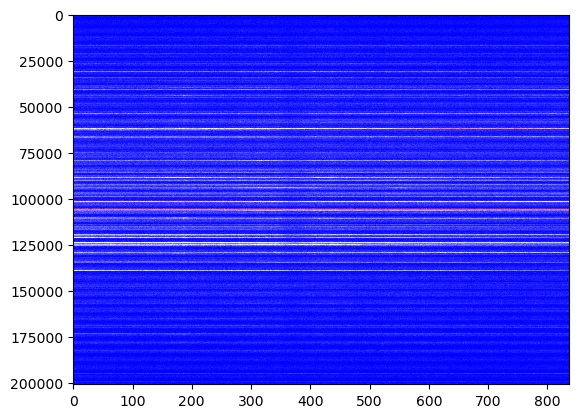

In [117]:
plt.imshow((mov.reshape(mov.shape[0],-1)).T, interpolation='nearest', aspect='auto',cmap='bwr')

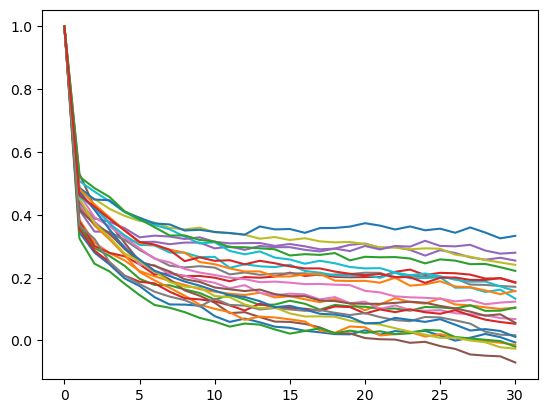

In [120]:
jump = 31
#for k in range(jump-2,jump*2,jump):
fit_range = np.array([0,1,2,3,4,5,6,7,8,9,12,13,14,15,16,17,18,19,20,21,22,23,24,25])
for k in list(jump+fit_range*jump):
    # Create histogram
    hist, bin_edges = np.histogram(((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))/(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)+0.4), bins=50)
    
    # Find the index of the bin with the highest frequency
    mode_index = np.argmax(hist)
    
    # Calculate the mode value
    mode_value = np.max([(bin_edges[mode_index] + bin_edges[mode_index + 1]) / 2,0.1])

    #mode_value = 1.5*mode_value
    
    plt.plot(np.mean(((mov.reshape(mov.shape[0],-1))[k:k+jump]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))[:,np.where((((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))/(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)+0.4))>mode_value)[0]]/((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))[np.where((((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))/(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)+0.4))>mode_value)[0]],1))

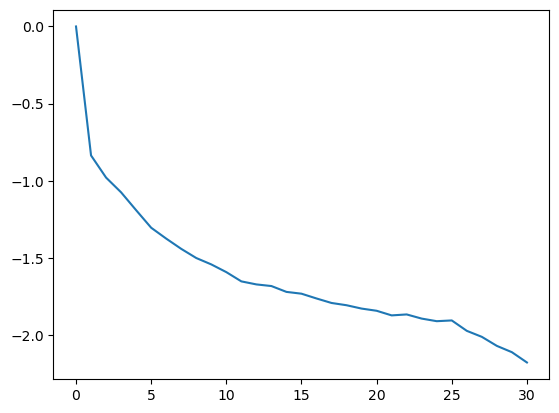

In [121]:
a = []
#jump = 3*mean_factor_slice_d[l]
#fit_range = fit_ranges_slice_d[l]
for k in list(jump+fit_range*jump):
    # Create histogram
    hist, bin_edges = np.histogram(((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))/(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)+0.4), bins=50)
    
    # Find the index of the bin with the highest frequency
    mode_index = np.argmax(hist)
    
    # Calculate the mode value
    mode_value = np.max([(bin_edges[mode_index] + bin_edges[mode_index + 1]) / 2,0.1])

    #mode_value = 1.5*mode_value
    
    a.append(np.mean(((mov.reshape(mov.shape[0],-1))[k:k+jump]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))[:,np.where((((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))/(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)+0.4))>mode_value)[0]]/((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))[np.where((((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))/(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)+0.4))>mode_value)[0]],1))
plt.plot(np.log(np.mean(np.array(a),0)))

[-0.83572203  0.        ]


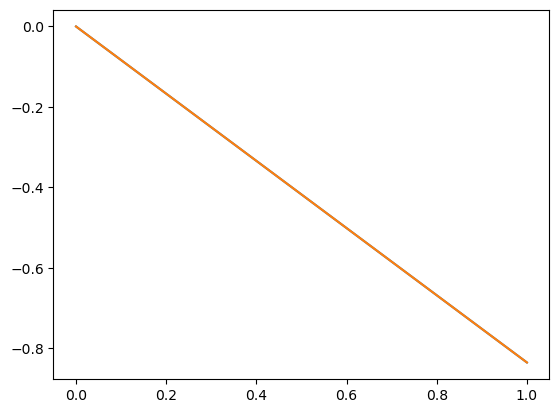

In [122]:
#a = []
#jump = 3*mean_factor_slice_d[l]
#fit_range = fit_ranges_slice_d[l]
#for k in list(jump-2+fit_range*jump):
#    a.append(np.mean(((cnmf_dicts_slice_d[l]['CY_m_raw'][np.argsort(cnmf_dicts_slice_d[l]['rises']),...].T)[k:k+jump]-(cnmf_dicts_slice_d[l]['CY_m_raw'][np.argsort(cnmf_dicts_slice_d[l]['rises']),...].T)[k])/((cnmf_dicts_slice_d[l]['CY_m_raw'][np.argsort(cnmf_dicts_slice_d[l]['rises']),...].T)[k+2]-np.mean((cnmf_dicts_slice_d[l]['CY_m_raw'][np.argsort(cnmf_dicts_slice_d[l]['rises']),...].T)[k-5:k],0)),1))
xa = np.arange(2)
ya = np.mean(np.array(a)[:,:2],0)
af = np.polyfit(xa, np.log(ya), 1)
print(af)
plt.plot(np.log(np.mean(np.array(a)[:,:2],0)))
plt.plot(af[0]*xa+af[1])

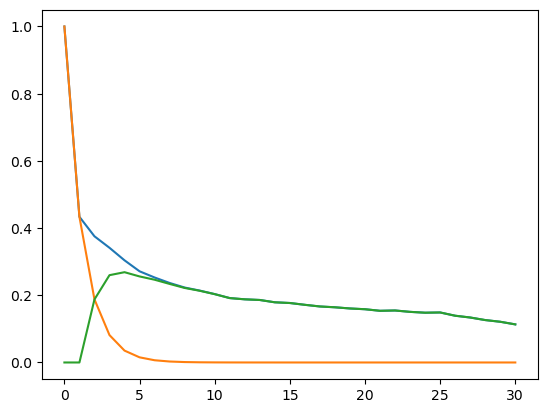

In [123]:
plt.plot(np.mean(np.array(a),0))
plt.plot(np.exp(af[0]*np.arange(31)+af[1]))
plt.plot(np.mean(np.array(a),0)-np.exp(af[0]*np.arange(31)+af[1]))

In [124]:
dfs = []
#jump = 3*mean_factor_slice_d[l]

for k in trange(jump,mov.reshape(mov.shape[0],-1).shape[0]-1,jump):
    # Create histogram
    #hist, bin_edges = np.histogram(((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))/(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)+0.4), bins=50)
    
    # Find the index of the bin with the highest frequency
    #mode_index = np.argmax(hist)
    
    # Calculate the mode value
    #mode_value = np.max([(bin_edges[mode_index] + bin_edges[mode_index + 1]) / 2,0.1])
        
    df = np.zeros(mov.reshape(mov.shape[0],-1).shape[1])
    df[np.where((mov.reshape(mov.shape[0],-1).T[:,k]-np.mean(mov.reshape(mov.shape[0],-1).T[:,k-5:k],1))>0)[0]] = (mov.reshape(mov.shape[0],-1).T[:,k]-np.mean(mov.reshape(mov.shape[0],-1).T[:,k-5:k],1))[np.where((mov.reshape(mov.shape[0],-1).T[:,k]-np.mean(mov.reshape(mov.shape[0],-1).T[:,k-5:k],1))>0)[0]]
    
    dfs.append(df)

mcb = np.zeros(mov.reshape(mov.shape[0],-1).T.shape)
for d in trange(np.array(dfs).shape[0]):
    #mcb[:,jump*(d+1):np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1,jump*(d+2)-1)] = mcb[:,jump*(d+1):np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1,jump*(d+2)-1)]+np.broadcast_to(np.exp(af[0]*np.arange(0,np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1-jump*(d+1),jump-1)))+np.exp(af2[0]*np.arange(0,np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1-jump*(d+1),jump-1))),(np.array(dfs).shape[1],) + (np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1-jump*(d+1),jump-1),))*np.array(dfs)[d,:][...,np.newaxis]
    mcb[:,jump*(d+1):np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1,jump*(d+2)-1)] = mcb[:,jump*(d+1):np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1,jump*(d+2)-1)]+np.broadcast_to(np.exp(af[0]*np.arange(0,np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1-jump*(d+1),jump-1))),(np.array(dfs).shape[1],) + (np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1-jump*(d+1),jump-1),))*np.array(dfs)[d,:][...,np.newaxis]

#cnmf_dicts_slice_d[l]['CY_m_raw_corr'] = cnmf_dicts_slice_d[l]['CY_m_raw']-cnmf_dicts_slice_d[l]['corrbase']

#cnmf_dicts_slice_d[l]['CY_m_raw_corr_sort'] = np.sort(cnmf_dicts_slice_d[l]['CY_m_raw_corr'],axis=1)
#cnmf_dicts_slice_d[l]['CY_m_raw_corr_b10'] = np.mean(cnmf_dicts_slice_d[l]['CY_m_raw_corr_sort'][:,:int(np.ceil(cnmf_dicts_slice_d[l]['CY_m_raw_corr_sort'].shape[1]/10))],axis=1) # bottom 10% mean
#cnmf_dicts_slice_d[l]['CY_m_raw_corr_t10'] = np.mean(cnmf_dicts_slice_d[l]['CY_m_raw_corr_sort'][:,-int(np.ceil(cnmf_dicts_slice_d[l]['CY_m_raw_corr_sort'].shape[1]/10)):],axis=1) # top 10% mean

#cnmf_dicts_slice_d[l]['CY_m_raw_corr_dff'] = ((cnmf_dicts_slice_d[l]['CY_m_raw_corr'].T-cnmf_dicts_slice_d[l]['CY_m_raw_corr_b10'])/(cnmf_dicts_slice_d[l]['CY_m_raw_corr_b10'])).T
#cnmf_dicts_slice_d[l]['CY_m_raw_corr_norm1'] = ((cnmf_dicts_slice_d[l]['CY_m_raw_corr'].T-cnmf_dicts_slice_d[l]['CY_m_raw_corr_b10'])/(cnmf_dicts_slice_d[l]['CY_m_raw_corr_t10']-cnmf_dicts_slice_d[l]['CY_m_raw_corr_b10'])).T

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

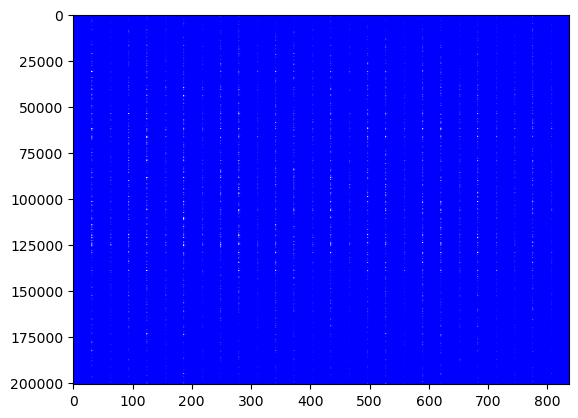

In [125]:
plt.imshow(mcb, interpolation='nearest', aspect='auto',cmap='bwr')

In [126]:
movc = mov-mcb.T.reshape(mov.shape)
movc.shape

(837, 415, 484)

In [127]:
for d in trange(np.array(dfs).shape[0]):
    movc[jump*(d+1),...] = np.mean([movc[jump*(d+1)-1,...],movc[jump*(d+1)+1,...]],axis=0)

  0%|          | 0/26 [00:00<?, ?it/s]

In [128]:
print(fname)
print(fname[:-4]+r'_corr.tif')

//nasquatch/data/2p/peter/dipping/20230916_PL48/PL48_230916_101_full_wch0_aniso4_scale4AFS2PL4_toref40_wxy_z6x_tds3.tif
//nasquatch/data/2p/peter/dipping/20230916_PL48/PL48_230916_101_full_wch0_aniso4_scale4AFS2PL4_toref40_wxy_z6x_tds3_corr.tif


In [129]:
tif_imwrite(fname[:-4]+r'_corr.tif',movc)

In [130]:
# NEW SV 3 - red warp
fname = base_path + paths2[1][:-4] + r'_z6x_tds3.tif'
mov = tif_imread(fname)
mov.shape

(837, 415, 484)

In [131]:
mov.reshape(mov.shape[0],-1).shape

(837, 200860)

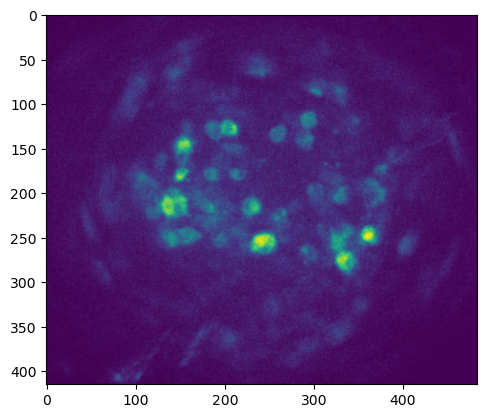

In [132]:
plt.imshow(mov[0,...])

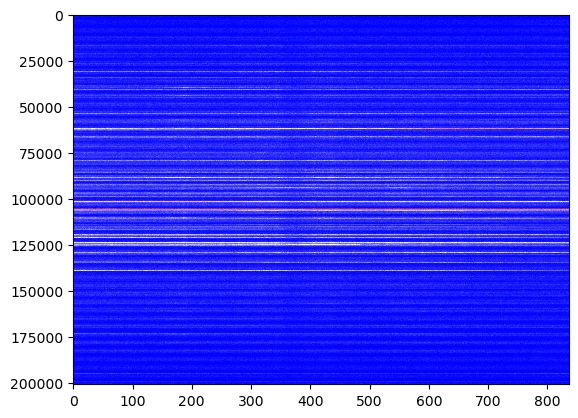

In [133]:
plt.imshow((mov.reshape(mov.shape[0],-1)).T, interpolation='nearest', aspect='auto',cmap='bwr')

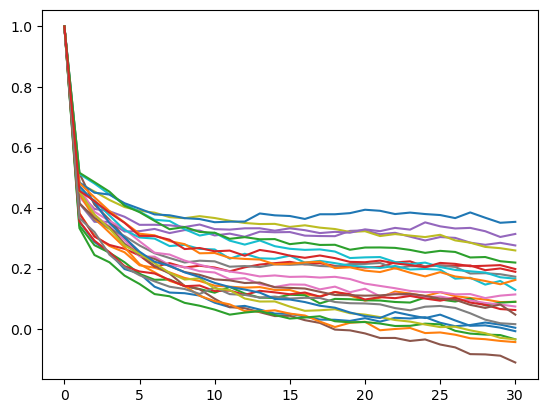

In [134]:
jump = 31
#for k in range(jump-2,jump*2,jump):
fit_range = np.array([0,1,2,3,4,5,6,7,8,9,12,13,14,15,16,17,18,19,20,21,22,23,24,25])
for k in list(jump+fit_range*jump):
    # Create histogram
    hist, bin_edges = np.histogram(((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))/(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)+0.4), bins=50)
    
    # Find the index of the bin with the highest frequency
    mode_index = np.argmax(hist)
    
    # Calculate the mode value
    mode_value = np.max([(bin_edges[mode_index] + bin_edges[mode_index + 1]) / 2,0.1])

    #mode_value = 1.5*mode_value
    
    plt.plot(np.mean(((mov.reshape(mov.shape[0],-1))[k:k+jump]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))[:,np.where((((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))/(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)+0.4))>mode_value)[0]]/((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))[np.where((((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))/(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)+0.4))>mode_value)[0]],1))

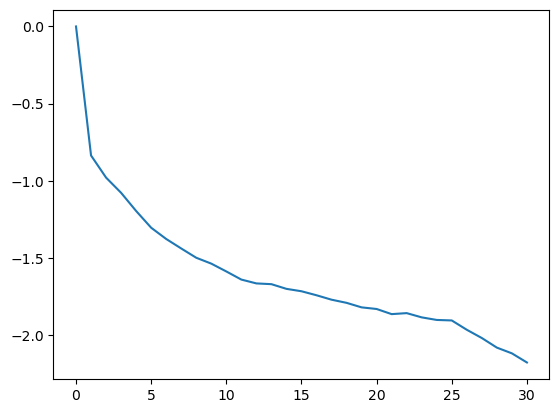

In [135]:
a = []
#jump = 3*mean_factor_slice_d[l]
#fit_range = fit_ranges_slice_d[l]
for k in list(jump+fit_range*jump):
    # Create histogram
    hist, bin_edges = np.histogram(((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))/(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)+0.4), bins=50)
    
    # Find the index of the bin with the highest frequency
    mode_index = np.argmax(hist)
    
    # Calculate the mode value
    mode_value = np.max([(bin_edges[mode_index] + bin_edges[mode_index + 1]) / 2,0.1])

    #mode_value = 1.5*mode_value
    
    a.append(np.mean(((mov.reshape(mov.shape[0],-1))[k:k+jump]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))[:,np.where((((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))/(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)+0.4))>mode_value)[0]]/((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))[np.where((((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))/(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)+0.4))>mode_value)[0]],1))
plt.plot(np.log(np.mean(np.array(a),0)))

[-0.83560884  0.        ]


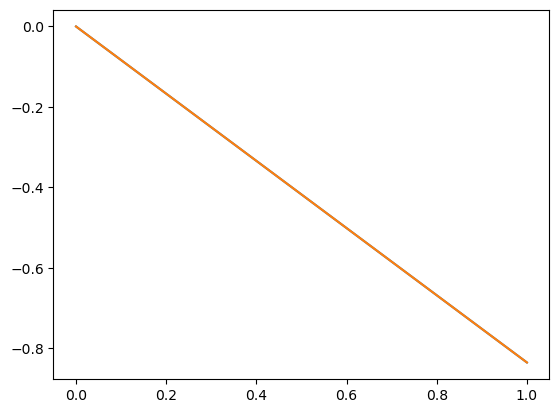

In [136]:
#a = []
#jump = 3*mean_factor_slice_d[l]
#fit_range = fit_ranges_slice_d[l]
#for k in list(jump-2+fit_range*jump):
#    a.append(np.mean(((cnmf_dicts_slice_d[l]['CY_m_raw'][np.argsort(cnmf_dicts_slice_d[l]['rises']),...].T)[k:k+jump]-(cnmf_dicts_slice_d[l]['CY_m_raw'][np.argsort(cnmf_dicts_slice_d[l]['rises']),...].T)[k])/((cnmf_dicts_slice_d[l]['CY_m_raw'][np.argsort(cnmf_dicts_slice_d[l]['rises']),...].T)[k+2]-np.mean((cnmf_dicts_slice_d[l]['CY_m_raw'][np.argsort(cnmf_dicts_slice_d[l]['rises']),...].T)[k-5:k],0)),1))
xa = np.arange(2)
ya = np.mean(np.array(a)[:,:2],0)
af = np.polyfit(xa, np.log(ya), 1)
print(af)
plt.plot(np.log(np.mean(np.array(a)[:,:2],0)))
plt.plot(af[0]*xa+af[1])

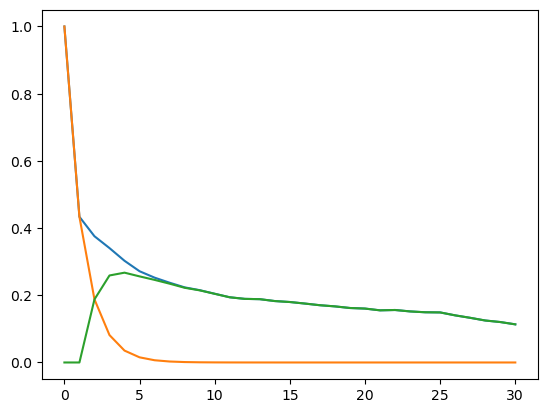

In [137]:
plt.plot(np.mean(np.array(a),0))
plt.plot(np.exp(af[0]*np.arange(31)+af[1]))
plt.plot(np.mean(np.array(a),0)-np.exp(af[0]*np.arange(31)+af[1]))

In [138]:
dfs = []
#jump = 3*mean_factor_slice_d[l]

for k in trange(jump,mov.reshape(mov.shape[0],-1).shape[0]-1,jump):
    # Create histogram
    #hist, bin_edges = np.histogram(((mov.reshape(mov.shape[0],-1))[k]-np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0))/(np.mean((mov.reshape(mov.shape[0],-1))[k-5:k],0)+0.4), bins=50)
    
    # Find the index of the bin with the highest frequency
    #mode_index = np.argmax(hist)
    
    # Calculate the mode value
    #mode_value = np.max([(bin_edges[mode_index] + bin_edges[mode_index + 1]) / 2,0.1])
        
    df = np.zeros(mov.reshape(mov.shape[0],-1).shape[1])
    df[np.where((mov.reshape(mov.shape[0],-1).T[:,k]-np.mean(mov.reshape(mov.shape[0],-1).T[:,k-5:k],1))>0)[0]] = (mov.reshape(mov.shape[0],-1).T[:,k]-np.mean(mov.reshape(mov.shape[0],-1).T[:,k-5:k],1))[np.where((mov.reshape(mov.shape[0],-1).T[:,k]-np.mean(mov.reshape(mov.shape[0],-1).T[:,k-5:k],1))>0)[0]]
    
    dfs.append(df)

mcb = np.zeros(mov.reshape(mov.shape[0],-1).T.shape)
for d in trange(np.array(dfs).shape[0]):
    #mcb[:,jump*(d+1):np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1,jump*(d+2)-1)] = mcb[:,jump*(d+1):np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1,jump*(d+2)-1)]+np.broadcast_to(np.exp(af[0]*np.arange(0,np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1-jump*(d+1),jump-1)))+np.exp(af2[0]*np.arange(0,np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1-jump*(d+1),jump-1))),(np.array(dfs).shape[1],) + (np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1-jump*(d+1),jump-1),))*np.array(dfs)[d,:][...,np.newaxis]
    mcb[:,jump*(d+1):np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1,jump*(d+2)-1)] = mcb[:,jump*(d+1):np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1,jump*(d+2)-1)]+np.broadcast_to(np.exp(af[0]*np.arange(0,np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1-jump*(d+1),jump-1))),(np.array(dfs).shape[1],) + (np.minimum(mov.reshape(mov.shape[0],-1).shape[0]-1-jump*(d+1),jump-1),))*np.array(dfs)[d,:][...,np.newaxis]

#cnmf_dicts_slice_d[l]['CY_m_raw_corr'] = cnmf_dicts_slice_d[l]['CY_m_raw']-cnmf_dicts_slice_d[l]['corrbase']

#cnmf_dicts_slice_d[l]['CY_m_raw_corr_sort'] = np.sort(cnmf_dicts_slice_d[l]['CY_m_raw_corr'],axis=1)
#cnmf_dicts_slice_d[l]['CY_m_raw_corr_b10'] = np.mean(cnmf_dicts_slice_d[l]['CY_m_raw_corr_sort'][:,:int(np.ceil(cnmf_dicts_slice_d[l]['CY_m_raw_corr_sort'].shape[1]/10))],axis=1) # bottom 10% mean
#cnmf_dicts_slice_d[l]['CY_m_raw_corr_t10'] = np.mean(cnmf_dicts_slice_d[l]['CY_m_raw_corr_sort'][:,-int(np.ceil(cnmf_dicts_slice_d[l]['CY_m_raw_corr_sort'].shape[1]/10)):],axis=1) # top 10% mean

#cnmf_dicts_slice_d[l]['CY_m_raw_corr_dff'] = ((cnmf_dicts_slice_d[l]['CY_m_raw_corr'].T-cnmf_dicts_slice_d[l]['CY_m_raw_corr_b10'])/(cnmf_dicts_slice_d[l]['CY_m_raw_corr_b10'])).T
#cnmf_dicts_slice_d[l]['CY_m_raw_corr_norm1'] = ((cnmf_dicts_slice_d[l]['CY_m_raw_corr'].T-cnmf_dicts_slice_d[l]['CY_m_raw_corr_b10'])/(cnmf_dicts_slice_d[l]['CY_m_raw_corr_t10']-cnmf_dicts_slice_d[l]['CY_m_raw_corr_b10'])).T

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

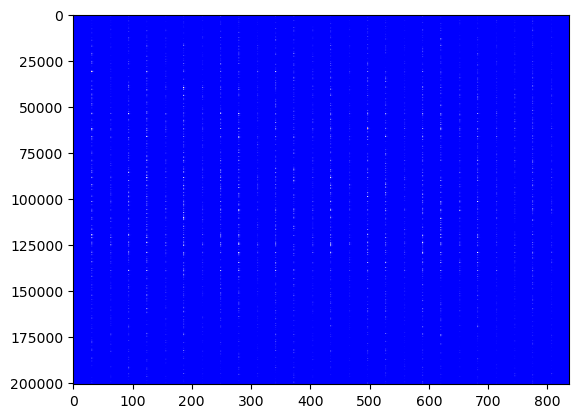

In [139]:
plt.imshow(mcb, interpolation='nearest', aspect='auto',cmap='bwr')

In [140]:
movc = mov-mcb.T.reshape(mov.shape)
movc.shape

(837, 415, 484)

In [141]:
for d in trange(np.array(dfs).shape[0]):
    movc[jump*(d+1),...] = np.mean([movc[jump*(d+1)-1,...],movc[jump*(d+1)+1,...]],axis=0)

  0%|          | 0/26 [00:00<?, ?it/s]

In [142]:
print(fname)
print(fname[:-4]+r'_corr.tif')

//nasquatch/data/2p/peter/dipping/20230916_PL48/PL48_230916_101_full_wch1_aniso4_scale4AFS2PL4_toref40_wxy_z6x_tds3.tif
//nasquatch/data/2p/peter/dipping/20230916_PL48/PL48_230916_101_full_wch1_aniso4_scale4AFS2PL4_toref40_wxy_z6x_tds3_corr.tif


In [143]:
tif_imwrite(fname[:-4]+r'_corr.tif',movc)

In [145]:
# NEW SV3 - original dff/cleaned up f (do dff in fiji to a single baseline frame)
fname = base_path + paths[0][:-4] + r'_z6x_tds3_corr.tif'
mov = tif_imread(fname)
mov.shape

(837, 415, 484)

In [146]:
mov.reshape(mov.shape[0],-1).shape

(837, 200860)

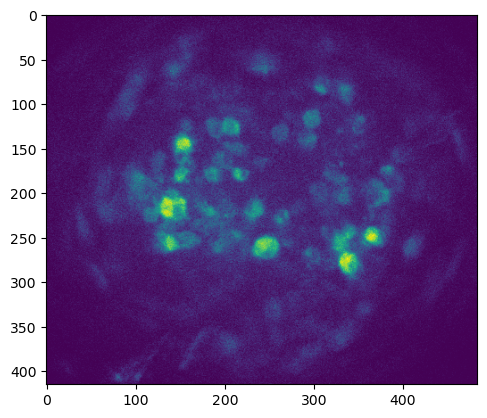

In [147]:
plt.imshow(mov[0,...])

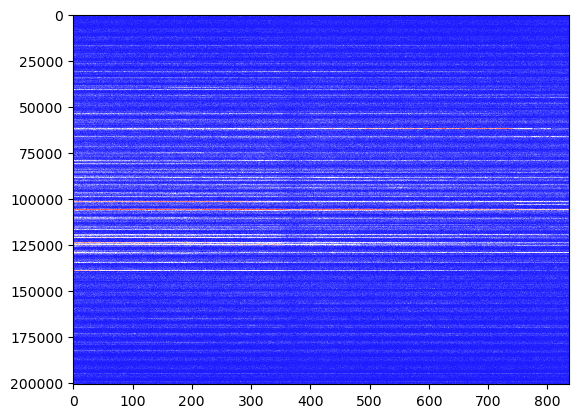

In [148]:
plt.imshow((mov.reshape(mov.shape[0],-1)).T, interpolation='nearest', aspect='auto',cmap='bwr')

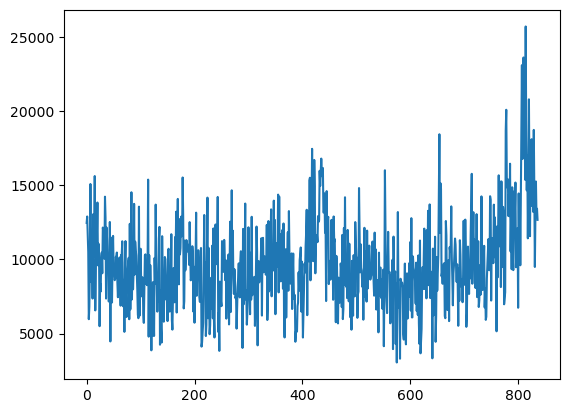

In [149]:
plt.plot((mov.reshape(mov.shape[0],-1))[:,66000])

In [153]:
C_sort = np.sort(sg.savgol_filter((mov.reshape(mov.shape[0],-1))[:,66000],31,1))
C_b10 = np.mean(C_sort[:int(np.ceil(C_sort.shape[0]/10))]) # bottom 10% mean
C_b10

7908.812514005079

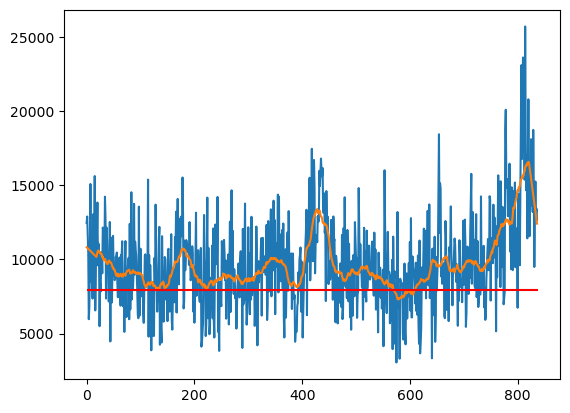

In [154]:
plt.plot((mov.reshape(mov.shape[0],-1))[:,66000])
plt.plot(sg.savgol_filter((mov.reshape(mov.shape[0],-1))[:,66000],31,1))
plt.hlines(y=C_b10,xmin=0,xmax=C_sort.shape[0],color='red')

In [155]:
%%time
pixo = (mov.reshape(mov.shape[0],-1)).T
pixomf = sg.savgol_filter(pixo,31,1,axis=1)

CPU times: total: 3.8 s
Wall time: 3.79 s


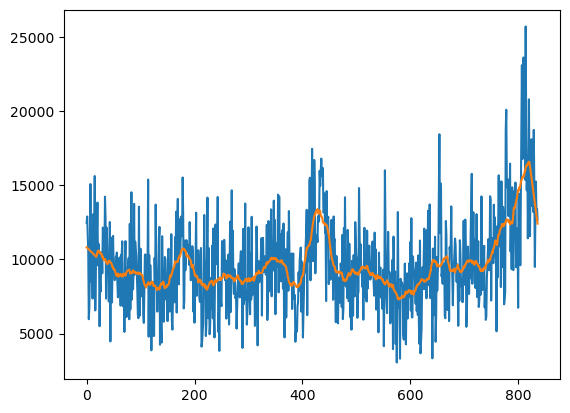

In [157]:
plt.plot(pixo[66000,...])
plt.plot(pixomf[66000,...])

CPU times: total: 8.41 s
Wall time: 8.41 s


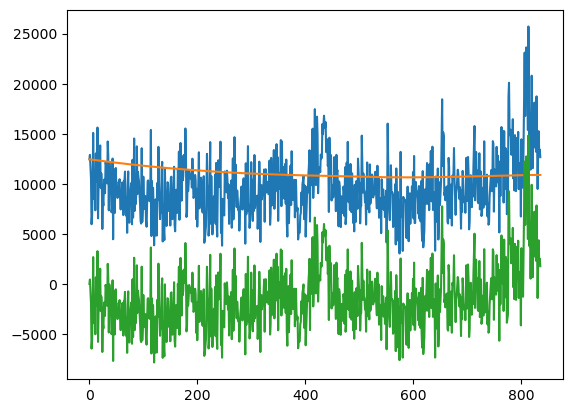

In [160]:
%%time
# bandpass pixels
sample_rate = 31/180
def lowpass(data: np.ndarray, cutoff: float, sample_rate: float, poles: int = 5):
    sos = sg.butter(poles, cutoff, 'lowpass', fs=sample_rate, output='sos')
    filtered_data = scipy.signal.sosfiltfilt(sos, data)
    return filtered_data
def highpass(data: np.ndarray, cutoff: float, sample_rate: float, poles: int = 5):
    sos = sg.butter(poles, cutoff, 'highpass', fs=sample_rate, output='sos')
    filtered_data = scipy.signal.sosfiltfilt(sos, data)
    return filtered_data
def bandpass(data: np.ndarray, cutoff, sample_rate: float, poles: int = 5):
    sos = sg.butter(poles, cutoff, 'bandpass', fs=sample_rate, output='sos')
    filtered_data = scipy.signal.sosfiltfilt(sos, data)
    return filtered_data

times = np.arange(pixo.shape[1])/sample_rate #[...,:936]

#filtered = lowpass(cnmf_dicts_invivo_ip[l]['CY_mov_matched_raw_corr_norm1'][hdbs_invivo.labels_==c,...][...,:2400], 1/600, sample_rate)
#filtered = cnmf_dicts_invivo_ip[l]['CY_mov_matched_raw_corr_norm1'][hdbs_invivo.labels_==c,...][...,:2400]-highpass(cnmf_dicts_invivo_ip[l]['CY_mov_matched_raw_corr_norm1'][hdbs_invivo.labels_==c,...][...,:2400], 1/600, sample_rate,1)
#filtered =  bandpass(CY_m_matched_raw_corr_norm1[...,:3000], [1/8000,1/50], sample_rate,1)
#filteredu = bandpass(pixomf_dff, [1/6000,1/50], sample_rate,1) #[np.argsort(hdbs_invivo.labels_),...]
filteredu = lowpass(pixo, 1/(3*pixo.shape[1]/sample_rate), sample_rate,1) #[np.argsort(hdbs_invivo.labels_),...]
#filtered2 = bandpass(CY_m2_matched_raw_gr_corr_norm1[...,:2000], [1/4000,1/50], sample_rate,1) #[np.argsort(hdbs_invivo.labels_),...]

#from matplotlib import colors
#divnorm=colors.TwoSlopeNorm(vcenter=0)
#filteredu_sort = np.sort(filteredu,axis=1)
#filteredu_b10 = np.mean(filteredu_sort[:,:int(np.ceil(filteredu_sort.shape[1]/10))],axis=1) #[[x for x in np.arange(21).tolist() if x not in oxt_rm],...]
#filteredu_t10 = np.mean(filteredu_sort[:,-int(np.ceil(filteredu_sort.shape[1]/10)):],axis=1)
#filteredu_norm1 = ((filteredu.T-filteredu_b10)/(filteredu_t10-filteredu_b10)).T
#plt.imshow(filteredu_norm1[np.argsort(cnmf_dicts_invivo_ip[l]['row_clusts_f']),...],interpolation='nearest',aspect='auto',cmap='bwr')#,vmax=1)
plt.plot(pixo[66000,...])
plt.plot(filteredu[66000,...])
plt.plot((pixo-filteredu)[66000,...])

#filtered2_sort = np.sort(filtered2,axis=1)
#filtered2_b10 = np.mean(filtered2_sort[:,:int(np.ceil(filtered2_sort.shape[1]/10))],axis=1) #[[x for x in np.arange(21).tolist() if x not in oxt_rm],...]
#filtered2_t10 = np.mean(filtered2_sort[:,-int(np.ceil(filtered2_sort.shape[1]/10)):],axis=1)
#filtered2_norm1 = ((filtered2.T-filtered2_b10)/(filtered2_t10-filtered2_b10)).T
#plt.imshow(filtered2_norm1[np.argsort(hdbs_slice_w.labels_),...],interpolation='nearest',aspect='auto',cmap='bwr',vmax=1)

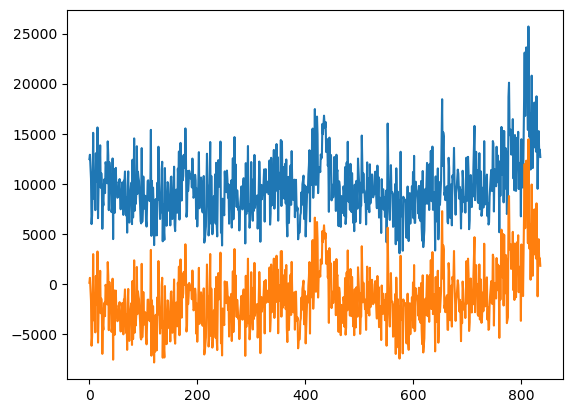

In [161]:
filteredu2 = bandpass((pixo-filteredu), [1/190,1/170], sample_rate,1) #[np.argsort(hdbs_invivo.labels_),...]

plt.plot(pixo[66000,...])
plt.plot((pixo-filteredu-filteredu2)[66000,...])

In [162]:
pixoc = pixo-filteredu-filteredu2
pixocmf = sg.savgol_filter(pixoc,31,1,axis=1)

pixomf_sort = np.sort(pixomf,axis=1)
pixocmf_sort = np.sort(pixocmf,axis=1)

pixomf_b10 = np.mean(pixomf_sort[:,:int(np.ceil(pixomf_sort.shape[1]/10))],axis=1) # bottom 10% mean
pixocmf_b10 = np.mean(pixocmf_sort[:,:int(np.ceil(pixocmf_sort.shape[1]/10))],axis=1) # bottom 10% mean

(array([135027.,  42252.,  12091.,   5242.,   2160.,   1485.,    977.,
           807.,    589.,    230.]),
 array([ 2547.41890185,  8589.12035125, 14630.82180066, 20672.52325006,
        26714.22469946, 32755.92614887, 38797.62759827, 44839.32904767,
        50881.03049708, 56922.73194648, 62964.43339588]),
 <BarContainer object of 10 artists>)

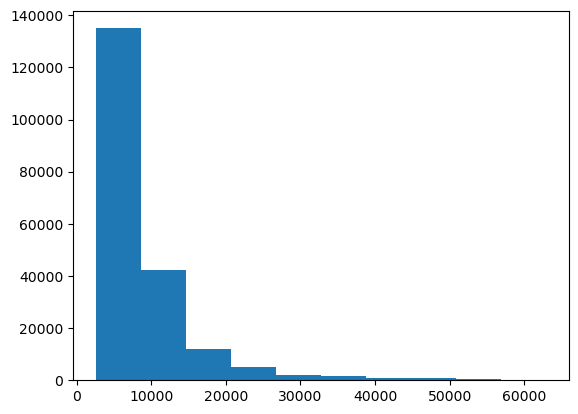

In [163]:
plt.hist(np.max(pixomf,axis=1))

(array([1.73396e+05, 2.20190e+04, 3.40400e+03, 9.99000e+02, 4.22000e+02,
        2.76000e+02, 1.54000e+02, 1.13000e+02, 4.90000e+01, 2.80000e+01]),
 array([ 2215.79014361,  7095.19174904, 11974.59335447, 16853.9949599 ,
        21733.39656533, 26612.79817075, 31492.19977618, 36371.60138161,
        41251.00298704, 46130.40459247, 51009.8061979 ]),
 <BarContainer object of 10 artists>)

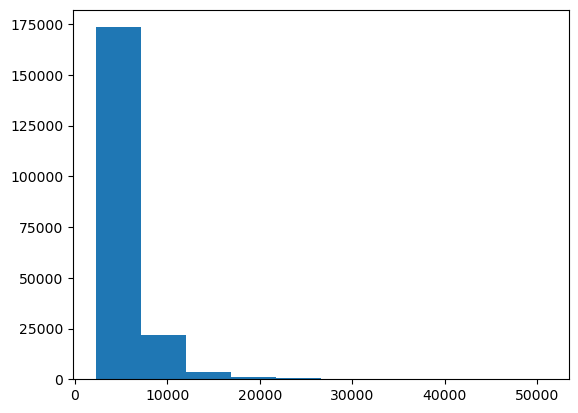

In [164]:
plt.hist(pixomf_b10)

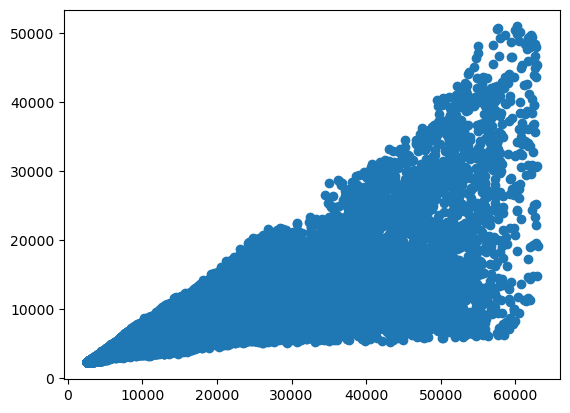

In [165]:
plt.scatter(np.max(pixomf,axis=1),pixomf_b10)

(array([7.4452e+04, 9.2546e+04, 2.1620e+04, 7.0840e+03, 2.8930e+03,
        1.1730e+03, 6.1800e+02, 2.7300e+02, 1.5300e+02, 4.8000e+01]),
 array([ 1221.69614464,  6131.84935777, 11042.00257089, 15952.15578402,
        20862.30899714, 25772.46221026, 30682.61542339, 35592.76863651,
        40502.92184964, 45413.07506276, 50323.22827589]),
 <BarContainer object of 10 artists>)

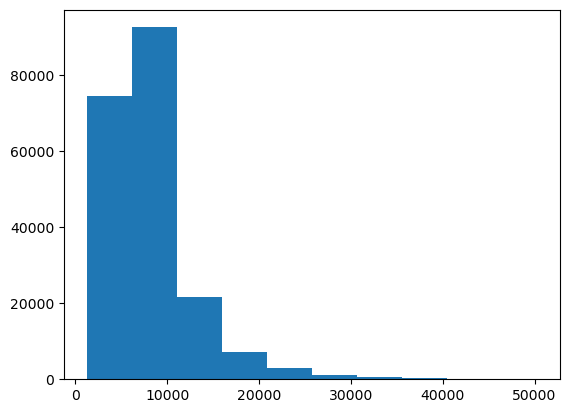

In [166]:
plt.hist(np.max((pixoc.T-pixocmf_b10),axis=0))

In [167]:
np.where(np.max((pixoc.T-pixocmf_b10),axis=0)<10000)[0].shape

(156348,)

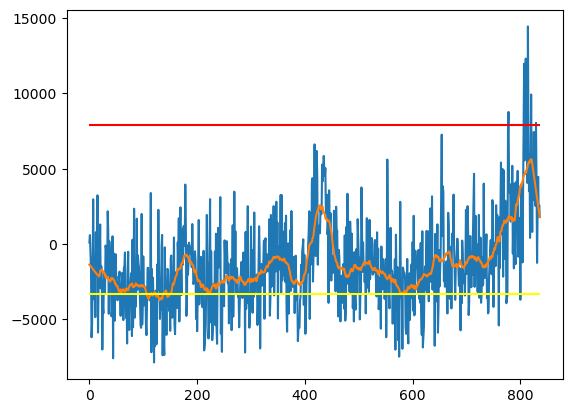

In [169]:
plt.plot(pixoc[66000,...])
plt.plot(pixocmf[66000,...])
plt.hlines(y=pixomf_b10[66000],xmin=0,xmax=pixoc.shape[1],color='red')
plt.hlines(y=pixocmf_b10[66000],xmin=0,xmax=pixoc.shape[1],color='yellow')

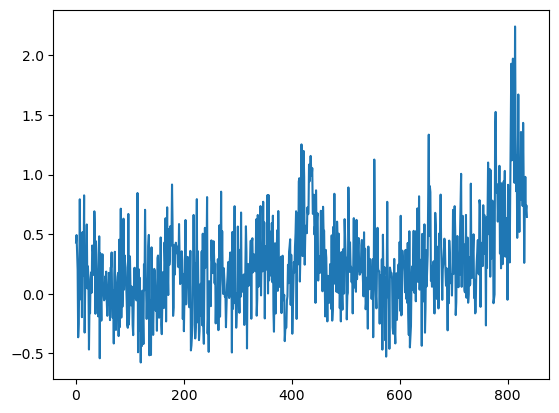

In [170]:
pixocdff = (pixoc.T-pixocmf_b10)/pixomf_b10
plt.plot(pixocdff[...,66000])

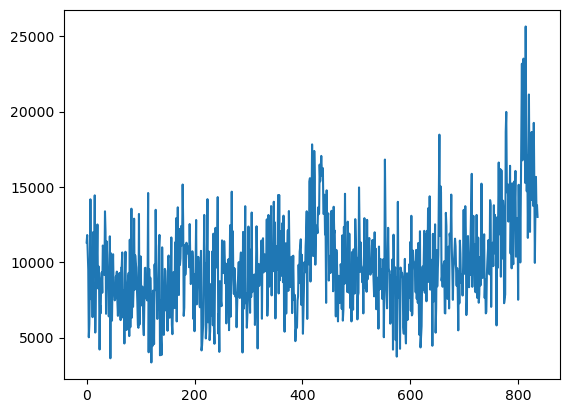

In [171]:
pixocf = (pixoc.T-pixocmf_b10)+pixomf_b10
plt.plot(pixocf[...,66000])

In [172]:
pixocdff.T.shape

(200860, 837)

In [173]:
movc = pixocdff.reshape(mov.shape)
movc.shape

(837, 415, 484)

In [176]:
pixocdff2 = deepcopy(pixocdff)
pixocdff2[...,np.where(np.max((pixoc.T-pixocmf_b10),axis=0)<5000)[0]] = np.zeros((pixocdff.shape[0],np.where(np.max((pixoc.T-pixocmf_b10),axis=0)<5000)[0].shape[0]))

In [177]:
movc2 = pixocdff2.reshape(mov.shape)
movc2.shape

(837, 415, 484)

In [178]:
movc3 = pixocf.reshape(mov.shape)
movc3.shape

(837, 415, 484)

In [179]:
print(fname)
print(fname[:-4]+r'_dff.tif')

//nasquatch/data/2p/peter/dipping/20230916_PL48/PL48_230916_101_full_z6x_tds3_corr.tif
//nasquatch/data/2p/peter/dipping/20230916_PL48/PL48_230916_101_full_z6x_tds3_corr_dff.tif


In [182]:
tif_imwrite(fname[:-4]+r'_dff.tif',movc)

In [183]:
tif_imwrite(fname[:-4]+r'_dff2.tif',movc2)

In [184]:
tif_imwrite(fname[:-4]+r'_f.tif',movc3)

In [185]:
# NEW SV3 - green warp dff/cleaned up f (do dff in fiji to a single baseline frame)
fname = base_path + paths2[0][:-4] + r'_z6x_tds3_corr.tif'
mov = tif_imread(fname)
mov.shape

(837, 415, 484)

In [186]:
mov.reshape(mov.shape[0],-1).shape

(837, 200860)

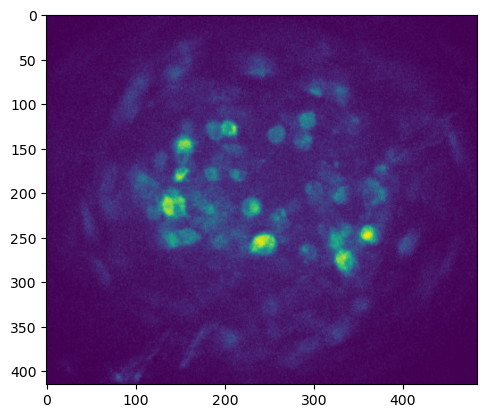

In [187]:
plt.imshow(mov[0,...])

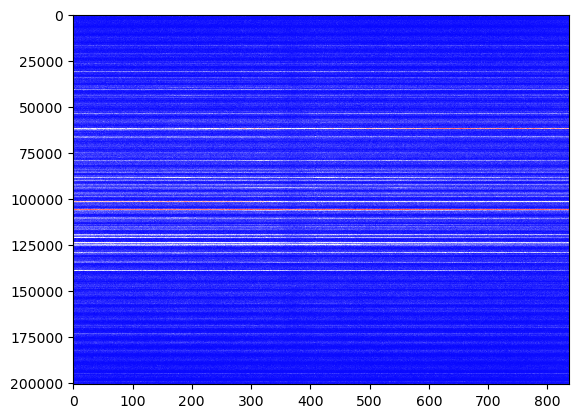

In [188]:
plt.imshow((mov.reshape(mov.shape[0],-1)).T, interpolation='nearest', aspect='auto',cmap='bwr')

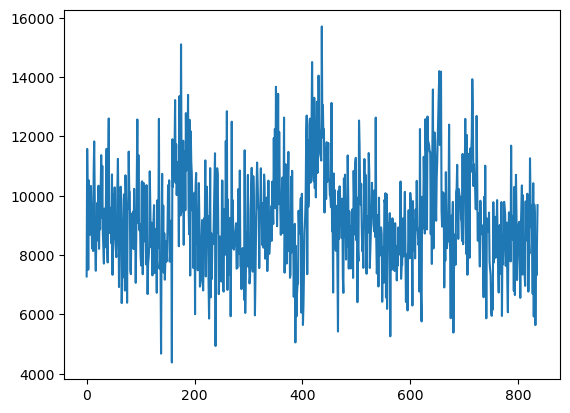

In [189]:
plt.plot((mov.reshape(mov.shape[0],-1))[:,66000])

In [190]:
C_sort = np.sort(sg.savgol_filter((mov.reshape(mov.shape[0],-1))[:,66000],31,1))
C_b10 = np.mean(C_sort[:int(np.ceil(C_sort.shape[0]/10))]) # bottom 10% mean
C_b10

8233.672320146636

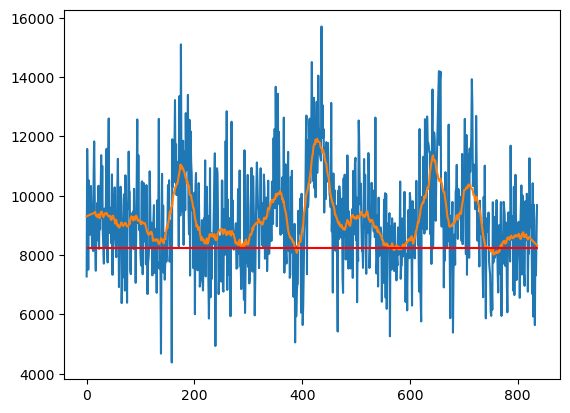

In [191]:
plt.plot((mov.reshape(mov.shape[0],-1))[:,66000])
plt.plot(sg.savgol_filter((mov.reshape(mov.shape[0],-1))[:,66000],31,1))
plt.hlines(y=C_b10,xmin=0,xmax=C_sort.shape[0],color='red')

In [192]:
%%time
pixo = (mov.reshape(mov.shape[0],-1)).T
pixomf = sg.savgol_filter(pixo,31,1,axis=1)

CPU times: total: 4 s
Wall time: 4.01 s


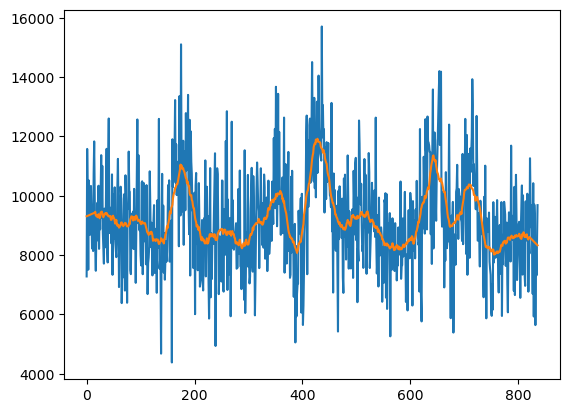

In [193]:
plt.plot(pixo[66000,...])
plt.plot(pixomf[66000,...])

CPU times: total: 6.66 s
Wall time: 6.66 s


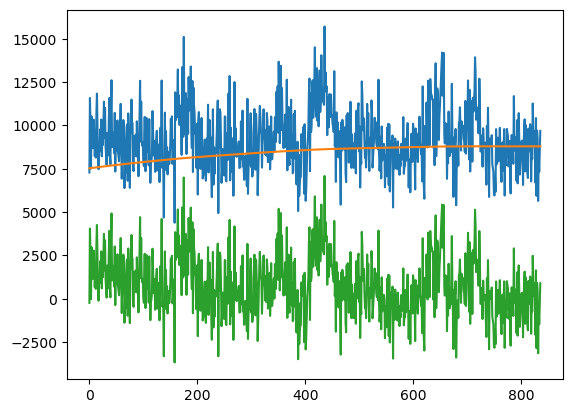

In [194]:
%%time
# bandpass pixels
sample_rate = 31/180
def lowpass(data: np.ndarray, cutoff: float, sample_rate: float, poles: int = 5):
    sos = sg.butter(poles, cutoff, 'lowpass', fs=sample_rate, output='sos')
    filtered_data = scipy.signal.sosfiltfilt(sos, data)
    return filtered_data
def highpass(data: np.ndarray, cutoff: float, sample_rate: float, poles: int = 5):
    sos = sg.butter(poles, cutoff, 'highpass', fs=sample_rate, output='sos')
    filtered_data = scipy.signal.sosfiltfilt(sos, data)
    return filtered_data
def bandpass(data: np.ndarray, cutoff, sample_rate: float, poles: int = 5):
    sos = sg.butter(poles, cutoff, 'bandpass', fs=sample_rate, output='sos')
    filtered_data = scipy.signal.sosfiltfilt(sos, data)
    return filtered_data

times = np.arange(pixo.shape[1])/sample_rate #[...,:936]

#filtered = lowpass(cnmf_dicts_invivo_ip[l]['CY_mov_matched_raw_corr_norm1'][hdbs_invivo.labels_==c,...][...,:2400], 1/600, sample_rate)
#filtered = cnmf_dicts_invivo_ip[l]['CY_mov_matched_raw_corr_norm1'][hdbs_invivo.labels_==c,...][...,:2400]-highpass(cnmf_dicts_invivo_ip[l]['CY_mov_matched_raw_corr_norm1'][hdbs_invivo.labels_==c,...][...,:2400], 1/600, sample_rate,1)
#filtered =  bandpass(CY_m_matched_raw_corr_norm1[...,:3000], [1/8000,1/50], sample_rate,1)
#filteredu = bandpass(pixomf_dff, [1/6000,1/50], sample_rate,1) #[np.argsort(hdbs_invivo.labels_),...]
filteredu = lowpass(pixo, 1/(3*pixo.shape[1]/sample_rate), sample_rate,1) #[np.argsort(hdbs_invivo.labels_),...]
#filtered2 = bandpass(CY_m2_matched_raw_gr_corr_norm1[...,:2000], [1/4000,1/50], sample_rate,1) #[np.argsort(hdbs_invivo.labels_),...]

#from matplotlib import colors
#divnorm=colors.TwoSlopeNorm(vcenter=0)
#filteredu_sort = np.sort(filteredu,axis=1)
#filteredu_b10 = np.mean(filteredu_sort[:,:int(np.ceil(filteredu_sort.shape[1]/10))],axis=1) #[[x for x in np.arange(21).tolist() if x not in oxt_rm],...]
#filteredu_t10 = np.mean(filteredu_sort[:,-int(np.ceil(filteredu_sort.shape[1]/10)):],axis=1)
#filteredu_norm1 = ((filteredu.T-filteredu_b10)/(filteredu_t10-filteredu_b10)).T
#plt.imshow(filteredu_norm1[np.argsort(cnmf_dicts_invivo_ip[l]['row_clusts_f']),...],interpolation='nearest',aspect='auto',cmap='bwr')#,vmax=1)
plt.plot(pixo[66000,...])
plt.plot(filteredu[66000,...])
plt.plot((pixo-filteredu)[66000,...])

#filtered2_sort = np.sort(filtered2,axis=1)
#filtered2_b10 = np.mean(filtered2_sort[:,:int(np.ceil(filtered2_sort.shape[1]/10))],axis=1) #[[x for x in np.arange(21).tolist() if x not in oxt_rm],...]
#filtered2_t10 = np.mean(filtered2_sort[:,-int(np.ceil(filtered2_sort.shape[1]/10)):],axis=1)
#filtered2_norm1 = ((filtered2.T-filtered2_b10)/(filtered2_t10-filtered2_b10)).T
#plt.imshow(filtered2_norm1[np.argsort(hdbs_slice_w.labels_),...],interpolation='nearest',aspect='auto',cmap='bwr',vmax=1)

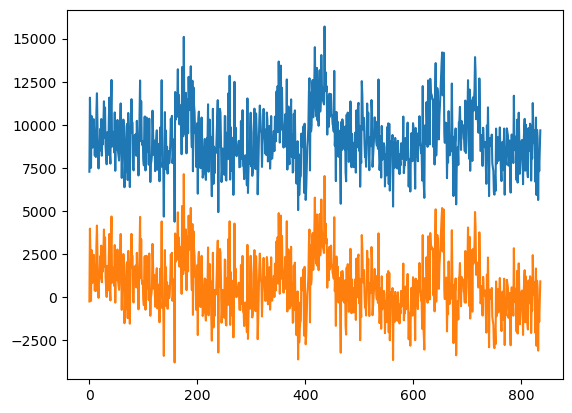

In [195]:
filteredu2 = bandpass((pixo-filteredu), [1/190,1/170], sample_rate,1) #[np.argsort(hdbs_invivo.labels_),...]

plt.plot(pixo[66000,...])
plt.plot((pixo-filteredu-filteredu2)[66000,...])

In [196]:
pixoc = pixo-filteredu-filteredu2
pixocmf = sg.savgol_filter(pixoc,31,1,axis=1)

pixomf_sort = np.sort(pixomf,axis=1)
pixocmf_sort = np.sort(pixocmf,axis=1)

pixomf_b10 = np.mean(pixomf_sort[:,:int(np.ceil(pixomf_sort.shape[1]/10))],axis=1) # bottom 10% mean
pixocmf_b10 = np.mean(pixocmf_sort[:,:int(np.ceil(pixocmf_sort.shape[1]/10))],axis=1) # bottom 10% mean

(array([150415.,  33769.,   8881.,   3495.,   1519.,    925.,    735.,
           661.,    297.,    163.]),
 array([ 2550.5005955 ,  8565.03320698, 14579.56581846, 20594.09842993,
        26608.63104141, 32623.16365289, 38637.69626437, 44652.22887584,
        50666.76148732, 56681.2940988 , 62695.82671028]),
 <BarContainer object of 10 artists>)

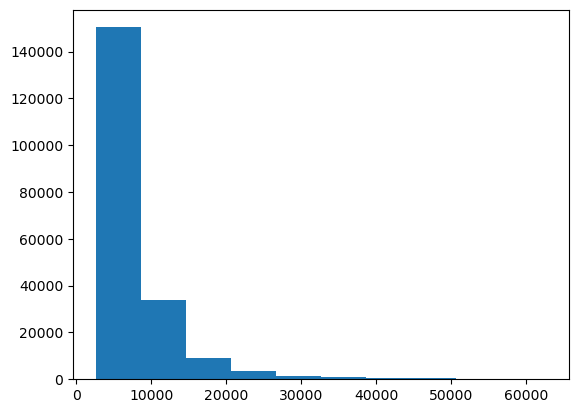

In [197]:
plt.hist(np.max(pixomf,axis=1))

(array([1.69739e+05, 2.29740e+04, 4.65000e+03, 1.52100e+03, 7.30000e+02,
        5.44000e+02, 2.74000e+02, 2.09000e+02, 1.47000e+02, 7.20000e+01]),
 array([ 2239.51529817,  7707.87873794, 13176.24217771, 18644.60561749,
        24112.96905726, 29581.33249703, 35049.6959368 , 40518.05937658,
        45986.42281635, 51454.78625612, 56923.1496959 ]),
 <BarContainer object of 10 artists>)

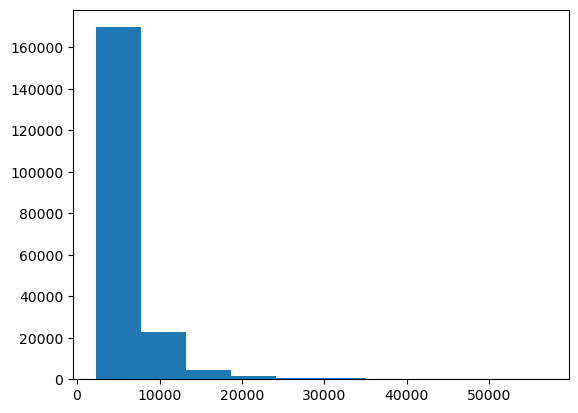

In [198]:
plt.hist(pixomf_b10)

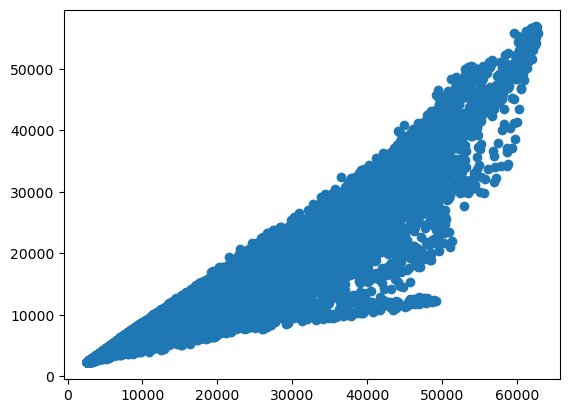

In [199]:
plt.scatter(np.max(pixomf,axis=1),pixomf_b10)

(array([8.9003e+04, 8.7701e+04, 1.6544e+04, 4.9780e+03, 1.8620e+03,
        5.4100e+02, 1.4200e+02, 3.0000e+01, 3.5000e+01, 2.4000e+01]),
 array([  646.10317164,  4034.35018179,  7422.59719195, 10810.84420211,
        14199.09121227, 17587.33822243, 20975.58523258, 24363.83224274,
        27752.0792529 , 31140.32626306, 34528.57327322]),
 <BarContainer object of 10 artists>)

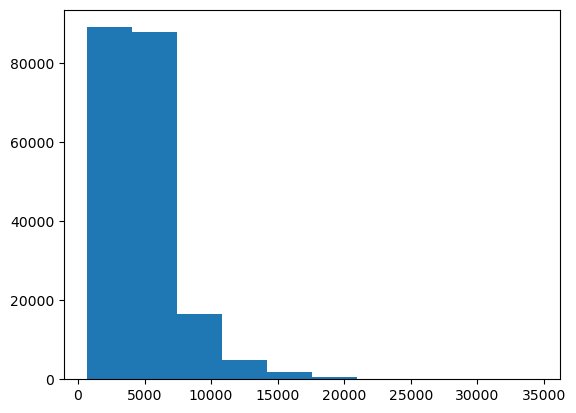

In [200]:
plt.hist(np.max((pixoc.T-pixocmf_b10),axis=0))

In [201]:
np.where(np.max((pixoc.T-pixocmf_b10),axis=0)<10000)[0].shape

(191046,)

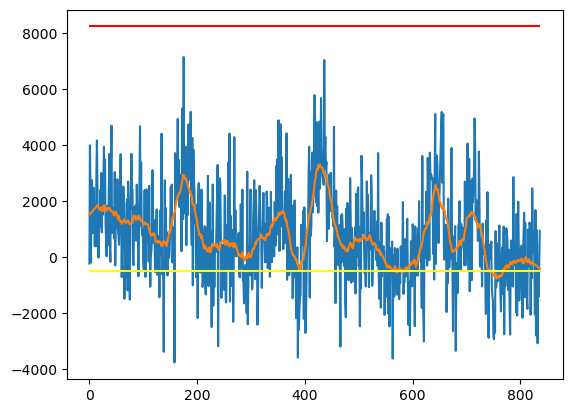

In [202]:
plt.plot(pixoc[66000,...])
plt.plot(pixocmf[66000,...])
plt.hlines(y=pixomf_b10[66000],xmin=0,xmax=pixoc.shape[1],color='red')
plt.hlines(y=pixocmf_b10[66000],xmin=0,xmax=pixoc.shape[1],color='yellow')

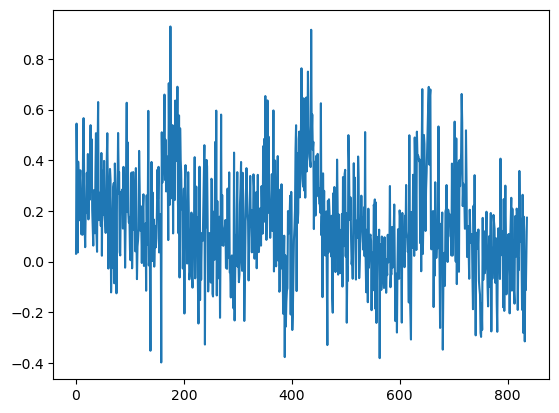

In [203]:
pixocdff = (pixoc.T-pixocmf_b10)/pixomf_b10
plt.plot(pixocdff[...,66000])

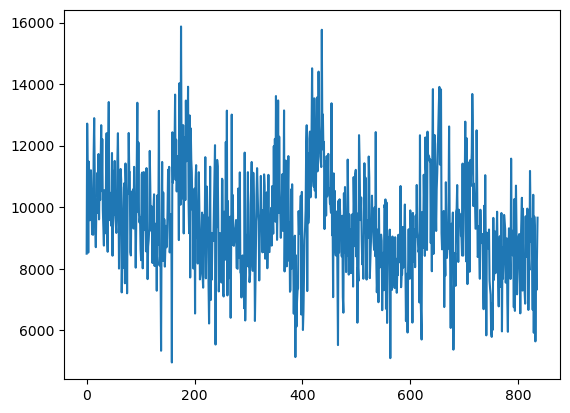

In [204]:
pixocf = (pixoc.T-pixocmf_b10)+pixomf_b10
plt.plot(pixocf[...,66000])

In [205]:
pixocdff.T.shape

(200860, 837)

In [206]:
movc = pixocdff.reshape(mov.shape)
movc.shape

(837, 415, 484)

In [207]:
pixocdff2 = deepcopy(pixocdff)
pixocdff2[...,np.where(np.max((pixoc.T-pixocmf_b10),axis=0)<5000)[0]] = np.zeros((pixocdff.shape[0],np.where(np.max((pixoc.T-pixocmf_b10),axis=0)<5000)[0].shape[0]))

In [208]:
movc2 = pixocdff2.reshape(mov.shape)
movc2.shape

(837, 415, 484)

In [209]:
movc3 = pixocf.reshape(mov.shape)
movc3.shape

(837, 415, 484)

In [210]:
print(fname)
print(fname[:-4]+r'_dff.tif')

//nasquatch/data/2p/peter/dipping/20230916_PL48/PL48_230916_101_full_wch0_aniso4_scale4AFS2PL4_toref40_wxy_z6x_tds3_corr.tif
//nasquatch/data/2p/peter/dipping/20230916_PL48/PL48_230916_101_full_wch0_aniso4_scale4AFS2PL4_toref40_wxy_z6x_tds3_corr_dff.tif


In [211]:
tif_imwrite(fname[:-4]+r'_dff.tif',movc)

In [212]:
tif_imwrite(fname[:-4]+r'_dff2.tif',movc2)

In [213]:
tif_imwrite(fname[:-4]+r'_f.tif',movc3)

In [214]:
# NEW SV3 - red warp dff/cleaned up f (do dff in fiji to a single baseline frame)
fname = base_path + paths2[1][:-4] + r'_z6x_tds3_corr.tif'
mov = tif_imread(fname)
mov.shape

(837, 415, 484)

In [215]:
mov.reshape(mov.shape[0],-1).shape

(837, 200860)

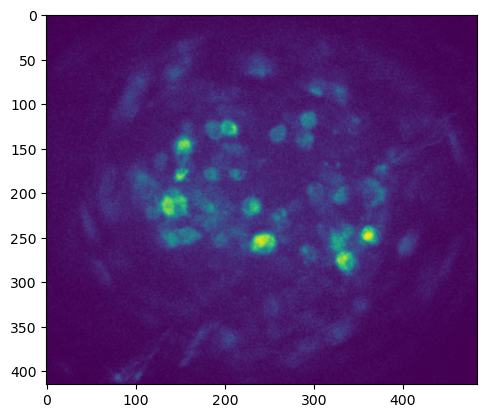

In [216]:
plt.imshow(mov[0,...])

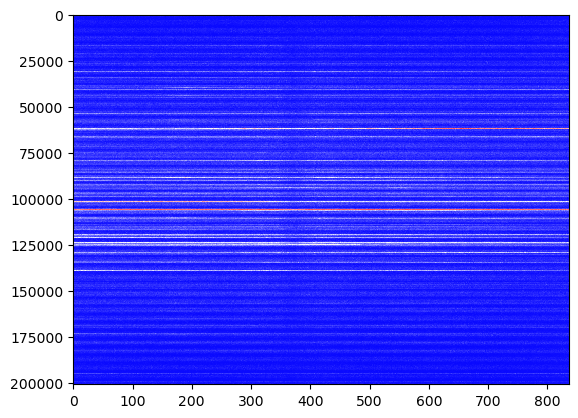

In [217]:
plt.imshow((mov.reshape(mov.shape[0],-1)).T, interpolation='nearest', aspect='auto',cmap='bwr')

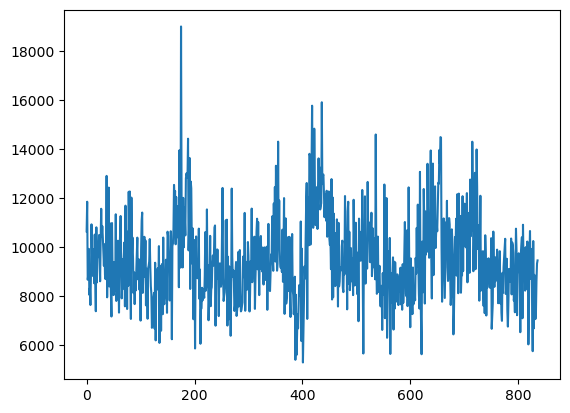

In [218]:
plt.plot((mov.reshape(mov.shape[0],-1))[:,66000])

In [219]:
C_sort = np.sort(sg.savgol_filter((mov.reshape(mov.shape[0],-1))[:,66000],31,1))
C_b10 = np.mean(C_sort[:int(np.ceil(C_sort.shape[0]/10))]) # bottom 10% mean
C_b10

8401.724397868455

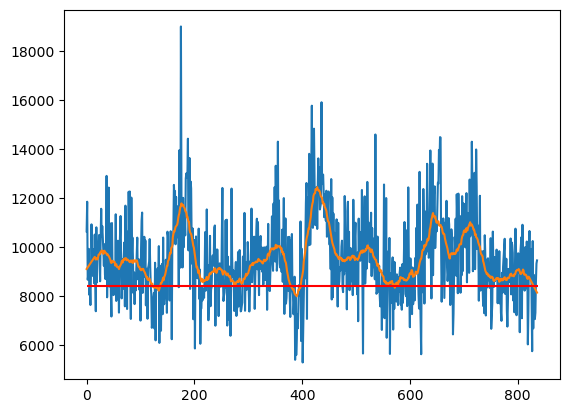

In [220]:
plt.plot((mov.reshape(mov.shape[0],-1))[:,66000])
plt.plot(sg.savgol_filter((mov.reshape(mov.shape[0],-1))[:,66000],31,1))
plt.hlines(y=C_b10,xmin=0,xmax=C_sort.shape[0],color='red')

In [221]:
%%time
pixo = (mov.reshape(mov.shape[0],-1)).T
pixomf = sg.savgol_filter(pixo,31,1,axis=1)

CPU times: total: 4 s
Wall time: 4 s


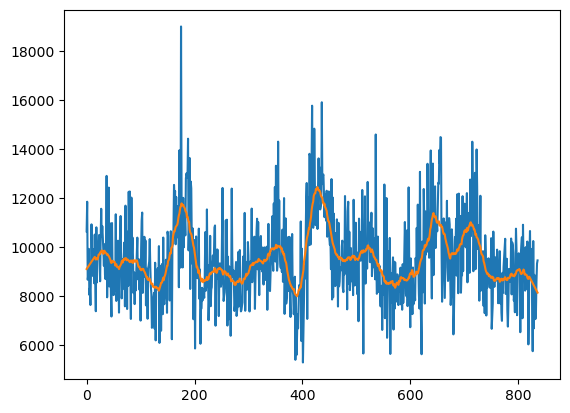

In [222]:
plt.plot(pixo[66000,...])
plt.plot(pixomf[66000,...])

CPU times: total: 6.75 s
Wall time: 6.75 s


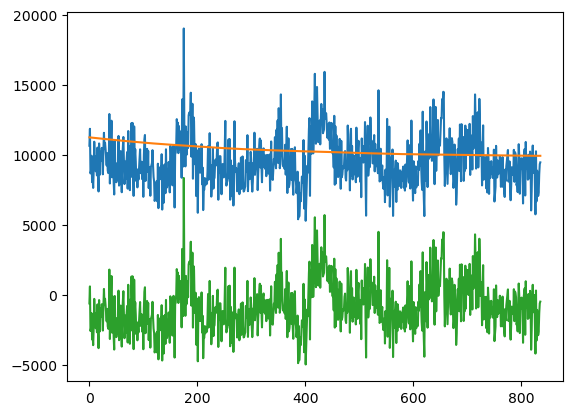

In [223]:
%%time
# bandpass pixels
sample_rate = 31/180
def lowpass(data: np.ndarray, cutoff: float, sample_rate: float, poles: int = 5):
    sos = sg.butter(poles, cutoff, 'lowpass', fs=sample_rate, output='sos')
    filtered_data = scipy.signal.sosfiltfilt(sos, data)
    return filtered_data
def highpass(data: np.ndarray, cutoff: float, sample_rate: float, poles: int = 5):
    sos = sg.butter(poles, cutoff, 'highpass', fs=sample_rate, output='sos')
    filtered_data = scipy.signal.sosfiltfilt(sos, data)
    return filtered_data
def bandpass(data: np.ndarray, cutoff, sample_rate: float, poles: int = 5):
    sos = sg.butter(poles, cutoff, 'bandpass', fs=sample_rate, output='sos')
    filtered_data = scipy.signal.sosfiltfilt(sos, data)
    return filtered_data

times = np.arange(pixo.shape[1])/sample_rate #[...,:936]

#filtered = lowpass(cnmf_dicts_invivo_ip[l]['CY_mov_matched_raw_corr_norm1'][hdbs_invivo.labels_==c,...][...,:2400], 1/600, sample_rate)
#filtered = cnmf_dicts_invivo_ip[l]['CY_mov_matched_raw_corr_norm1'][hdbs_invivo.labels_==c,...][...,:2400]-highpass(cnmf_dicts_invivo_ip[l]['CY_mov_matched_raw_corr_norm1'][hdbs_invivo.labels_==c,...][...,:2400], 1/600, sample_rate,1)
#filtered =  bandpass(CY_m_matched_raw_corr_norm1[...,:3000], [1/8000,1/50], sample_rate,1)
#filteredu = bandpass(pixomf_dff, [1/6000,1/50], sample_rate,1) #[np.argsort(hdbs_invivo.labels_),...]
filteredu = lowpass(pixo, 1/(3*pixo.shape[1]/sample_rate), sample_rate,1) #[np.argsort(hdbs_invivo.labels_),...]
#filtered2 = bandpass(CY_m2_matched_raw_gr_corr_norm1[...,:2000], [1/4000,1/50], sample_rate,1) #[np.argsort(hdbs_invivo.labels_),...]

#from matplotlib import colors
#divnorm=colors.TwoSlopeNorm(vcenter=0)
#filteredu_sort = np.sort(filteredu,axis=1)
#filteredu_b10 = np.mean(filteredu_sort[:,:int(np.ceil(filteredu_sort.shape[1]/10))],axis=1) #[[x for x in np.arange(21).tolist() if x not in oxt_rm],...]
#filteredu_t10 = np.mean(filteredu_sort[:,-int(np.ceil(filteredu_sort.shape[1]/10)):],axis=1)
#filteredu_norm1 = ((filteredu.T-filteredu_b10)/(filteredu_t10-filteredu_b10)).T
#plt.imshow(filteredu_norm1[np.argsort(cnmf_dicts_invivo_ip[l]['row_clusts_f']),...],interpolation='nearest',aspect='auto',cmap='bwr')#,vmax=1)
plt.plot(pixo[66000,...])
plt.plot(filteredu[66000,...])
plt.plot((pixo-filteredu)[66000,...])

#filtered2_sort = np.sort(filtered2,axis=1)
#filtered2_b10 = np.mean(filtered2_sort[:,:int(np.ceil(filtered2_sort.shape[1]/10))],axis=1) #[[x for x in np.arange(21).tolist() if x not in oxt_rm],...]
#filtered2_t10 = np.mean(filtered2_sort[:,-int(np.ceil(filtered2_sort.shape[1]/10)):],axis=1)
#filtered2_norm1 = ((filtered2.T-filtered2_b10)/(filtered2_t10-filtered2_b10)).T
#plt.imshow(filtered2_norm1[np.argsort(hdbs_slice_w.labels_),...],interpolation='nearest',aspect='auto',cmap='bwr',vmax=1)

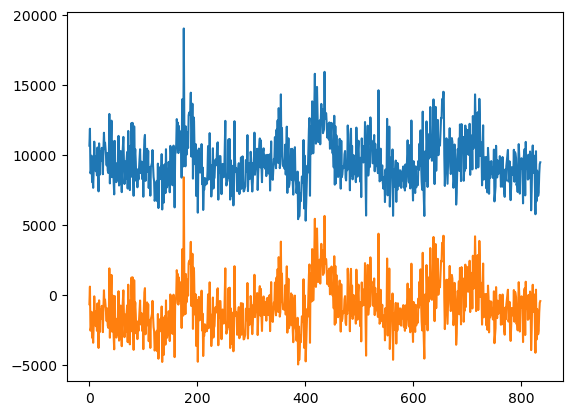

In [224]:
filteredu2 = bandpass((pixo-filteredu), [1/190,1/170], sample_rate,1) #[np.argsort(hdbs_invivo.labels_),...]

plt.plot(pixo[66000,...])
plt.plot((pixo-filteredu-filteredu2)[66000,...])

In [225]:
pixoc = pixo-filteredu-filteredu2
pixocmf = sg.savgol_filter(pixoc,31,1,axis=1)

pixomf_sort = np.sort(pixomf,axis=1)
pixocmf_sort = np.sort(pixocmf,axis=1)

pixomf_b10 = np.mean(pixomf_sort[:,:int(np.ceil(pixomf_sort.shape[1]/10))],axis=1) # bottom 10% mean
pixocmf_b10 = np.mean(pixocmf_sort[:,:int(np.ceil(pixocmf_sort.shape[1]/10))],axis=1) # bottom 10% mean

(array([149316.,  34223.,   9353.,   3638.,   1568.,    951.,    724.,
           629.,    298.,    160.]),
 array([ 2544.67065183,  8567.76764389, 14590.86463594, 20613.961628  ,
        26637.05862006, 32660.15561212, 38683.25260418, 44706.34959623,
        50729.44658829, 56752.54358035, 62775.64057241]),
 <BarContainer object of 10 artists>)

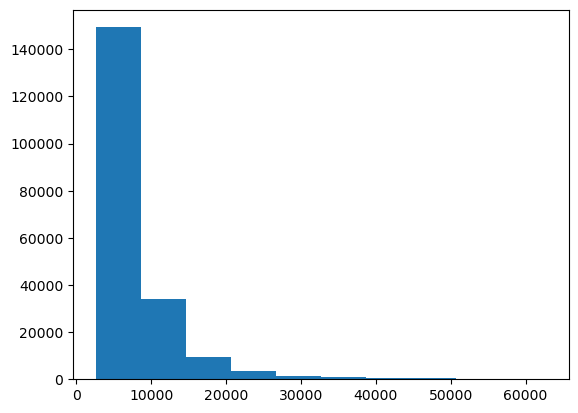

In [226]:
plt.hist(np.max(pixomf,axis=1))

(array([1.70266e+05, 2.26320e+04, 4.64500e+03, 1.46000e+03, 6.98000e+02,
        4.86000e+02, 2.41000e+02, 2.12000e+02, 1.39000e+02, 8.10000e+01]),
 array([ 2238.55397512,  7654.27415865, 13069.99434218, 18485.71452572,
        23901.43470925, 29317.15489278, 34732.87507631, 40148.59525984,
        45564.31544338, 50980.03562691, 56395.75581044]),
 <BarContainer object of 10 artists>)

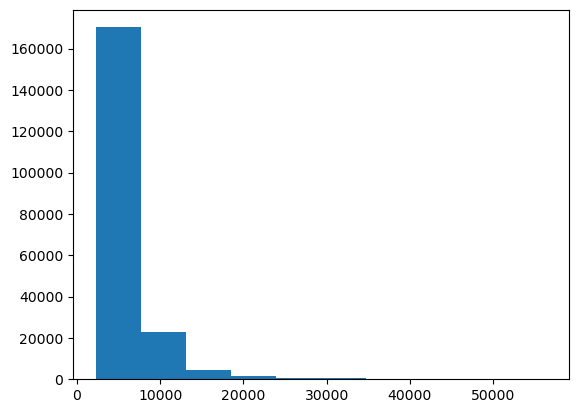

In [227]:
plt.hist(pixomf_b10)

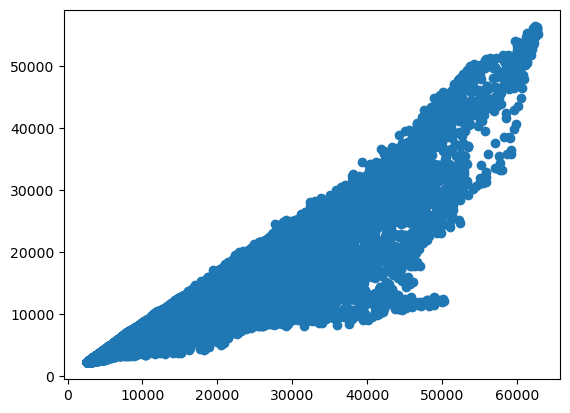

In [228]:
plt.scatter(np.max(pixomf,axis=1),pixomf_b10)

(array([9.8512e+04, 7.9802e+04, 1.5152e+04, 4.8610e+03, 1.6760e+03,
        5.6600e+02, 1.8800e+02, 4.0000e+01, 4.0000e+01, 2.3000e+01]),
 array([  688.20305678,  4226.87061694,  7765.5381771 , 11304.20573726,
        14842.87329742, 18381.54085757, 21920.20841773, 25458.87597789,
        28997.54353805, 32536.21109821, 36074.87865836]),
 <BarContainer object of 10 artists>)

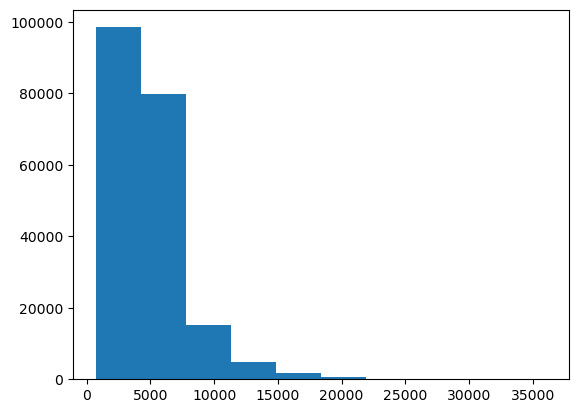

In [229]:
plt.hist(np.max((pixoc.T-pixocmf_b10),axis=0))

In [230]:
np.where(np.max((pixoc.T-pixocmf_b10),axis=0)<10000)[0].shape

(189891,)

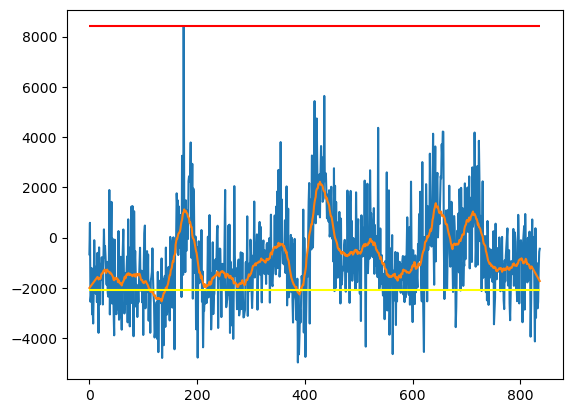

In [231]:
plt.plot(pixoc[66000,...])
plt.plot(pixocmf[66000,...])
plt.hlines(y=pixomf_b10[66000],xmin=0,xmax=pixoc.shape[1],color='red')
plt.hlines(y=pixocmf_b10[66000],xmin=0,xmax=pixoc.shape[1],color='yellow')

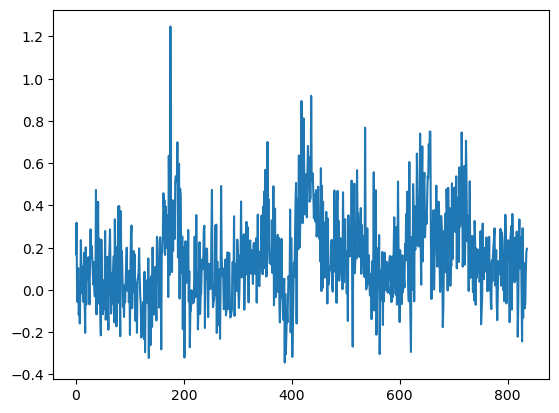

In [232]:
pixocdff = (pixoc.T-pixocmf_b10)/pixomf_b10
plt.plot(pixocdff[...,66000])

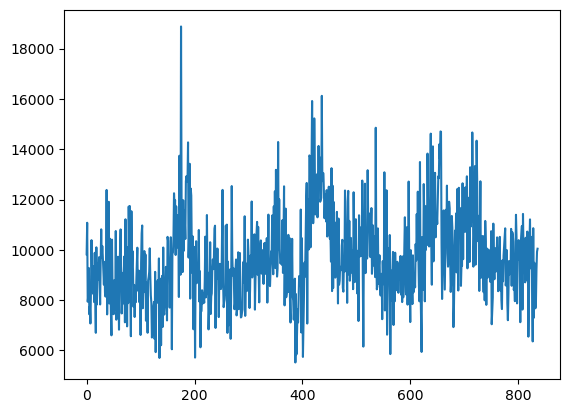

In [233]:
pixocf = (pixoc.T-pixocmf_b10)+pixomf_b10
plt.plot(pixocf[...,66000])

In [234]:
pixocdff.T.shape

(200860, 837)

In [235]:
movc = pixocdff.reshape(mov.shape)
movc.shape

(837, 415, 484)

In [236]:
pixocdff2 = deepcopy(pixocdff)
pixocdff2[...,np.where(np.max((pixoc.T-pixocmf_b10),axis=0)<5000)[0]] = np.zeros((pixocdff.shape[0],np.where(np.max((pixoc.T-pixocmf_b10),axis=0)<5000)[0].shape[0]))

In [237]:
movc2 = pixocdff2.reshape(mov.shape)
movc2.shape

(837, 415, 484)

In [238]:
movc3 = pixocf.reshape(mov.shape)
movc3.shape

(837, 415, 484)

In [239]:
print(fname)
print(fname[:-4]+r'_dff.tif')

//nasquatch/data/2p/peter/dipping/20230916_PL48/PL48_230916_101_full_wch1_aniso4_scale4AFS2PL4_toref40_wxy_z6x_tds3_corr.tif
//nasquatch/data/2p/peter/dipping/20230916_PL48/PL48_230916_101_full_wch1_aniso4_scale4AFS2PL4_toref40_wxy_z6x_tds3_corr_dff.tif


In [240]:
tif_imwrite(fname[:-4]+r'_dff.tif',movc)

In [241]:
tif_imwrite(fname[:-4]+r'_dff2.tif',movc2)

In [242]:
tif_imwrite(fname[:-4]+r'_f.tif',movc3)